### <left> High-Dimensional Deep Learning - 5A
## <center>*Mini-project n° 3 – SSL for Anomaly Detection*</center>
### <center>2024-2025</center>
<div style="text-align: right;">
    <b>Project 3/4</b><br>
<div style="text-align: left;">
<b>Noms :</b> Maïmouna Gadji, Phuc-Luan Nguyen, Maddie Perez et Julia Soufflet<br>

# Objectif : 

L'objectif final de ce projet est d'entrainer au moins trois modèles sur quatre jeux de données extraits de MVTec_AD (*bottle, hazelnut, capsule* et *toothbrush*), et un jeu de données extrait de Auto_VI (*engine_wiring*), afin d'obtenir des réseaux de neurones capables de détecter des anomalies. Chacun des modèles devra être optimisé pour chaque jeu de données.

Ces données n'étant pas labelisées, nous allons avoir recours au SSL (Self Supervised Learning) et, en particulier, devoir passer par des pretext tasks. Le Self-Supervised Learning (SSL) est une méthode d'apprentissage qui utilise des données non étiquetées pour entraîner des modèles. Le SSL repose sur des tâches prétextes (pretext tasks), où le modèle apprend à prédire une partie des données à partir d'autres parties. Cette approche permet au modèle d'extraire des représentations latentes riches et discriminantes, sans nécessiter d'annotations. Dans notre cas, ces représentations sont essentielles pour détecter les anomalies, car elles permettent de différencier les données conformes des données déviantes lors du processus de reconstruction Nous détaillerons le principe plus bas, lors de la construction des modèles.


L'entrainement se déroule ainsi : le dataset d'entrainement est uniquement composé d'images sans anomalies afin que les modèles apprennent les features qui constitue une donnée conforme : le décodeur parviendra alors facilement à reconstruire l'image initiale à partir de la représentation latente générée par l'encodeur. 

Lors du test, puis du déploiement du modèle, on s'attendra à ce que le modèle ait des difficultés à reconstruire correctement l'image (en particulier, l'anomalie ne sera certainement pas correctement représentée). L'erreur de reconstruction sera donc grande, et c'est cette valeur qui servira d'indicateur pour déterminer si l'entrée est conforme (en fonction d'un certain seuil, à déterminer pour chaque cas).

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import  random
import shutil
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [2]:
# Training images
pathb="./MVTec_AD/bottle"
pathh = "./MVTec_AD/hazelnut"
pathc = "./MVTec_AD/capsule"
patht = "./MVTec_AD/toothbrush"
pathw = "./engine_wiring"

Chargement des images et séparation en train et test :

In [3]:
# Training images
train_filenames_bottle = os.listdir(pathb + "/train/good")
train_filenames_hazelnut = os.listdir(pathh + "/train/good")
train_filenames_capsule = os.listdir(pathc + "/train/good")
train_filenames_toothbrush = os.listdir(patht + "/train/good")
train_filenames_W = os.listdir(pathw + "/train/good")
#Création des labels
train_categories_B = []
for filename in train_filenames_bottle:
    train_categories_B.append(0)

train_categories_H = []
for filename in train_filenames_hazelnut:
    train_categories_H.append(0)

train_categories_C = []
for filename in train_filenames_capsule:
    train_categories_C.append(0)

train_categories_T = []
for filename in train_filenames_toothbrush:
    train_categories_T.append(0)

train_categories_W = []
for filename in train_filenames_W:
    train_categories_W.append(0)

In [4]:
import os
import shutil

def reorganize_images_good(source_dirs, target_dir):
    """
    Cette fonction regroupe les images des différents dossiers (good et défauts) et les renomme avec des noms uniques.
    
    :param source_dirs: Liste des chemins vers les dossiers à traiter (good et les dossiers défauts)
    :param target_dir: Dossier où toutes les images seront regroupées et renommées
    """
    # Crée le dossier cible uniquement s'il n'existe pas déjà
    os.makedirs(target_dir, exist_ok=True)
    
    count = 1  # Compteur pour nommer les fichiers de manière unique

    # Parcours chaque dossier dans la liste source_dirs
    for source_dir in source_dirs:
        for filename in os.listdir(source_dir):
            file_path = os.path.join(source_dir, filename)
            
            # Vérifie si c'est un fichier image (vous pouvez étendre les types de fichiers si nécessaire)
            if os.path.isfile(file_path) and filename.endswith(('.png')):
                # Nouveau nom basé sur le compteur
                new_name = f"good{str(count).zfill(3)}.png"  # 001.png, 002.png, etc.
                target_path = os.path.join(target_dir, new_name)
                
                # Vérifie si le fichier existe déjà dans le dossier cible
                if not os.path.exists(target_path):
                    # Copie le fichier vers le dossier cible avec le nouveau nom
                    shutil.copy(file_path, target_path)
                    
                    # Incrémente le compteur pour le prochain fichier
                    count += 1
                
                
def reorganize_images_default(source_dirs, target_dir):
    """
    Cette fonction regroupe les images des différents dossiers (good et défauts) et les renomme avec des noms uniques.
    
    :param source_dirs: Liste des chemins vers les dossiers à traiter (good et les dossiers défauts)
    :param target_dir: Dossier où toutes les images seront regroupées et renommées
    """
    # Crée le dossier cible uniquement s'il n'existe pas déjà
    os.makedirs(target_dir, exist_ok=True)
    
    count = 1  # Compteur pour nommer les fichiers de manière unique

    # Parcours chaque dossier dans la liste source_dirs
    for source_dir in source_dirs:
        for filename in os.listdir(source_dir):
            file_path = os.path.join(source_dir, filename)
            
            # Vérifie si c'est un fichier image (vous pouvez étendre les types de fichiers si nécessaire)
            if os.path.isfile(file_path) and filename.endswith(('.png')):
                # Nouveau nom basé sur le compteur
                new_name = f"default{str(count).zfill(3)}.png"  # 001.png, 002.png, etc.
                target_path = os.path.join(target_dir, new_name)
                
                # Vérifie si le fichier existe déjà dans le dossier cible
                if not os.path.exists(target_path):
                    # Copie le fichier vers le dossier cible avec le nouveau nom
                    shutil.copy(file_path, target_path)
                    
                    # Incrémente le compteur pour le prochain fichier
                    count += 1
                


In [5]:
# Test bottle
source_dirs_D = [
    pathb+'/test/contamination',
    pathb+'/test/broken_small',
    pathb+'/test/broken_large'# Dossier avec des défauts (MVT-AD)
 
]

source_dirs_G = [
    pathb+'/test/good',  # Dossier 'good'
 ]

target_dirB = pathb +'/test/test/'  # Dossier cible

# Appeler la fonction pour organiser les images
reorganize_images_good(source_dirs_G, target_dirB)
reorganize_images_default(source_dirs_D, target_dirB)

#Création des labels
test_filenames_B = os.listdir(target_dirB)
test_categories_B = []
for filename in test_filenames_B:
    category = filename.split('.')[0][:7]
    if category == 'default':
        test_categories_B.append(1)
    else:
        test_categories_B.append(0)

In [6]:
# Test hazelnut
source_dirs_D = [
    pathh+'/test/crack',
    pathh+'/test/cut',
    pathh+'/test/print',
    pathh+'/test/hole'# Dossier avec des défauts (MVT-AD)
 
]

source_dirs_G = [
    pathh+'/test/good',  # Dossier 'good'
 ]

target_dirH = pathh +'/test/test'  # Dossier cible

# Appeler la fonction pour organiser les images
reorganize_images_good(source_dirs_G, target_dirH)
reorganize_images_default(source_dirs_D, target_dirH)

#Création des labels
test_filenames_H = os.listdir(target_dirH)
test_categories_H = []
for filename in test_filenames_H:
    category = filename.split('.')[0][:7]
    if category == 'default':
        test_categories_H.append(1)
    else:
        test_categories_H.append(0)

In [7]:
# Test capsule
source_dirs_D = [
    pathc+'/test/crack',
    pathc+'/test/faulty_imprint',
    pathc+'/test/poke',
    pathc+'/test/scratch',
    pathc+'/test/squeeze'# Dossier avec des défauts (MVT-AD)
 
]

source_dirs_G = [
    pathc+'/test/good',  # Dossier 'good'
 ]

target_dirC = pathc +'/test/test'  # Dossier cible

# Appeler la fonction pour organiser les images
reorganize_images_good(source_dirs_G, target_dirC)
reorganize_images_default(source_dirs_D, target_dirC)

#Création des labels
test_filenames_C = os.listdir(target_dirC)
test_categories_C = []
for filename in test_filenames_C:
    category = filename.split('.')[0][:7]
    if category == 'default':
        test_categories_C.append(1)
    else:
        test_categories_C.append(0)

In [8]:
# Test toothbrush
source_dirs_D = [
    patht+'/test/defective'# Dossier avec des défauts (MVT-AD)
 
]

source_dirs_G = [
    patht+'/test/good',  # Dossier 'good'
 ]

target_dirT = patht +'/test/test'  # Dossier cible

# Appeler la fonction pour organiser les images
reorganize_images_good(source_dirs_G, target_dirT)
reorganize_images_default(source_dirs_D, target_dirT)

#Création des labels
test_filenames_T = os.listdir(target_dirT)
test_categories_T = []
for filename in test_filenames_T:
    category = filename.split('.')[0][:7]
    if category == 'default':
        test_categories_T.append(1)
    else:
        test_categories_T.append(0)

In [9]:
# Test engine wiring
source_dirs_D = [
    pathw+'/test/blue_hoop',
    pathw+'/test/cardboard',
    pathw+'/test/fastening',
    pathw+'/test/multiple',
    pathw+'/test/obstruction'# Dossier avec des défauts (Auto_VI)
 
]

source_dirs_G = [
    pathw+'/test/good',  # Dossier 'good'
 ]

target_dirW = pathw +'/test/test'  # Dossier cible

# Appeler la fonction pour organiser les images
reorganize_images_good(source_dirs_G, target_dirW)
reorganize_images_default(source_dirs_D, target_dirW)

#Création des labels
test_filenames_W = os.listdir(target_dirW)
test_categories_W = []
for filename in test_filenames_W:
    category = filename.split('.')[0][:7]
    if category == 'default':
        test_categories_W.append(1)
    else:
        test_categories_W.append(0)

Chargement et prétraitement des images de chaque catégorie à partir des dataframes correspondant. Les tailles des données sont standardisées au format 128x128 pixels. Cette uniformisation est nécessaire pour que les données soient compatibles avec les modèles d'apprentissage, et s'assurer de la cohérence des entrées.

In [10]:
from PIL import Image
# Transformation pour redimensionner et convertir en tenseur
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # Redimensionnement à 128x128
    transforms.ToTensor(),         # Conversion en tenseur
])

# Création d'un Dataset personnalisé pour vos images
class CustomDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        img_path = row['filename']
        label = row['category']
        
        # Charger l'image
        image = Image.open(img_path).convert('RGB')  # Assurez-vous que l'image est en mode RGB
        
        # Appliquer les transformations
        if self.transform:
            image = self.transform(image)
        
        return image, label

In [11]:
# Training images
total_train_df_bottle = pd.DataFrame({
    'filename': train_filenames_bottle,
    'category': train_categories_B
})
# Test images
test_df_bottle = pd.DataFrame({
    'filename': test_filenames_B,
    'category': test_categories_B
})
# Mise à jour des chemins dans le DataFrame pour inclure les extensions correctes
total_train_df_bottle['filename'] = total_train_df_bottle['filename'].apply(lambda x: os.path.join(pathb+'/train/good', x))
test_df_bottle['filename'] = test_df_bottle['filename'].apply(lambda x: os.path.join(target_dirB, x))

In [12]:
print(f"Number of training samples: {len(total_train_df_bottle)}")
print(f"Number of test samples: {len(test_df_bottle)}")

Number of training samples: 209
Number of test samples: 83


In [13]:
# Appliquez les transformations à vos DataFrames d'entraînement et de test
train_dataset_bottle = CustomDataset(total_train_df_bottle, transform=transform)
test_dataset_bottle = CustomDataset(test_df_bottle, transform=transform)

# DataLoaders
train_loader_bottle = DataLoader(train_dataset_bottle, batch_size=32, shuffle=True)
test_loader_bottle = DataLoader(test_dataset_bottle, batch_size=32, shuffle=False)

# Affichage pour vérifier que les transformations sont appliquées
for images, labels in train_loader_bottle:
    print(f"Batch size: {images.size()}, Labels: {labels}")
    break


Batch size: torch.Size([32, 3, 128, 128]), Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0])


**Pourquoi utiliser des batchs ?**

L'entraînement par batchs permet de diviser les données en sous-ensembles plus petits (batchs) pour optimiser le processus d'apprentissage. Cela présente plusieurs avantages :
- Efficacité en mémoire : charger un batch de données à la fois réduit l'utilisation de la mémoire, ce qui est essentiel pour traiter de grands ensembles de données.
- Parallélisation : Les batchs permettent d’exploiter les capacités de calcul parallèles des GPU, accélérant ainsi l’entraînement.
- Équilibre entre précision et vitesse : Travailler avec des batchs permet de conserver un compromis entre un calcul précis (mode batch=1) et rapide (mode batch=taille totale).

In [14]:
# Test manuel de la conversion RGB -> Grayscale
images, _ = next(iter(test_loader_bottle))  # Prenez un lot d'images depuis le DataLoader
print(f"Original images shape: {images.shape}")  # [Batch, 3, 128, 128]

# Conversion manuelle
grayscale_x = images.mean(dim=1, keepdim=True)  # Conversion RGB → Grayscale
print(f"Converted grayscale shape: {grayscale_x.shape}")  # [Batch, 1, 128, 128]


Original images shape: torch.Size([32, 3, 128, 128])
Converted grayscale shape: torch.Size([32, 1, 128, 128])


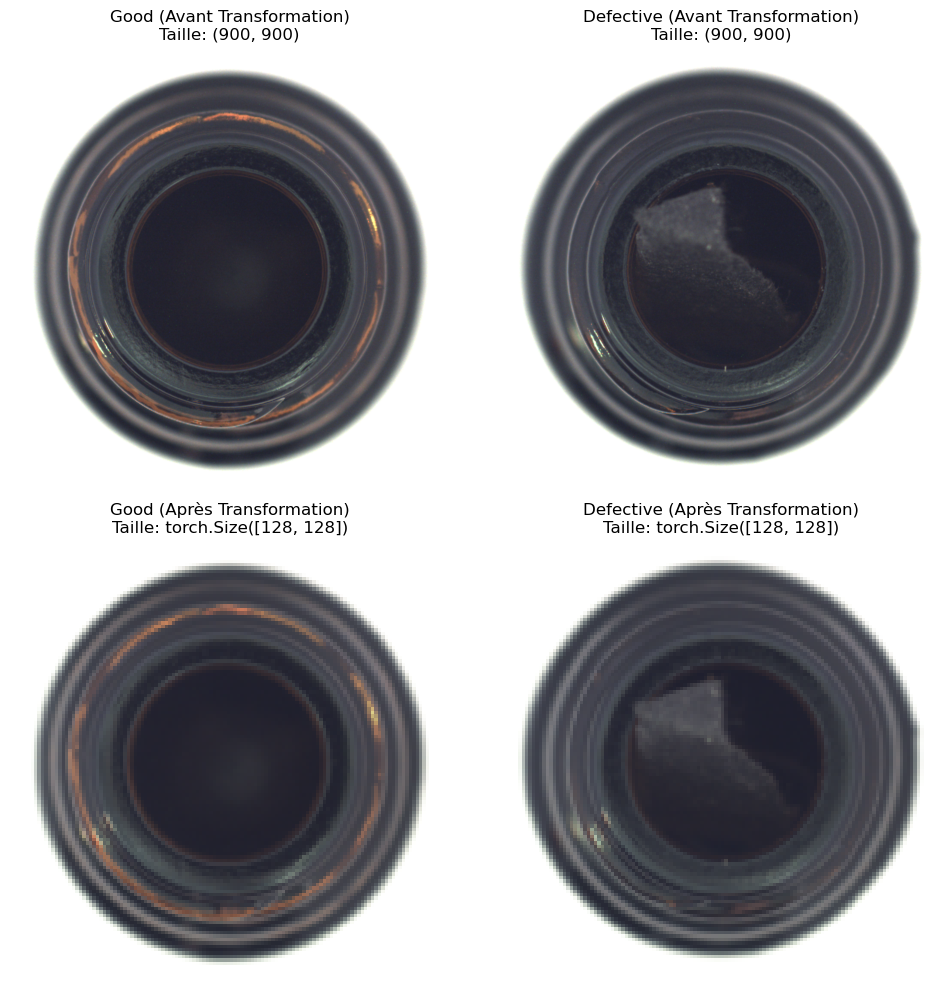

In [15]:
def afficher_image_avec_transformations(dataset, transform, index_good, index_defective):
    """
    Affiche une image "good" et une image "défectueuse" avant et après transformation,
    ainsi que leurs dimensions respectives.

    :param dataset: Dataset brut (DataFrame ou dossier contenant les images)
    :param transform: Transformation à appliquer
    :param index_good: Index de l'image "good" à afficher
    :param index_defective: Index de l'image "défectueuse" à afficher
    """
    # Sélection d'une image good et une défectueuse depuis le DataFrame
    path_good = dataset.iloc[index_good]['filename']
    path_defective = dataset.iloc[index_defective]['filename']

    # Chargement brut des images
    image_good_raw = Image.open(path_good).convert('RGB')
    image_defective_raw = Image.open(path_defective).convert('RGB')

    # Dimensions avant transformation
    size_good_raw = image_good_raw.size
    size_defective_raw = image_defective_raw.size

    # Application des transformations
    image_good_transformed = transform(image_good_raw)
    image_defective_transformed = transform(image_defective_raw)

    # Dimensions après transformation
    size_good_transformed = image_good_transformed.shape[-2:]  # (Height, Width)
    size_defective_transformed = image_defective_transformed.shape[-2:]  # (Height, Width)

    # Conversion des tenseurs en format compatible avec Matplotlib
    image_good_transformed_np = image_good_transformed.permute(1, 2, 0).numpy()
    image_defective_transformed_np = image_defective_transformed.permute(1, 2, 0).numpy()

    # Création des sous-plots pour afficher les images
    fig, axes = plt.subplots(2, 2, figsize=(10, 10))

    # Avant transformation
    axes[0, 0].imshow(image_good_raw)
    axes[0, 0].set_title(f"Good (Avant Transformation)\nTaille: {size_good_raw}")
    axes[0, 0].axis("off")

    axes[0, 1].imshow(image_defective_raw)
    axes[0, 1].set_title(f"Defective (Avant Transformation)\nTaille: {size_defective_raw}")
    axes[0, 1].axis("off")

    # Après transformation
    axes[1, 0].imshow(image_good_transformed_np)
    axes[1, 0].set_title(f"Good (Après Transformation)\nTaille: {size_good_transformed}")
    axes[1, 0].axis("off")

    axes[1, 1].imshow(image_defective_transformed_np)
    axes[1, 1].set_title(f"Defective (Après Transformation)\nTaille: {size_defective_transformed}")
    axes[1, 1].axis("off")

    # Ajustement de l'espacement
    plt.tight_layout()
    plt.show()


# Afficher une image "good" et une "défectueuse" pour Bottle
index_good = 0  # Index de la première image "good" dans total_train_df_bottle
index_defective = next(i for i, x in enumerate(test_df_bottle['category']) if x == 1)  # Trouver un "défectueux"

afficher_image_avec_transformations(test_df_bottle, transform, index_good, index_defective)


In [16]:
# Training images
total_train_df_hazelnut = pd.DataFrame({
    'filename': train_filenames_hazelnut,
    'category': train_categories_H
})

# Test images
test_df_hazelnut = pd.DataFrame({
    'filename': test_filenames_H,
    'category': test_categories_H
})


# Mise à jour des chemins dans le DataFrame pour inclure les extensions correctes
total_train_df_hazelnut['filename'] = total_train_df_hazelnut['filename'].apply(lambda x: os.path.join(pathh+'/train/good', x))
test_df_hazelnut['filename'] = test_df_hazelnut['filename'].apply(lambda x: os.path.join(target_dirH, x))

In [17]:
print(f"Number of training samples: {len(total_train_df_hazelnut)}")
print(f"Number of test samples: {len(test_df_hazelnut)}")

Number of training samples: 391
Number of test samples: 110


In [18]:
train_dataset_hazelnut = CustomDataset(total_train_df_hazelnut, transform=transform)
test_dataset_hazelnut = CustomDataset(test_df_hazelnut, transform=transform)

train_loader_hazelnut = DataLoader(train_dataset_hazelnut, batch_size=32, shuffle=True)
test_loader_hazelnut = DataLoader(test_dataset_hazelnut, batch_size=32, shuffle=False)

for images, labels in train_loader_hazelnut:
    print(f"Batch size: {images.size()}, Labels: {labels}")
    break

Batch size: torch.Size([32, 3, 128, 128]), Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0])


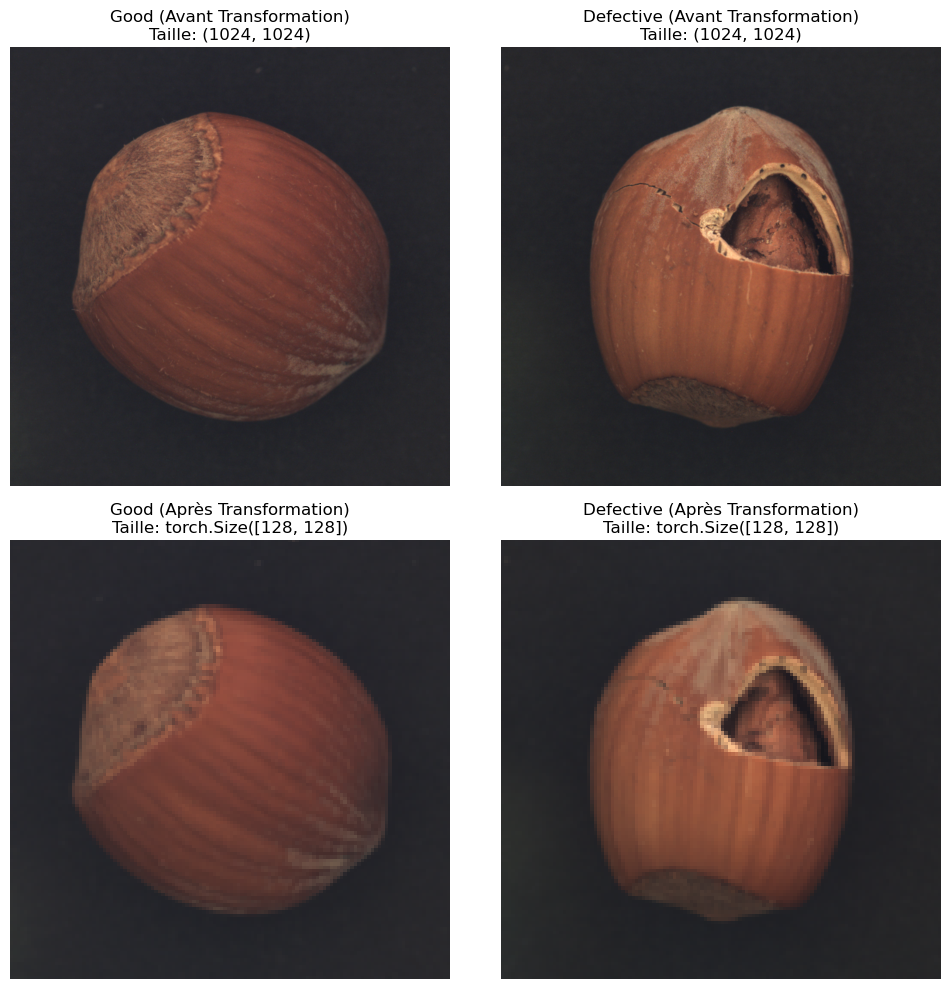

In [19]:
# Afficher une image "good" et une "défectueuse" pour Hazelnut
index_good = 0  # Index de la première image "good"
index_defective = next(i for i, x in enumerate(test_df_hazelnut['category']) if x == 1)  # Trouver un "défectueux"

afficher_image_avec_transformations(test_df_hazelnut, transform, index_good, index_defective)

In [20]:
# Training images
total_train_df_capsule = pd.DataFrame({
    'filename': train_filenames_capsule,
    'category': train_categories_C
})

# Test images
test_df_capsule = pd.DataFrame({
    'filename': test_filenames_C,
    'category': test_categories_C
})

# Mise à jour des chemins dans le DataFrame pour inclure les extensions correctes
total_train_df_capsule['filename'] = total_train_df_capsule['filename'].apply(lambda x: os.path.join(pathc+'/train/good', x))
test_df_capsule['filename'] = test_df_capsule['filename'].apply(lambda x: os.path.join(target_dirC, x))

In [21]:
print(f"Number of training samples: {len(total_train_df_capsule)}")
print(f"Number of test samples: {len(test_df_capsule)}")

Number of training samples: 219
Number of test samples: 132


In [22]:
train_dataset_capsule = CustomDataset(total_train_df_capsule, transform=transform)
test_dataset_capsule = CustomDataset(test_df_capsule, transform=transform)

train_loader_capsule = DataLoader(train_dataset_capsule, batch_size=32, shuffle=True)
test_loader_capsule = DataLoader(test_dataset_capsule, batch_size=32, shuffle=False)

for images, labels in train_loader_capsule:
    print(f"Batch size: {images.size()}, Labels: {labels}")
    break

Batch size: torch.Size([32, 3, 128, 128]), Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0])


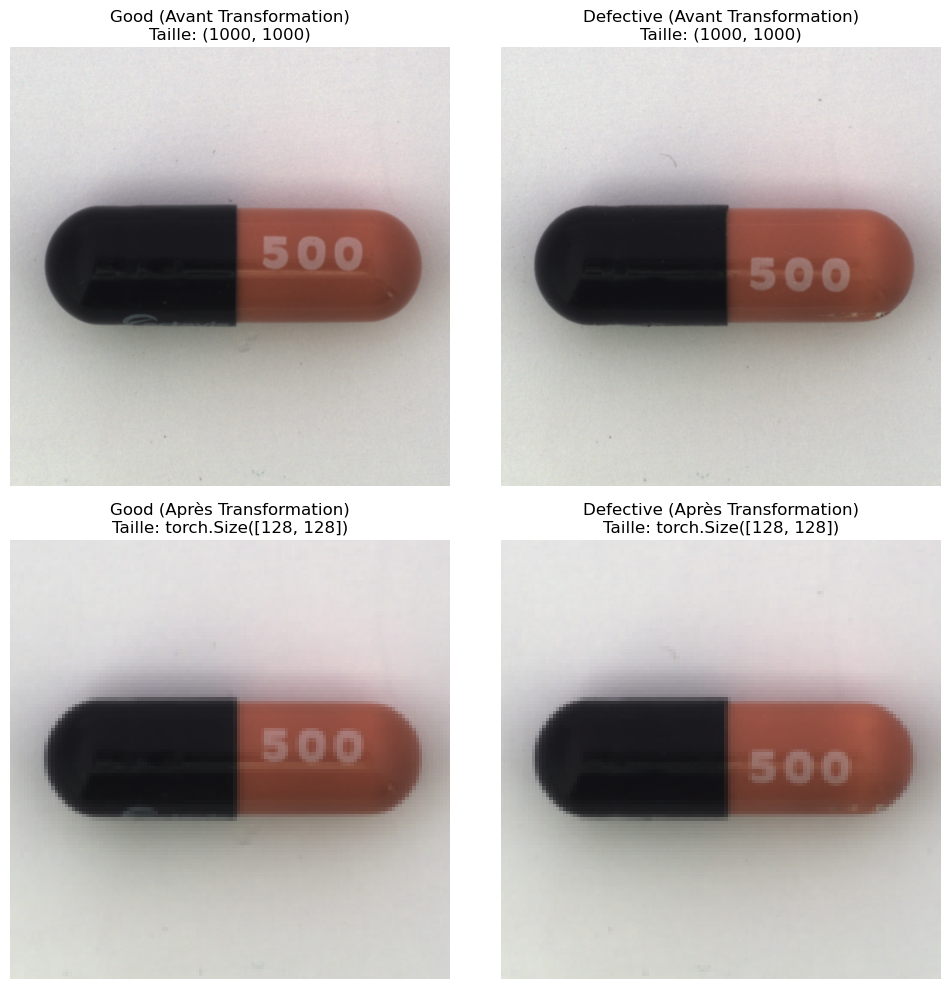

In [23]:
# Afficher une image "good" et une "défectueuse" pour Capsule
index_good = 0  # Index de la première image "good" 
index_defective = next(i for i, x in enumerate(test_df_capsule['category']) if x == 1)  # Trouver un "défectueux"

afficher_image_avec_transformations(test_df_capsule, transform, index_good, index_defective)

In [24]:
# Training images
total_train_df_toothbrush = pd.DataFrame({
    'filename': train_filenames_toothbrush,
    'category': train_categories_T
})

# Test images
test_df_toothbrush = pd.DataFrame({
    'filename': test_filenames_T,
    'category': test_categories_T
})


# Mise à jour des chemins dans le DataFrame pour inclure les extensions correctes
total_train_df_toothbrush['filename'] = total_train_df_toothbrush['filename'].apply(lambda x: os.path.join(patht+'/train/good', x))
test_df_toothbrush['filename'] = test_df_toothbrush['filename'].apply(lambda x: os.path.join(target_dirT, x))

In [25]:
print(f"Number of training samples: {len(total_train_df_toothbrush)}")
print(f"Number of test samples: {len(test_df_toothbrush)}")

Number of training samples: 60
Number of test samples: 42


In [26]:
train_dataset_toothbrush = CustomDataset(total_train_df_toothbrush, transform=transform)
test_dataset_toothbrush = CustomDataset(test_df_toothbrush, transform=transform)

train_loader_toothbrush = DataLoader(train_dataset_toothbrush, batch_size=32, shuffle=True)
test_loader_toothbrush = DataLoader(test_dataset_toothbrush, batch_size=32, shuffle=False)

for images, labels in train_loader_toothbrush:
    print(f"Batch size: {images.size()}, Labels: {labels}")
    break

Batch size: torch.Size([32, 3, 128, 128]), Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0])


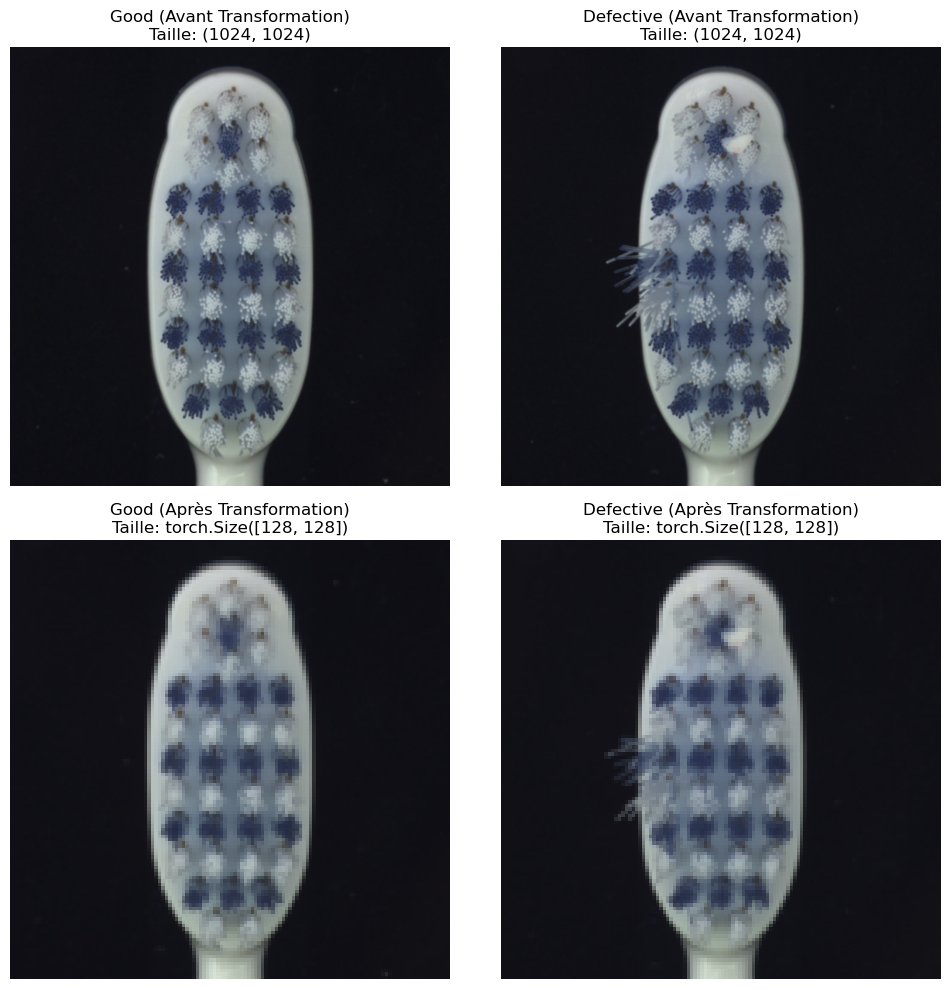

In [27]:
# Afficher une image "good" et une "défectueuse" pour Toothbrush
index_good = 0  # Index de la première image "good" 
index_defective = next(i for i, x in enumerate(test_df_toothbrush['category']) if x == 1)  # Trouver un "défectueux"

afficher_image_avec_transformations(test_df_toothbrush, transform, index_good, index_defective)

In [28]:
# Training images
total_train_df_engine = pd.DataFrame({
    'filename': train_filenames_W,
    'category': train_categories_W
})

# Test images
test_df_engine = pd.DataFrame({
    'filename': test_filenames_W,
    'category': test_categories_W
})

# Mise à jour des chemins dans le DataFrame pour inclure les extensions correctes
total_train_df_engine['filename'] = total_train_df_engine['filename'].apply(lambda x: os.path.join(pathw+'/train/good', x))
test_df_engine['filename'] = test_df_engine['filename'].apply(lambda x: os.path.join(target_dirW, x))


In [29]:
print(f"Number of training samples: {len(total_train_df_engine)}")
print(f"Number of test samples: {len(test_df_engine)}")


Number of training samples: 285
Number of test samples: 607


In [30]:
train_dataset_engine = CustomDataset(total_train_df_engine, transform=transform)
test_dataset_engine = CustomDataset(test_df_engine, transform=transform)

train_loader_engine = DataLoader(train_dataset_engine, batch_size=32, shuffle=True)
test_loader_engine = DataLoader(test_dataset_engine, batch_size=32, shuffle=False)

for images, labels in train_loader_engine:
    print(f"Batch size: {images.size()}, Labels: {labels}")
    break

Batch size: torch.Size([32, 3, 128, 128]), Labels: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0])


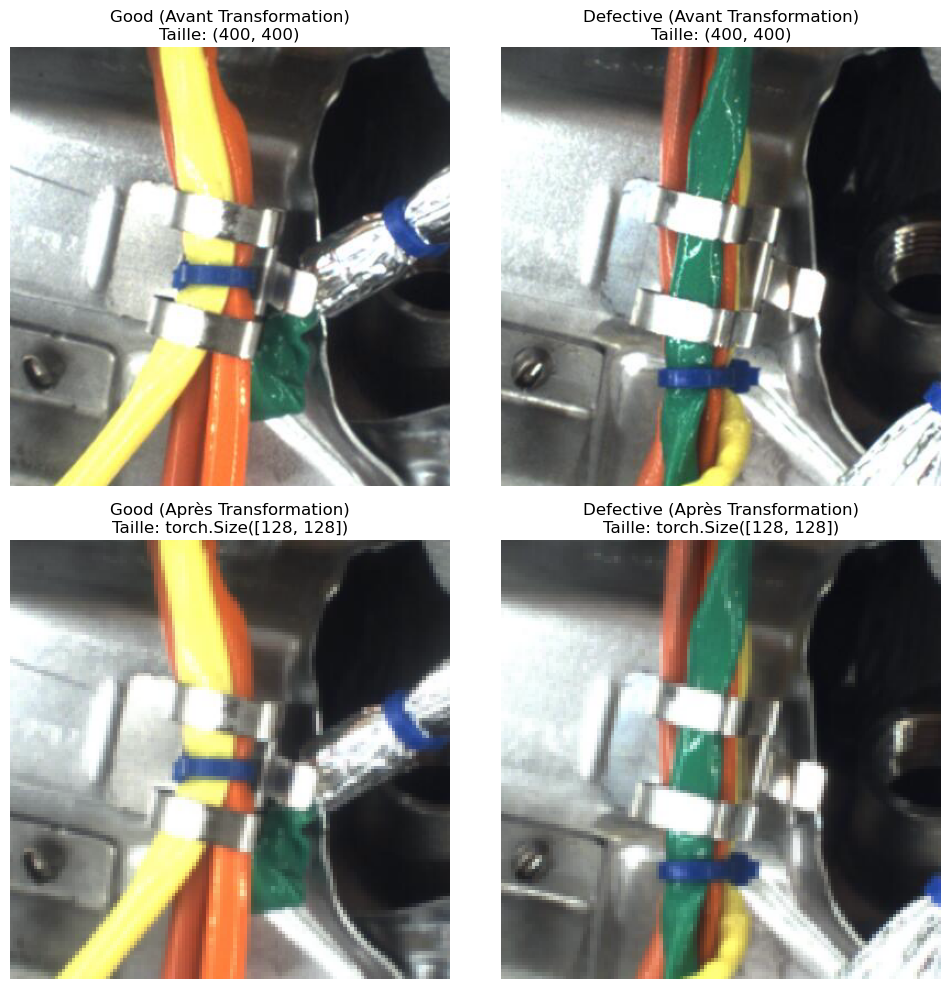

In [31]:
# Afficher une image "good" et une "défectueuse" pour Toothbrush
index_good = 0  # Index de la première image "good" 
index_defective = next(i for i, x in enumerate(test_df_engine['category']) if x == 1)  # Trouver un "défectueux"
afficher_image_avec_transformations(test_df_engine, transform, index_good, index_defective)

# I - Partie 1 : Train SSL

## Initialisation des poids

Les principaux problèmes pouvant nuire à l'apprentissage sont ceux de vanishing ou d'exploding gradient. Dans le cas des vanishing gradients, les gradients deviennent trop petits pour que les poids des couches profondes soient mis à jour au fil des itérations, ce qui ralentit considérablement l'apprentissage, voir empêche le modèle d'apprendre des représentations efficaces. À l'inverse, les gradients sont qualifiés d'exploding gradients lorsqu'ils prennent des valeurs trop grandes, ce qui rend l'entraînement instable et conduit souvent à une divergence du modèle : les poids deviennent trop grands pour être contrôlés. 
Pour éviter cela, il convient d'initialiser les poids de façon pertinente. 
Étant donné que nos fonctions d'activation sont de type ReLU, la méthode d'initialisation la plus adaptée est celle de type He (*kaiming_normal_*). Elle génère des valeurs de poids selon une distribution normale centrée et dont la variance dépend de la taille du noyau de convolution (nombre de neurones de la couche précédente). Ainsi, la variance des activations est préservée au fil des couches et les gradients ne peuvent prendre de valeur trop grandes ou trop petites.
Enfin, les biais sont initialisés à zéro car ils ne doivent pas influencer les activations au début de l'entraînement.

In [32]:
def initialize_weights(model):
    """
    Initialise les poids du modèle de manière appropriée pour les couches convolutives et de normalisation.
    """
    for m in model.modules():
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            nn.init.kaiming_normal_(m.weight, nonlinearity='relu')  # Initialisation He pour ReLU
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)  # Initialisation des biais à zéro
        elif isinstance(m, nn.BatchNorm2d):
            nn.init.constant_(m.weight, 1)  # Initialisation des poids à 1 pour BatchNorm
            nn.init.constant_(m.bias, 0)  # Initialisation des biais à zéro


In [33]:
def Weight_and_train(train_loader, test_loader):
    # Utiliser le modèle amélioré
    colorization_model = ColorizationModel(latent_dim=32)  # Modèle avec un vrai bottleneck
    initialize_weights(colorization_model)  # Initialisation des poids

    # Entraînement du modèle
    colorization_model = train_colorization_model(
        colorization_model,
        train_loader,
        test_loader,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(colorization_model.parameters(), lr=0.001),
        device=device,
        epochs=10,  # Plus d'époques pour mieux converger
    )
    
    return colorization_model

### Principes généraux de nos architectures


#### 1) Encoder (encodeur)

L'encodeur a pour objectif de transformer l'image d'entrée en une représentation de dimension inférieure, souvent appelée latent space ou espace latent. L'encodeur ici utilise des couches convolutionnelles pour extraire progressivement des caractéristiques de plus en plus abstraites à partir des pixels de l'image.

Convolutionnal Layers (Couches Convolutionnelles) : L'encodeur utilise plusieurs couches convolutionnelles (nn.Conv2d) avec un noyau de taille 4x4, un stride de 2 et un padding de 1. Le stride de 2 dans chaque couche permet d'augmenter le nombre de canaux, et réduit la résolution spatiale de l'image (par exemple de 32x32 à 16x16, puis de 16x16 à 8x8, etc.). Cela permet de capturer des informations de plus en plus abstraites tout en conservant un contexte spatial. Cela est fait progressivement entre chaque activation car différents niveaux d'abstractions considéreront différents features (pattern et structure) comme important : nous extrayons donc des informations différentes. 
Les activations ReLU introduisent de la non-linéarité et aider à modéliser des relations plus complexes entre les pixels, sa présence permet aussi d'éviter le problème du vanishing gradient qui affecte certaines autres fonctions d'activation comme la sigmoïde ou tanh.

#### 2) Latent Dimension :
La dernière couche convolutionnelle produit une sortie de taille latent_dim (ici 128), qui correspond à l'espace latent. Il s'agit d'une representation simplifiée de l'image, qui ne retient que les détails les plus importants, filtrés par l'encodeur.


#### 3) Decoder (décodeur):
Le rôle du décodeur est de reconstruire l'image originale à partir de la représentation comprimée dans l'espace latent. Le décodeur utilise des couches de convolution transposée (ou déconvolution) pour effectuer cette tâche.

Transposed Convolutional Layers (Couches de Convolution Transposée) :,Le décodeur utilise des couches nn.ConvTranspose2d pour augmenter la résolution de l'image et ramener la dimension de l'espace latent vers la taille d'entrée originale. Chaque couche applique une opération de convolution transposée avec un stride de 2 et un padding de 1, ce qui permet d'agrandir la dimension spatiale de l'image à chaque étape, et donc d'étirer l'information présente dans l'espace latent pour la reconstruction. Le stride de 2 inverse l'effet du stride dans l'encodeur, augmentant ainsi progressivement la taille de l'image (par exemple de 2x2 à 4x4, puis de 4x4 à 8x8, etc.).

Activations ReLU et Sigmoid : ReLU est utilisé pour les couches intermédiaires pour introduire de la non-linéarité, ce qui aide à capturer des relations plus complexes entre les pixels et donc à la reconstruction de l'image. La dernière couche utilise Sigmoid pour limiter les valeurs de sortie entre 0 et 1, pour correspondre à la plage des valeurs de pixels dans les images, normalisées entre [0, 1]
   

# II - Pretext tasks 1 : colorizing model

La première tâche prétexte mise en place est la colorization. On utilise un autoencodeur pour coloriser des images d’entrée, converties en niveaux de gris. L’encodeur extrait les caractéristiques structurelles et texturales de l’image en niveaux de gris pour les compresser dans une représentation latente. Le décodeur reconstruit ensuite l’image en couleur à partir de cette représentation.

Lors du déploiement pour la détection d’anomalies, les images en couleur sont d’abord converties en niveaux de gris. Le modèle génère une reconstruction colorisée à partir de la représentation latente. La comparaison entre l’image reconstruite et l’image originale permet de calculer une erreur de reconstruction, qui servira d’indicateur pour détecter les anomalies. En effet, une anomalie perturbe les textures et les structures fines que le modèle a appris à capturer, ce qui conduit à une erreur de reconstruction élevée.

In [37]:
class ColorizingEncoder(nn.Module):
    def __init__(self, in_channels=1, latent_dim=32):
        super(ColorizingEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, latent_dim, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(latent_dim),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.encoder(x)
class ColorizingDecoder(nn.Module):
    def __init__(self, latent_dim=32, out_channels=3):
        super(ColorizingDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.decoder(x)

La Batch Normalization est utilisée pour stabiliser l’apprentissage en réduisant la variance interne des covariances et en permattant d’accélérer la convergence. Elle facilite l’utilisation de taux d’apprentissage plus élevés tout en améliorant la généralisation du modèle grâce à un effet de régularisation. Dans le contexte de la colorization, où les anomalies perturbent les textures locales, Batch Normalization favorise une extraction plus robuste et efficace des caractéristiques pertinentes dans les couches profondes de l’encodeur, améliorant ainsi la qualité des reconstructions

In [38]:
class ColorizationModel(nn.Module):
    def __init__(self, latent_dim=32):
        super(ColorizationModel, self).__init__()
        self.encoder = ColorizingEncoder(latent_dim=latent_dim, in_channels=1)
        self.decoder = ColorizingDecoder(latent_dim=latent_dim, out_channels=3)

    def forward(self, x):
        if x.shape[1] == 3:
            grayscale_x = x.mean(dim=1, keepdim=True)  # Convert RGB to Grayscale
        elif x.shape[1] == 1:
            grayscale_x = x
        else:
            raise ValueError(f"Unexpected number of channels in input: {x.shape[1]}")

        latent = self.encoder(grayscale_x)
        reconstructed = self.decoder(latent)

        return reconstructed, grayscale_x

### Fonctions de préparation et d'entrainement des dataloaders
Préparation des données d'entrée (standardisation, voir plus haut la description de *CustomDataset*) afin de garantir qu'elles sont adaptées à l'entraînement du modèle et organisations en batchs.

Entraînement du modèle de colorisation d'images, calcul des pertes, mise à jour des poids du modèle.

In [39]:
# Adjusted training function to improve convergence
def train_colorization_model(model, train_loader, test_loader, criterion, optimizer, device, epochs=10):
    model.to(device)
    for epoch in range(epochs):
        model.train()
        total_train_loss = 0
        for images, _ in train_loader:
            images = images.to(device)
            optimizer.zero_grad()

            outputs, _ = model(images)
            loss = criterion(outputs, images)
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)

        model.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, _ in test_loader:
                images = images.to(device)
                outputs, _ = model(images)
                val_loss = criterion(outputs, images)
                total_val_loss += val_loss.item()

        avg_val_loss = total_val_loss / len(test_loader)

        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    return model

In [40]:
def visualize_reconstructions(model, data_loader, device, num_images=5):
    """
    Visualise les reconstructions réalisées par le modèle de colorisation.
    Affiche les images en niveaux de gris, les images originales, et les images reconstruites.
    """
    # Assurez-vous que le modèle est sur le bon dispositif
    model.to(device)
    model.eval()

    # Convertir le DataLoader en liste pour échantillonner des images aléatoirement
    dataset = list(data_loader.dataset)

    # Sélectionner aléatoirement `num_images` images du dataset
    random_indices = random.sample(range(len(dataset)), num_images)
    random_images = [dataset[i][0] for i in random_indices]  # Extraire seulement les images

    # Empiler les images dans un batch
    images = torch.stack(random_images).to(device)

    # Faire passer les images dans le modèle
    with torch.no_grad():
        reconstructed_images, grayscale_images = model(images)

    # Déplacer les données sur le CPU pour les visualiser
    images = images.cpu()
    reconstructed_images = reconstructed_images.cpu()
    grayscale_images = grayscale_images.cpu()

    # Visualiser les résultats
    fig, axes = plt.subplots(num_images, 3, figsize=(15, num_images * 4))

    for i in range(num_images):
        # Image en niveaux de gris
        axes[i, 0].imshow(grayscale_images[i].squeeze(), cmap='gray')
        axes[i, 0].set_title("Grayscale Input")
        axes[i, 0].axis('off')

        # Image originale (RGB)
        axes[i, 1].imshow(images[i].permute(1, 2, 0))
        axes[i, 1].set_title("Original Image")
        axes[i, 1].axis('off')

        # Image reconstruite
        axes[i, 2].imshow(reconstructed_images[i].permute(1, 2, 0))
        axes[i, 2].set_title("Reconstructed Image")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()


### Fonctions de calcul des pertes (loss) et d'affichage des courbes ROC


Les fonctions suivantes servent à évaluer la performance des modèles grâce à différentes métriques.

D'une part, nous calculons la perte (*calculate_losses*) image par image en utilisant pour chaque modèle et jeu de données, selon un critère donné. Pour chaque lot d'images dans le dataloader, elle génère des prédictions, puis, elle calcule et retourne la perte associée pour chaque image.

Ensuite, nous allons tracer la courbe ROC et calculer la précision, le rappel et le f1-score associés à un modèle (*plot_roc_curve_with_metrics*). Tout d'abord, nous allons déterminer un seuil sur l'erreur de reconstruction, propre à chaque modèle, à partir duquel un exemple sera classé comme "anomalie" ou "normal". Ici, ce seuil optimal est déterminé en maximisant la différence entre le taux de vrais positifs (TPR) et le taux de faux positifs (FPR) et choisi pour obtenir le meilleur compromis entre la détection des anomalies (maximisation du rappel) et la minimisation du risque de classer des exemples normaux comme anormaux (minimisation du taux de faux positifs).

Une fois ce seuil déterminé, il est utilisé déterminer si un exemple sera classé comme positif (anomalie) ou négatif (normal) : si la perte pour un échantillon est supérieure ou égale au seuil, il est classé comme anomalie. Le choix du seuil optimal est important, car il affecte directement les métriques comme la précision et le rappel, et donc la performance globale du modèle.










In [41]:
# Calculate losses for ROC analysis
from sklearn.metrics import roc_curve, auc,  classification_report, f1_score, precision_score, recall_score

def calculate_losses(model, dataloader, criterion, device):
    model.eval()
    losses = []
    with torch.no_grad():
        for images, _ in dataloader:
            images = images.to(device)
            outputs, _ = model(images)

            # Compute loss per image
            batch_losses = criterion(outputs, images)
            if batch_losses.dim() == 4:
                batch_losses = batch_losses.mean(dim=(1, 2, 3))  # Reduce spatial dimensions

            losses.extend(batch_losses.cpu().numpy())

    return np.array(losses)

# Plot ROC curve for anomaly detection

def plot_roc_curve_with_metrics(losses, labels, class_name):
    fpr, tpr, thresholds = roc_curve(labels, losses)
    roc_auc = auc(fpr, tpr)

    # Optimal threshold
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = thresholds[optimal_idx]
    print(f"Optimal Threshold: {optimal_threshold}")

    # Predictions based on the optimal threshold
    predictions = (losses >= optimal_threshold).astype(int)

    # Classification report
    print(f"\nClassification Report for {class_name}:")
    print(classification_report(labels, predictions, target_names=["Normal", "Anomalous"]))

    # Calculate additional metrics
    precision = precision_score(labels, predictions, pos_label=1)
    recall = recall_score(labels, predictions, pos_label=1)
    f1 = f1_score(labels, predictions, pos_label=1)

    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1-Score: {f1:.2f}")

    # Plot ROC curve
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.scatter(fpr[optimal_idx], tpr[optimal_idx], color='red', label=f'Optimal Threshold: {optimal_threshold:.4f}')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve for {class_name}')
    plt.legend(loc="lower right")
    plt.show()

    return roc_auc, precision, recall, f1

**Exactitude (Accuracy)**  
Formule = $\frac{TP + TN}{TP + TN + FP + FN}$  
 
L'exactitude mesure la justesse globale d'un modèle de classification. Elle représente la proportion de prédictions correctes (positives et négatives) par rapport au total des prédictions. Cette métrique est utile lorsque le jeu de données est équilibré.

**Rappel / Taux de vrais positifs (TPR)**  
Formule = $\frac{TP}{TP + FN}$  
 
Le rappel, également appelé sensibilité ou TPR, mesure la capacité du modèle à identifier correctement les cas positifs. Il répond à la question : « Parmi les cas réellement positifs, combien ont été correctement identifiés ? »

**F1 Score**  
Formule =$2 \cdot \frac{\text{Précision} \cdot \text{Rappel}}{\text{Précision} + \text{Rappel}}$  
  
Le F1 score est la moyenne harmonique entre la précision et le rappel. Il équilibre le compromis entre ces deux métriques et est particulièrement utile dans les contextes où les classes sont déséquilibrées.

**Précision (Precision)**  
Formule = $\frac{TP}{TP + FP}$  
 
La précision mesure la justesse des prédictions positives. Elle répond à la question : « Parmi les cas prédits comme positifs, combien sont réellement positifs ? »

**Matrice de confusion :**  

\[
\begin{array}{|c|c|c|}
\hline
 & \text{Prédiction Négative} & \text{Prédiction Positive} \\
\hline
\text{Ground truth Négatif} & \text{Vrai Négatif (TN)} & \text{Faux Positif (FP)} \\
\hline
\text{Ground truth Positif} & \text{Faux Négatif (FN)} & \text{Vrai Positif (TP)} \\
\hline
\end{array}
\]






### Choix du critère de perte

Par la suite, nous utiliserons la MSE comme fonction de perte. Celle-ci est en effet la plus adaptée aux tâches de reconstruction car il s'agit d'une comparaison directe (erreur quadratique) entre le résultat obtenu et l'objectif, qui est l'image d'entrée elle-même. Son comportement est stable et adapté aux sorties continues, comme les images que nous avons, ce qui la rend plus interprétable et facile à mettre en place. De plus, la mise au carré pénalise les erreurs les plus grandes, ce qui est pertinent dans notre cas : la discrimination entre les images les moins bien reconstruites (normalement, les anomalies) en sera d'autant plus marquée. Afin de renforcer cela, nous la calculons sans réduction (c'est-à-dire pixels par pixel, sans moyenner), ce qui permet de garder une trace des erreurs à des niveaux très fins.

### Bottle 

In [39]:
print("Training bottle")

# Pré-entrainement pour "bottle"
colorization_model_bottle = Weight_and_train(train_loader_bottle, test_loader_bottle)

Training bottle
Epoch 1/10, Train Loss: 0.1219, Validation Loss: 0.0934
Epoch 2/10, Train Loss: 0.0272, Validation Loss: 0.0406
Epoch 3/10, Train Loss: 0.0142, Validation Loss: 0.0204
Epoch 4/10, Train Loss: 0.0090, Validation Loss: 0.0111
Epoch 5/10, Train Loss: 0.0061, Validation Loss: 0.0072
Epoch 6/10, Train Loss: 0.0045, Validation Loss: 0.0056
Epoch 7/10, Train Loss: 0.0037, Validation Loss: 0.0046
Epoch 8/10, Train Loss: 0.0032, Validation Loss: 0.0039
Epoch 9/10, Train Loss: 0.0029, Validation Loss: 0.0036
Epoch 10/10, Train Loss: 0.0027, Validation Loss: 0.0034


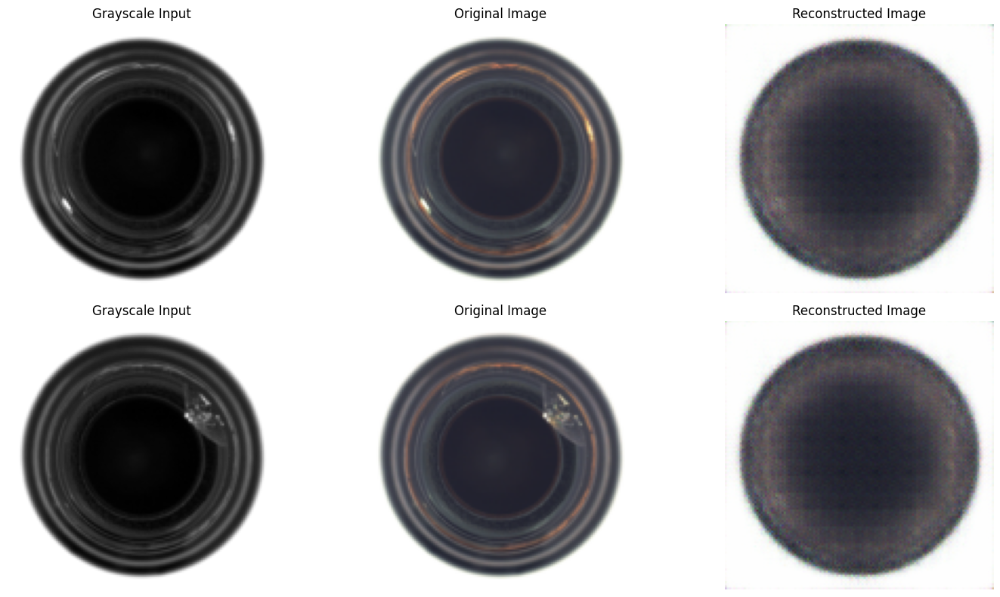

In [40]:
visualize_reconstructions(colorization_model_bottle, test_loader_bottle, device=device, num_images=2)

In [41]:
# Calculer les pertes pour les données de test
losses_bottle = calculate_losses(
    colorization_model_bottle,
    test_loader_bottle,
    nn.MSELoss(reduction='none'),  # Perte sans réduction pour calculer par image
    device
)

Optimal Threshold: 0.0042746905237436295

Classification Report for Bottle:
              precision    recall  f1-score   support

      Normal       0.36      1.00      0.53        20
   Anomalous       1.00      0.43      0.60        63

    accuracy                           0.57        83
   macro avg       0.68      0.71      0.56        83
weighted avg       0.85      0.57      0.58        83

Precision: 1.00
Recall: 0.43
F1-Score: 0.60


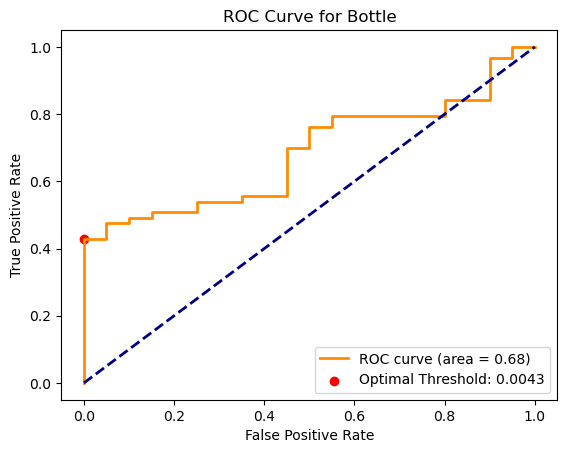

AUROC for Bottle: 0.68
Precision: 1.00, Recall: 0.43, F1-Score: 0.60


In [73]:
# Labels de test (0 pour normal, 1 pour défectueux)
labels_bottle = np.array(test_categories_B)

# Tracer la courbe ROC et calculer l'AUROC
# Retrieve all metrics
auroc_bottle, precision_bottle, recall_bottle, f1_bottle = plot_roc_curve_with_metrics(losses_bottle, labels_bottle, "Bottle")

# Print the metrics individually
print(f"AUROC for Bottle: {auroc_bottle:.2f}")
print(f"Precision: {precision_bottle:.2f}, Recall: {recall_bottle:.2f}, F1-Score: {f1_bottle:.2f}")

**Explications threshold** 
Il détermine à partir de quelle valeur de perte une image est considérée comme anormale. Ici l’optimal threshold = 0.0032 (si la perte d'une image ≥ 0.0032, elle est classée comme anormale, sinon elle est classée comme normale).

Il permet d'évaluer :

- La précision : Combien d’images anormales sont correctement identifiées.
- Le rappel (recall) : Quelle proportion des anomalies réelles a été détectée.
- Le F1-Score : Moyenne harmonique entre précision et rappel.

Ici on a 

- Precision = 0.95 => Parmi les images détectées comme anormales, 95 % sont vraiment anormales.
- Recall = 0.59  => 59 % des anomalies réelles ont été détectées.
- F1-Score = 0.73  => Bon équilibre entre précision et rappel.
- et AUROC = 0.74  => La capacité globale du modèle à séparer les anomalies des images normales.

### Hazelnut 

In [43]:
print("Training hazelnut")

# Pré-entrainement pour "hazelnut"
colorization_model_hazelnut= Weight_and_train(train_loader_hazelnut, test_loader_hazelnut)

Training hazelnut
Epoch 1/10, Train Loss: 0.0541, Validation Loss: 0.0191
Epoch 2/10, Train Loss: 0.0173, Validation Loss: 0.0121
Epoch 3/10, Train Loss: 0.0111, Validation Loss: 0.0109
Epoch 4/10, Train Loss: 0.0085, Validation Loss: 0.0089
Epoch 5/10, Train Loss: 0.0071, Validation Loss: 0.0084
Epoch 6/10, Train Loss: 0.0057, Validation Loss: 0.0070
Epoch 7/10, Train Loss: 0.0044, Validation Loss: 0.0086
Epoch 8/10, Train Loss: 0.0036, Validation Loss: 0.0050
Epoch 9/10, Train Loss: 0.0024, Validation Loss: 0.0029
Epoch 10/10, Train Loss: 0.0018, Validation Loss: 0.0024


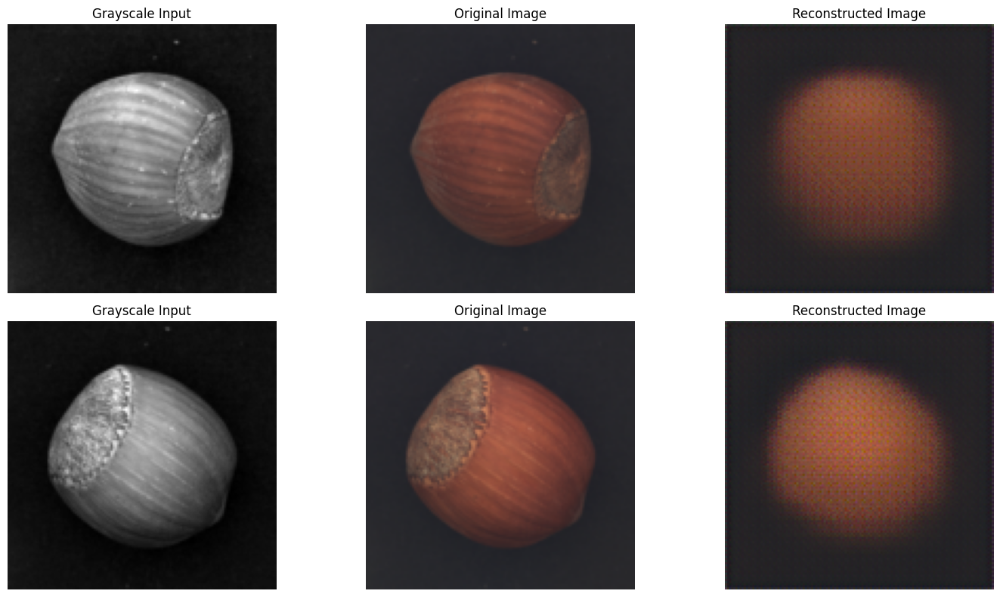

In [44]:
visualize_reconstructions(colorization_model_hazelnut, test_loader_hazelnut, device=device, num_images=2)

In [45]:
# Calculer les pertes pour les données de test
losses_hazelnut = calculate_losses(
    colorization_model_hazelnut,
    test_loader_hazelnut,
    nn.MSELoss(reduction='none'),  # Perte sans réduction pour calculer par image
    device
)

Optimal Threshold: 0.0013145891716703773

Classification Report for Hazelnut:
              precision    recall  f1-score   support

      Normal       0.55      0.88      0.67        40
   Anomalous       0.89      0.59      0.71        70

    accuracy                           0.69       110
   macro avg       0.72      0.73      0.69       110
weighted avg       0.77      0.69      0.69       110

Precision: 0.89
Recall: 0.59
F1-Score: 0.71


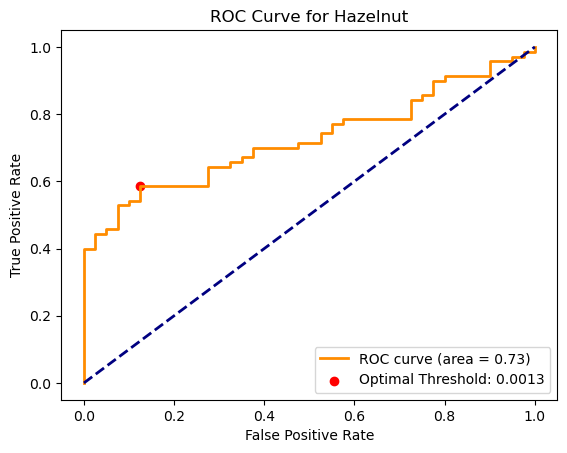

AUROC for Hazelnut: 0.73
Precision: 0.89, Recall: 0.59, F1-Score: 0.71


In [74]:
# Labels de test (0 pour normal, 1 pour défectueux)
labels_hazelnut = np.array(test_categories_H)

# Tracer la courbe ROC et calculer l'AUROC
# Retrieve all metrics
auroc_hazelnut, precision_hazelnut, recall_hazelnut, f1_hazelnut = plot_roc_curve_with_metrics(losses_hazelnut, labels_hazelnut, "Hazelnut")

# Print the metrics individually
print(f"AUROC for Hazelnut: {auroc_hazelnut:.2f}")
print(f"Precision: {precision_hazelnut:.2f}, Recall: {recall_hazelnut:.2f}, F1-Score: {f1_hazelnut:.2f}")

### Capsule 

In [47]:
print("Training capsule")

# Pré-entrainement pour "capsule"
colorization_model_capsule= Weight_and_train(train_loader_capsule, test_loader_capsule)

Training capsule
Epoch 1/10, Train Loss: 0.0725, Validation Loss: 0.0501
Epoch 2/10, Train Loss: 0.0180, Validation Loss: 0.0202
Epoch 3/10, Train Loss: 0.0128, Validation Loss: 0.0119
Epoch 4/10, Train Loss: 0.0092, Validation Loss: 0.0118
Epoch 5/10, Train Loss: 0.0069, Validation Loss: 0.0071
Epoch 6/10, Train Loss: 0.0053, Validation Loss: 0.0062
Epoch 7/10, Train Loss: 0.0042, Validation Loss: 0.0042
Epoch 8/10, Train Loss: 0.0034, Validation Loss: 0.0037
Epoch 9/10, Train Loss: 0.0029, Validation Loss: 0.0035
Epoch 10/10, Train Loss: 0.0026, Validation Loss: 0.0029


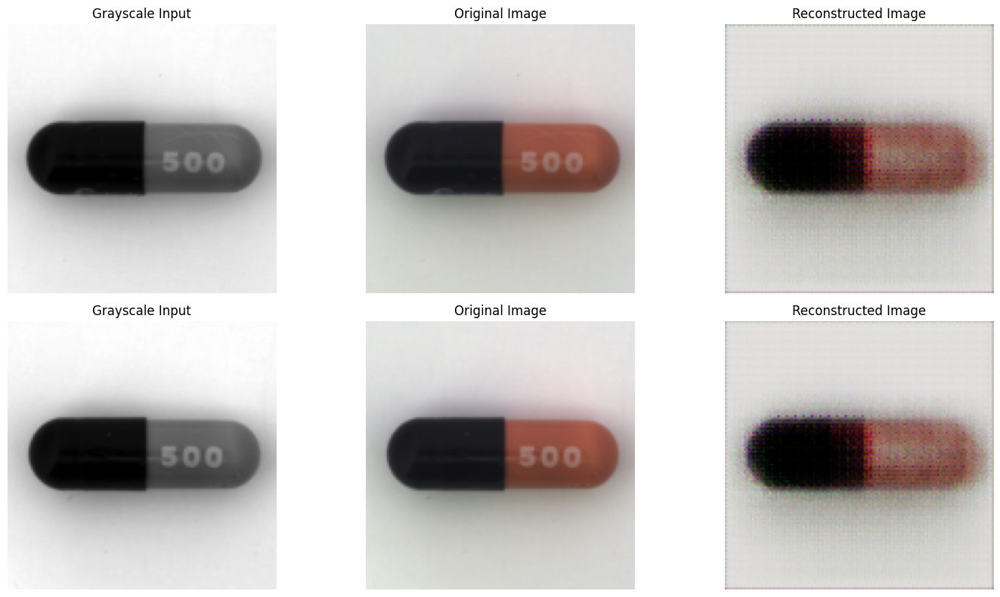

In [48]:
visualize_reconstructions(colorization_model_capsule, test_loader_capsule, device=device, num_images=2)

In [49]:
# Calculer les pertes pour les données de test
losses_capsule = calculate_losses(
    colorization_model_capsule,
    test_loader_capsule,
    nn.MSELoss(reduction='none'),  # Perte sans réduction pour calculer par image
    device
)

Optimal Threshold: 0.0035524494014680386

Classification Report for Capsule:
              precision    recall  f1-score   support

      Normal       0.18      1.00      0.31        23
   Anomalous       1.00      0.06      0.12       109

    accuracy                           0.23       132
   macro avg       0.59      0.53      0.22       132
weighted avg       0.86      0.23      0.15       132

Precision: 1.00
Recall: 0.06
F1-Score: 0.12


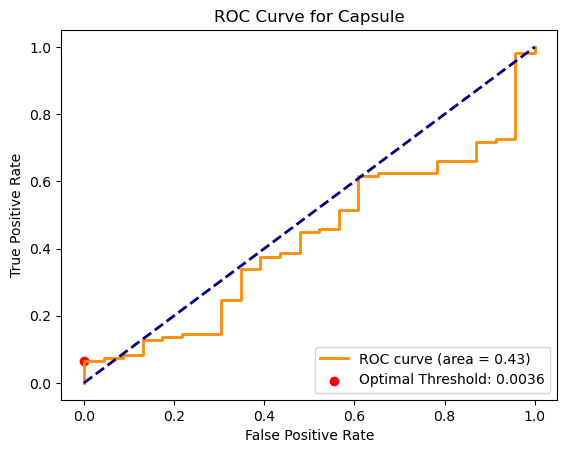

AUROC for Capsule: 0.43
Precision: 1.00, Recall: 0.06, F1-Score: 0.12


In [75]:
# Labels de test (0 pour normal, 1 pour défectueux)
labels_capsule = np.array(test_categories_C)

# Tracer la courbe ROC et calculer l'AUROC
# Retrieve all metrics
auroc_capsule, precision_capsule, recall_capsule, f1_capsule = plot_roc_curve_with_metrics(losses_capsule, labels_capsule, "Capsule")

# Print the metrics individually
print(f"AUROC for Capsule: {auroc_capsule:.2f}")
print(f"Precision: {precision_capsule:.2f}, Recall: {recall_capsule:.2f}, F1-Score: {f1_capsule:.2f}")

### Toothbrush 

In [51]:
print("Training toothbrush")

# Pré-entrainement pour "capsule"
colorization_model_toothbrush = Weight_and_train(train_loader_toothbrush, test_loader_toothbrush)

Training toothbrush
Epoch 1/10, Train Loss: 0.1878, Validation Loss: 0.2064
Epoch 2/10, Train Loss: 0.0957, Validation Loss: 0.2651
Epoch 3/10, Train Loss: 0.0660, Validation Loss: 0.2432
Epoch 4/10, Train Loss: 0.0529, Validation Loss: 0.1938
Epoch 5/10, Train Loss: 0.0445, Validation Loss: 0.1435
Epoch 6/10, Train Loss: 0.0384, Validation Loss: 0.1043
Epoch 7/10, Train Loss: 0.0337, Validation Loss: 0.0777
Epoch 8/10, Train Loss: 0.0303, Validation Loss: 0.0590
Epoch 9/10, Train Loss: 0.0274, Validation Loss: 0.0444
Epoch 10/10, Train Loss: 0.0247, Validation Loss: 0.0325


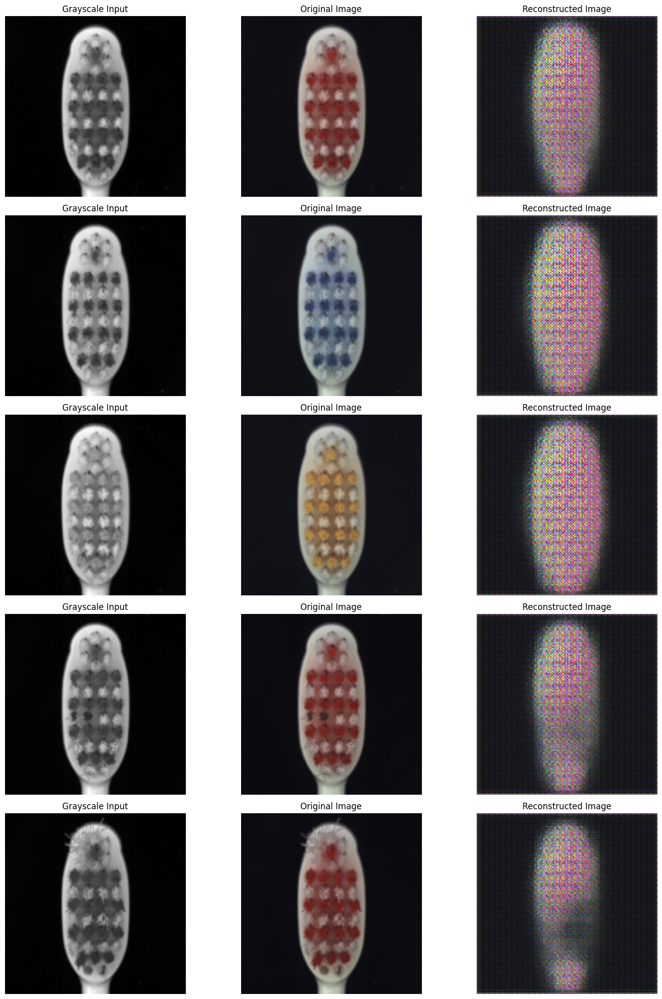

In [52]:
visualize_reconstructions(colorization_model_toothbrush, test_loader_toothbrush, device=device, num_images=5)

In [53]:
# Calculer les pertes pour les données de test
losses_toothbrush = calculate_losses(
    colorization_model_toothbrush,
    test_loader_toothbrush,
    nn.MSELoss(reduction='none'),  # Perte sans réduction pour calculer par image
    device
)

Optimal Threshold: 0.028358936309814453

Classification Report for Toothbrush:
              precision    recall  f1-score   support

      Normal       0.34      1.00      0.51        12
   Anomalous       1.00      0.23      0.38        30

    accuracy                           0.45        42
   macro avg       0.67      0.62      0.44        42
weighted avg       0.81      0.45      0.42        42

Precision: 1.00
Recall: 0.23
F1-Score: 0.38


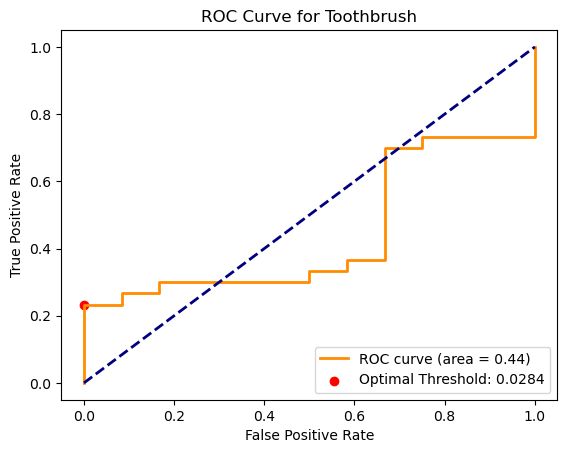

AUROC for Toothbrush: 0.44
Precision: 1.00, Recall: 0.23, F1-Score: 0.38


In [76]:
# Labels de test (0 pour normal, 1 pour défectueux)
labels_toothbrush = np.array(test_categories_T)

# Tracer la courbe ROC et calculer l'AUROC
# Retrieve all metrics
auroc_toothbrush, precision_toothbrush, recall_toothbrush, f1_toothbrush = plot_roc_curve_with_metrics(losses_toothbrush, labels_toothbrush, "Toothbrush")

# Print the metrics individually
print(f"AUROC for Toothbrush: {auroc_toothbrush:.2f}")
print(f"Precision: {precision_toothbrush:.2f}, Recall: {recall_toothbrush:.2f}, F1-Score: {f1_toothbrush:.2f}")

Explications.

### Engine wiring

In [42]:
print("Training engine wiring")

# Pré-entrainement pour "capsule"
colorization_model_engine = Weight_and_train(train_loader_engine, test_loader_engine)

Training engine wiring
Epoch 1/10, Train Loss: 0.1086, Validation Loss: 0.1644
Epoch 2/10, Train Loss: 0.0528, Validation Loss: 0.0634
Epoch 3/10, Train Loss: 0.0390, Validation Loss: 0.0369
Epoch 4/10, Train Loss: 0.0300, Validation Loss: 0.0281
Epoch 5/10, Train Loss: 0.0250, Validation Loss: 0.0240
Epoch 6/10, Train Loss: 0.0217, Validation Loss: 0.0205
Epoch 7/10, Train Loss: 0.0193, Validation Loss: 0.0188
Epoch 8/10, Train Loss: 0.0175, Validation Loss: 0.0174
Epoch 9/10, Train Loss: 0.0158, Validation Loss: 0.0163
Epoch 10/10, Train Loss: 0.0144, Validation Loss: 0.0156


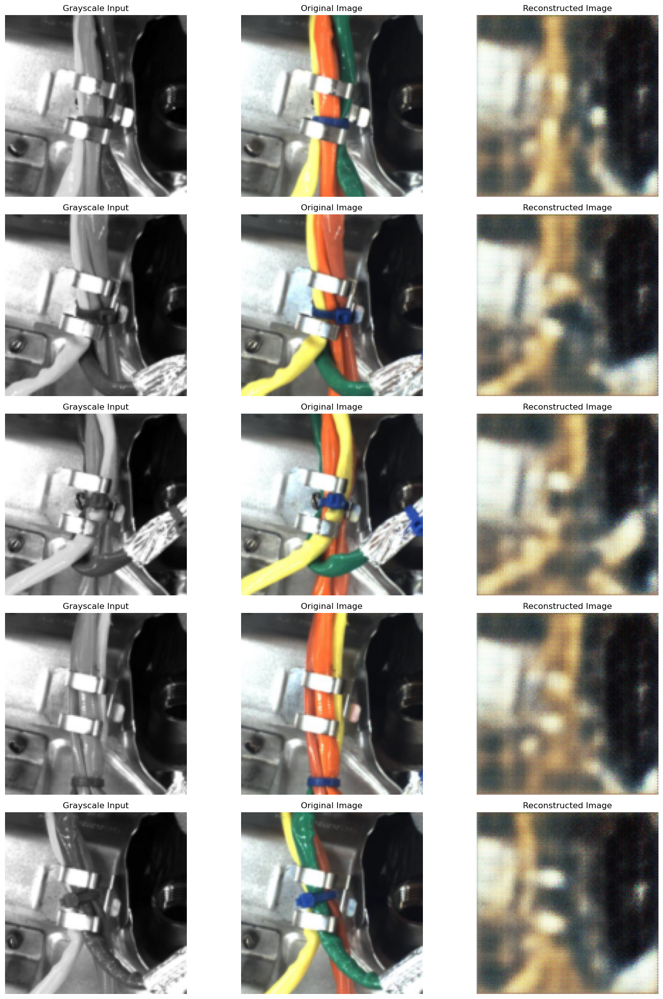

In [43]:
visualize_reconstructions(colorization_model_engine, test_loader_engine, device=device, num_images=5)

In [44]:
losses_engine = calculate_losses(
    colorization_model_engine,
    test_loader_engine,
    nn.MSELoss(reduction='none'),  # Perte sans réduction pour calculer par image
    device
)

Optimal Threshold: 0.010432298295199871

Classification Report for Engine:
              precision    recall  f1-score   support

      Normal       0.58      0.65      0.61       285
   Anomalous       0.65      0.57      0.61       322

    accuracy                           0.61       607
   macro avg       0.61      0.61      0.61       607
weighted avg       0.62      0.61      0.61       607

Precision: 0.65
Recall: 0.57
F1-Score: 0.61


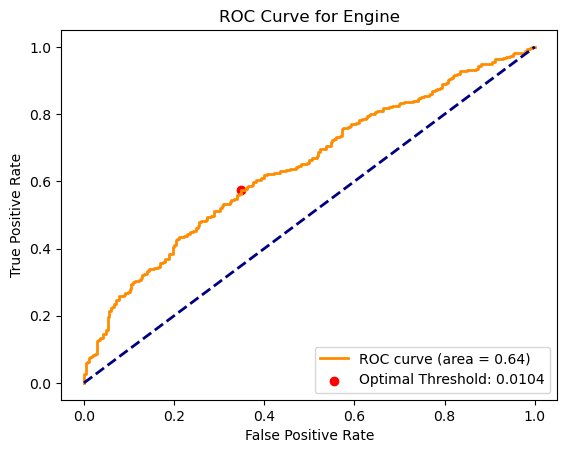

AUROC for Engine: 0.64
Precision: 0.65, Recall: 0.57, F1-Score: 0.61


In [77]:
# Labels de test (0 pour normal, 1 pour défectueux)
labels_engine = np.array(test_categories_W)




# Tracer la courbe ROC et calculer l'AUROC
# Retrieve all metrics
auroc_engine, precision_engine, recall_engine, f1_engine = plot_roc_curve_with_metrics(losses_engine, labels_engine, "Engine")

# Print the metrics individually
print(f"AUROC for Engine: {auroc_engine:.2f}")
print(f"Precision: {precision_engine:.2f}, Recall: {recall_engine:.2f}, F1-Score: {f1_engine:.2f}")


# III - Pretext tasks 2 : inpainting model

La deuxième pretext task que nous nous proposons d'implémenter est la méthode d'inpainting. 

Cette fois, l'encodeur prend en entrée une image dont une région est partiellement masquée, puis génère une représentation latente qui capture l'information contextuelle de l'image. Le décodeur utilise cette représentation latente pour reconstruire la région masquée, ce qui simule l'inpainting.
L'entrainement se fait en appliquant un masque sur une region aléatoire d'une image sans anomalie pour créer l'image d'entrée, ce qui nous permet d'obtenir le couple image masquée / image objectif. 

Lors du déploiement de ce SSL pour la détection d'anomalie, on appliquera un masque aléatoire sur les images collectées. Pour chacune, une présentation latente sera générée par l'encodeur et,à partir de celle-ci, une reconstruction est faite par le décodeur. L'erreur de reconstruction entre ce résultat et l'image de départ permettra de déterminer si l'objet présentait une anomalie ou non.

Avec l'inpainting, le modèle est obligé d’apprendre à interpréter et reconstruire les structures globales et locales de l’image. Lorsqu’une anomalie est présente dans une région à reconstruire, le modèle ne pourra pas la prédire correctement, ce qui se traduira par une erreur de reconstruction élevée.

Pour choisir la taille du masque à appliquer sur chaque jeu de donnée, nous allons entraîner nos modèles avec diverses valeurs. Nous selectionnerons ensuite celle dont la surface sous la courbe ROC sera la plus grande (soit avec laquelle les caractéristiques discriminantes sont le mieux apprises).

In [46]:
# Nouveau Encoder-Decoder pour inpainting et masking
class MaskEncoder(nn.Module):
    def __init__(self, in_channels=3, latent_dim=64):
        super(MaskEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, latent_dim, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(latent_dim),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.encoder(x)


class MaskDecoder(nn.Module):
    def __init__(self, latent_dim=64, out_channels=3):
        super(MaskDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.decoder(x)

In [47]:
# Nouveau modele inpainting 
class InpaintingModel(nn.Module):
    def __init__(self, latent_dim=64, mask_size=24):
        super(InpaintingModel, self).__init__()
        self.encoder = MaskEncoder(latent_dim=latent_dim, in_channels=3)
        self.decoder = MaskDecoder(latent_dim=latent_dim, out_channels=3)
        self.mask_size = mask_size

    def forward(self, x):
        x_masked = self.apply_mask(x)
        z = self.encoder(x_masked)
        reconstructed = self.decoder(z)
        return reconstructed, x_masked

    def apply_mask(self, x):
        masked_x = x.clone()

        for i in range(masked_x.size(0)):
            ul_x = np.random.randint(0, x.size(2) - self.mask_size + 1)
            ul_y = np.random.randint(0, x.size(3) - self.mask_size + 1)
            masked_x[i, :, ul_x:ul_x + self.mask_size, ul_y:ul_y + self.mask_size] = 0

        return masked_x

In [48]:
# Adjusted training function for inpainting and masking
def train_mask_model(model, train_loader, test_loader, criterion, optimizer, device, epochs=10):
    model.to(device)
    for epoch in range(epochs):
        model.train()
        total_train_loss = 0
        for images, _ in train_loader:
            images = images.to(device)
            optimizer.zero_grad()

            outputs, masked_inputs = model(images)
            loss = criterion(outputs, images)  # Compare reconstructed images to originals
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)

        model.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, _ in test_loader:
                images = images.to(device)
                outputs, masked_inputs = model(images)
                val_loss = criterion(outputs, images)
                total_val_loss += val_loss.item()

        avg_val_loss = total_val_loss / len(test_loader)

        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}")

    return model

In [49]:
def visualize_masked_reconstructions(model, data_loader, device, num_images=5, mask=1):
    model.eval()
    dataset = list(data_loader.dataset)
    random_indices = random.sample(range(len(dataset)), num_images)
    random_images = [dataset[i][0] for i in random_indices]

    images = torch.stack(random_images).to(device)

    with torch.no_grad():
        reconstructed_images, masked_images = model(images)

    images = images.cpu()
    reconstructed_images = reconstructed_images.cpu()
    masked_images = masked_images.cpu()

    fig, axes = plt.subplots(num_images, 3, figsize=(10, num_images * 4))
    for i in range(num_images):
        # Masked input
        axes[i, 0].imshow(masked_images[i].permute(1, 2, 0))
        axes[i, 0].set_title("Masked Input")
        axes[i, 0].axis('off')

        # Original image
        axes[i, 1].imshow(images[i].permute(1, 2, 0))
        axes[i, 1].set_title("Original Image")
        axes[i, 1].axis('off')

        # Reconstructed image
        axes[i, 2].imshow(reconstructed_images[i].permute(1, 2, 0))
        axes[i, 2].set_title("Reconstructed Image")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

#### Bottle

Epoch 1/10, Train Loss: 0.0853, Validation Loss: 0.1017
Epoch 2/10, Train Loss: 0.0199, Validation Loss: 0.0262
Epoch 3/10, Train Loss: 0.0102, Validation Loss: 0.0151
Epoch 4/10, Train Loss: 0.0067, Validation Loss: 0.0120
Epoch 5/10, Train Loss: 0.0051, Validation Loss: 0.0102
Epoch 6/10, Train Loss: 0.0042, Validation Loss: 0.0080
Epoch 7/10, Train Loss: 0.0037, Validation Loss: 0.0057
Epoch 8/10, Train Loss: 0.0033, Validation Loss: 0.0048
Epoch 9/10, Train Loss: 0.0030, Validation Loss: 0.0043
Epoch 10/10, Train Loss: 0.0028, Validation Loss: 0.0040
Optimal Threshold: 0.003611994441598654

Classification Report for Bottle:
              precision    recall  f1-score   support

      Normal       0.45      0.90      0.60        20
   Anomalous       0.95      0.65      0.77        63

    accuracy                           0.71        83
   macro avg       0.70      0.78      0.69        83
weighted avg       0.83      0.71      0.73        83

Precision: 0.95
Recall: 0.65
F1-Score

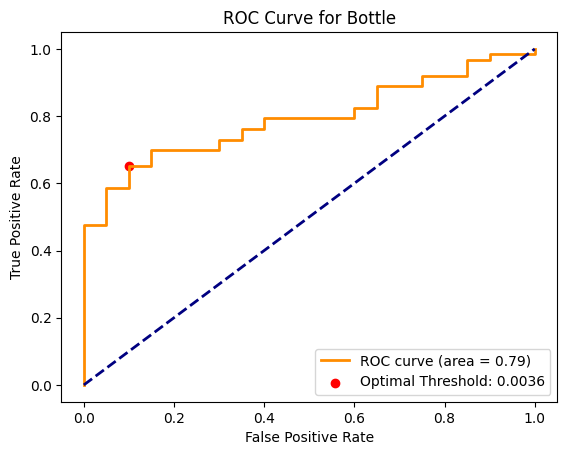

AUROC for Bottle: 0.79
Precision: 0.95, Recall: 0.65, F1-Score: 0.77
Epoch 1/10, Train Loss: 0.0793, Validation Loss: 0.0977
Epoch 2/10, Train Loss: 0.0175, Validation Loss: 0.0410
Epoch 3/10, Train Loss: 0.0095, Validation Loss: 0.0374
Epoch 4/10, Train Loss: 0.0064, Validation Loss: 0.0256
Epoch 5/10, Train Loss: 0.0050, Validation Loss: 0.0131
Epoch 6/10, Train Loss: 0.0042, Validation Loss: 0.0089
Epoch 7/10, Train Loss: 0.0036, Validation Loss: 0.0065
Epoch 8/10, Train Loss: 0.0033, Validation Loss: 0.0055
Epoch 9/10, Train Loss: 0.0030, Validation Loss: 0.0041
Epoch 10/10, Train Loss: 0.0028, Validation Loss: 0.0037
Optimal Threshold: 0.0032734328415244818

Classification Report for Bottle:
              precision    recall  f1-score   support

      Normal       0.45      0.90      0.60        20
   Anomalous       0.95      0.65      0.77        63

    accuracy                           0.71        83
   macro avg       0.70      0.78      0.69        83
weighted avg       0.8

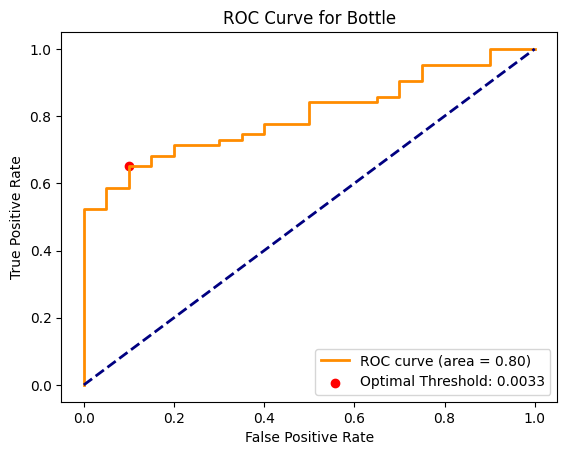

AUROC for Bottle: 0.80
Precision: 0.95, Recall: 0.65, F1-Score: 0.77
Epoch 1/10, Train Loss: 0.0831, Validation Loss: 0.0966
Epoch 2/10, Train Loss: 0.0199, Validation Loss: 0.0454
Epoch 3/10, Train Loss: 0.0105, Validation Loss: 0.0318
Epoch 4/10, Train Loss: 0.0074, Validation Loss: 0.0373
Epoch 5/10, Train Loss: 0.0056, Validation Loss: 0.0304
Epoch 6/10, Train Loss: 0.0044, Validation Loss: 0.0162
Epoch 7/10, Train Loss: 0.0038, Validation Loss: 0.0078
Epoch 8/10, Train Loss: 0.0034, Validation Loss: 0.0053
Epoch 9/10, Train Loss: 0.0031, Validation Loss: 0.0051
Epoch 10/10, Train Loss: 0.0029, Validation Loss: 0.0051
Optimal Threshold: 0.004634773824363947

Classification Report for Bottle:
              precision    recall  f1-score   support

      Normal       0.50      0.85      0.63        20
   Anomalous       0.94      0.73      0.82        63

    accuracy                           0.76        83
   macro avg       0.72      0.79      0.73        83
weighted avg       0.83

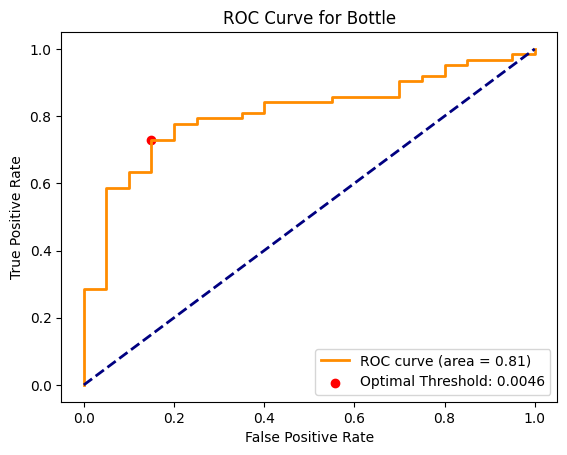

AUROC for Bottle: 0.81
Precision: 0.94, Recall: 0.73, F1-Score: 0.82


In [59]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

for mask_size in [8, 16, 24]:
    inpainting_model_bottle = InpaintingModel(mask_size=mask_size)
    inpainting_model_bottle = train_mask_model(
        inpainting_model_bottle,
        train_loader_bottle,
        test_loader_bottle,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(inpainting_model_bottle.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
    # Calculate losses and plot ROC
    losses_bottle = calculate_losses(inpainting_model_bottle, test_loader_bottle, criterion, device)
    labels_bottle = np.array(test_categories_B)
    
    # Retrieve all metrics
    auroc_inpainting_bottle, precision_bottle, recall_bottle, f1_bottle = plot_roc_curve_with_metrics(losses_bottle, labels_bottle, "Bottle")
    
    # Print the metrics individually
    print(f"AUROC for Bottle: {auroc_inpainting_bottle:.2f}")
    print(f"Precision: {precision_bottle:.2f}, Recall: {recall_bottle:.2f}, F1-Score: {f1_bottle:.2f}")


Epoch 1/10, Train Loss: 0.1066, Validation Loss: 0.1129
Epoch 2/10, Train Loss: 0.0310, Validation Loss: 0.0504
Epoch 3/10, Train Loss: 0.0130, Validation Loss: 0.0255
Epoch 4/10, Train Loss: 0.0089, Validation Loss: 0.0417
Epoch 5/10, Train Loss: 0.0065, Validation Loss: 0.0338
Epoch 6/10, Train Loss: 0.0051, Validation Loss: 0.0171
Epoch 7/10, Train Loss: 0.0043, Validation Loss: 0.0086
Epoch 8/10, Train Loss: 0.0038, Validation Loss: 0.0066
Epoch 9/10, Train Loss: 0.0034, Validation Loss: 0.0053
Epoch 10/10, Train Loss: 0.0031, Validation Loss: 0.0048
Optimal Threshold: 0.004592608194798231

Classification Report for Bottle:
              precision    recall  f1-score   support

      Normal       0.40      0.95      0.56        20
   Anomalous       0.97      0.54      0.69        63

    accuracy                           0.64        83
   macro avg       0.68      0.74      0.63        83
weighted avg       0.83      0.64      0.66        83

Precision: 0.97
Recall: 0.54
F1-Score

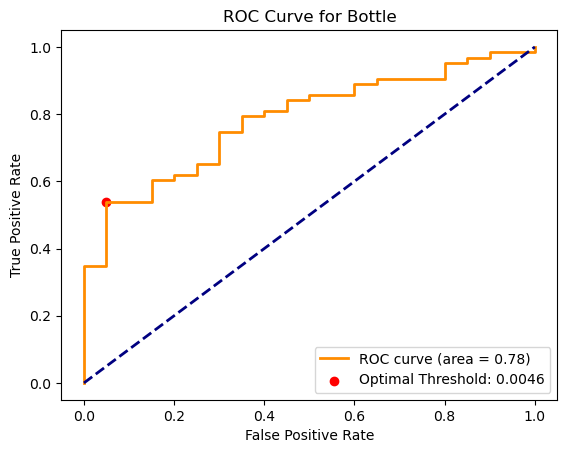

AUROC for Bottle: 0.78
Precision: 0.97, Recall: 0.54, F1-Score: 0.69


In [78]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Initialize and train the model
inpainting_model_bottle = InpaintingModel(mask_size= 24) # on prend le meilleur masque
inpainting_model_bottle = train_mask_model(
    inpainting_model_bottle,
    train_loader_bottle,
    test_loader_bottle,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(inpainting_model_bottle.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_bottle = calculate_losses(inpainting_model_bottle, test_loader_bottle, criterion, device)
labels_bottle = np.array(test_categories_B)

# Retrieve all metrics
auroc_inpainting_bottle, precision_bottle, recall_bottle, f1_bottle = plot_roc_curve_with_metrics(losses_bottle, labels_bottle, "Bottle")

# Print the metrics individually
print(f"AUROC for Bottle: {auroc_inpainting_bottle:.2f}")
print(f"Precision: {precision_bottle:.2f}, Recall: {recall_bottle:.2f}, F1-Score: {f1_bottle:.2f}")

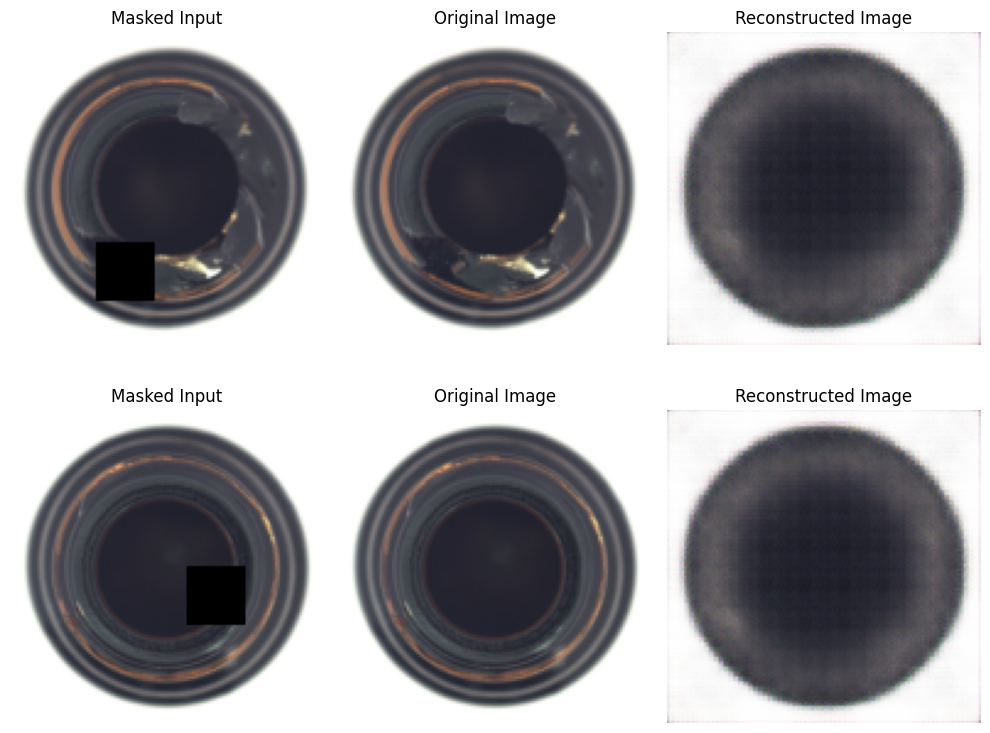

In [62]:
visualize_masked_reconstructions(inpainting_model_bottle, test_loader_bottle, device=device, num_images=2)

#### Hazelnut

Epoch 1/10, Train Loss: 0.0717, Validation Loss: 0.0287
Epoch 2/10, Train Loss: 0.0228, Validation Loss: 0.0110
Epoch 3/10, Train Loss: 0.0111, Validation Loss: 0.0089
Epoch 4/10, Train Loss: 0.0062, Validation Loss: 0.0064
Epoch 5/10, Train Loss: 0.0036, Validation Loss: 0.0038
Epoch 6/10, Train Loss: 0.0026, Validation Loss: 0.0028
Epoch 7/10, Train Loss: 0.0020, Validation Loss: 0.0024
Epoch 8/10, Train Loss: 0.0016, Validation Loss: 0.0021
Epoch 9/10, Train Loss: 0.0014, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0012, Validation Loss: 0.0019
Optimal Threshold: 0.0014225998893380165

Classification Report for Hazelnut:
              precision    recall  f1-score   support

      Normal       0.61      0.93      0.73        40
   Anomalous       0.94      0.66      0.77        70

    accuracy                           0.75       110
   macro avg       0.77      0.79      0.75       110
weighted avg       0.82      0.75      0.76       110

Precision: 0.94
Recall: 0.66
F1-Sc

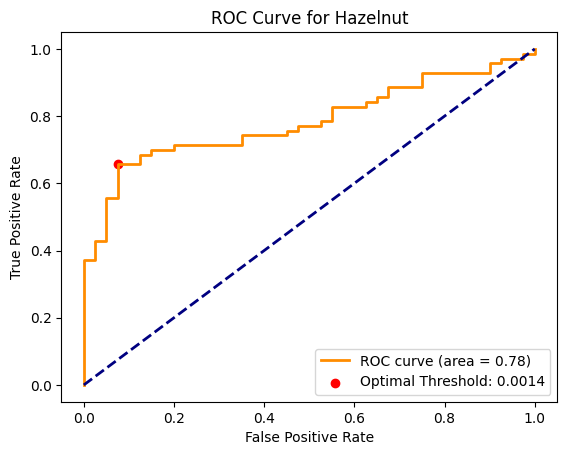

AUROC for Hazelnut: 0.78
Precision: 0.94, Recall: 0.66, F1-Score: 0.77
Epoch 1/10, Train Loss: 0.0376, Validation Loss: 0.0122
Epoch 2/10, Train Loss: 0.0045, Validation Loss: 0.0052
Epoch 3/10, Train Loss: 0.0027, Validation Loss: 0.0042
Epoch 4/10, Train Loss: 0.0018, Validation Loss: 0.0038
Epoch 5/10, Train Loss: 0.0014, Validation Loss: 0.0028
Epoch 6/10, Train Loss: 0.0012, Validation Loss: 0.0024
Epoch 7/10, Train Loss: 0.0010, Validation Loss: 0.0017
Epoch 8/10, Train Loss: 0.0009, Validation Loss: 0.0015
Epoch 9/10, Train Loss: 0.0008, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0008, Validation Loss: 0.0017
Optimal Threshold: 0.0015092933317646384

Classification Report for Hazelnut:
              precision    recall  f1-score   support

      Normal       0.52      0.95      0.67        40
   Anomalous       0.95      0.50      0.65        70

    accuracy                           0.66       110
   macro avg       0.73      0.72      0.66       110
weighted avg      

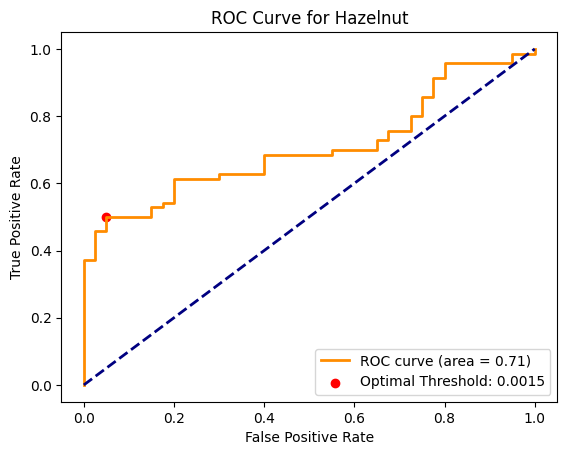

AUROC for Hazelnut: 0.71
Precision: 0.95, Recall: 0.50, F1-Score: 0.65
Epoch 1/10, Train Loss: 0.0649, Validation Loss: 0.0277
Epoch 2/10, Train Loss: 0.0124, Validation Loss: 0.0074
Epoch 3/10, Train Loss: 0.0047, Validation Loss: 0.0049
Epoch 4/10, Train Loss: 0.0031, Validation Loss: 0.0042
Epoch 5/10, Train Loss: 0.0022, Validation Loss: 0.0040
Epoch 6/10, Train Loss: 0.0017, Validation Loss: 0.0033
Epoch 7/10, Train Loss: 0.0015, Validation Loss: 0.0021
Epoch 8/10, Train Loss: 0.0013, Validation Loss: 0.0020
Epoch 9/10, Train Loss: 0.0012, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0011, Validation Loss: 0.0018
Optimal Threshold: 0.0015485479962080717

Classification Report for Hazelnut:
              precision    recall  f1-score   support

      Normal       0.50      0.95      0.66        40
   Anomalous       0.94      0.46      0.62        70

    accuracy                           0.64       110
   macro avg       0.72      0.70      0.64       110
weighted avg      

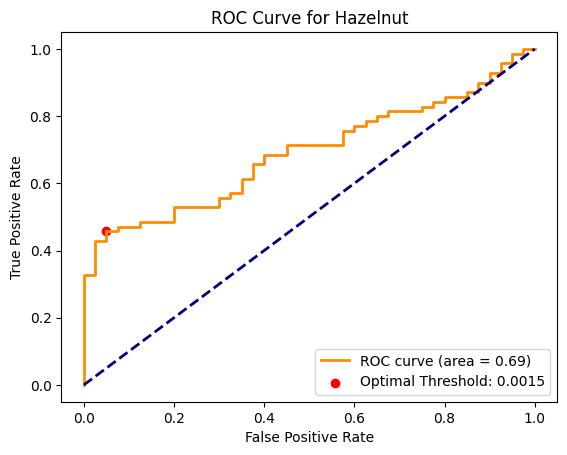

AUROC for Hazelnut: 0.69
Precision: 0.94, Recall: 0.46, F1-Score: 0.62


In [63]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

for mask_size in [8, 16, 24]:
    inpainting_model_hazelnut = InpaintingModel(mask_size=mask_size)
    inpainting_model_hazelnut = train_mask_model(
        inpainting_model_hazelnut,
        train_loader_hazelnut,
        test_loader_hazelnut,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(inpainting_model_hazelnut.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
    # Calculate losses and plot ROC
    losses_hazelnut = calculate_losses(inpainting_model_hazelnut, test_loader_hazelnut, criterion, device)
    labels_hazelnut = np.array(test_categories_H)
    
    # Retrieve all metrics
    auroc_inpainting_hazelnut, precision_h, recall_h, f1_h = plot_roc_curve_with_metrics(losses_hazelnut, labels_hazelnut, "Hazelnut")
    
    # Print the metrics individually
    print(f"AUROC for Hazelnut: {auroc_inpainting_hazelnut:.2f}")
    print(f"Precision: {precision_h:.2f}, Recall: {recall_h:.2f}, F1-Score: {f1_h:.2f}")


Epoch 1/10, Train Loss: 0.0711, Validation Loss: 0.0290
Epoch 2/10, Train Loss: 0.0175, Validation Loss: 0.0087
Epoch 3/10, Train Loss: 0.0092, Validation Loss: 0.0077
Epoch 4/10, Train Loss: 0.0056, Validation Loss: 0.0051
Epoch 5/10, Train Loss: 0.0029, Validation Loss: 0.0038
Epoch 6/10, Train Loss: 0.0020, Validation Loss: 0.0025
Epoch 7/10, Train Loss: 0.0017, Validation Loss: 0.0022
Epoch 8/10, Train Loss: 0.0014, Validation Loss: 0.0020
Epoch 9/10, Train Loss: 0.0013, Validation Loss: 0.0020
Epoch 10/10, Train Loss: 0.0012, Validation Loss: 0.0017
Optimal Threshold: 0.001393945887684822

Classification Report for Hazelnut:
              precision    recall  f1-score   support

      Normal       0.54      0.93      0.68        40
   Anomalous       0.93      0.54      0.68        70

    accuracy                           0.68       110
   macro avg       0.73      0.73      0.68       110
weighted avg       0.78      0.68      0.68       110

Precision: 0.93
Recall: 0.54
F1-Sco

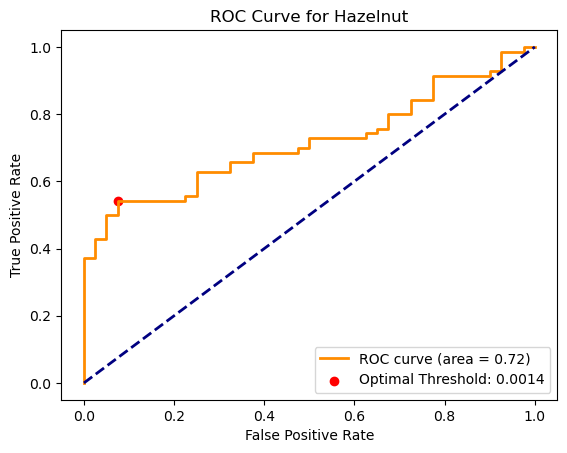

AUROC for Hazelnut: 0.72
Precision: 0.93, Recall: 0.54, F1-Score: 0.68


In [79]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Initialize and train the model
inpainting_model_hazelnut = InpaintingModel(mask_size=8) # on prend le meilleur mask pour visualiser 
inpainting_model_hazelnut = train_mask_model(
    inpainting_model_hazelnut,
    train_loader_hazelnut,
    test_loader_hazelnut,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(inpainting_model_hazelnut.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_hazelnut = calculate_losses(inpainting_model_hazelnut, test_loader_hazelnut, criterion, device)
labels_hazelnut = np.array(test_categories_H)

# Retrieve all metrics
auroc_inpainting_hazelnut, precision_h, recall_h, f1_h = plot_roc_curve_with_metrics(losses_hazelnut, labels_hazelnut, "Hazelnut")

# Print the metrics individually
print(f"AUROC for Hazelnut: {auroc_inpainting_hazelnut:.2f}")
print(f"Precision: {precision_h:.2f}, Recall: {recall_h:.2f}, F1-Score: {f1_h:.2f}")

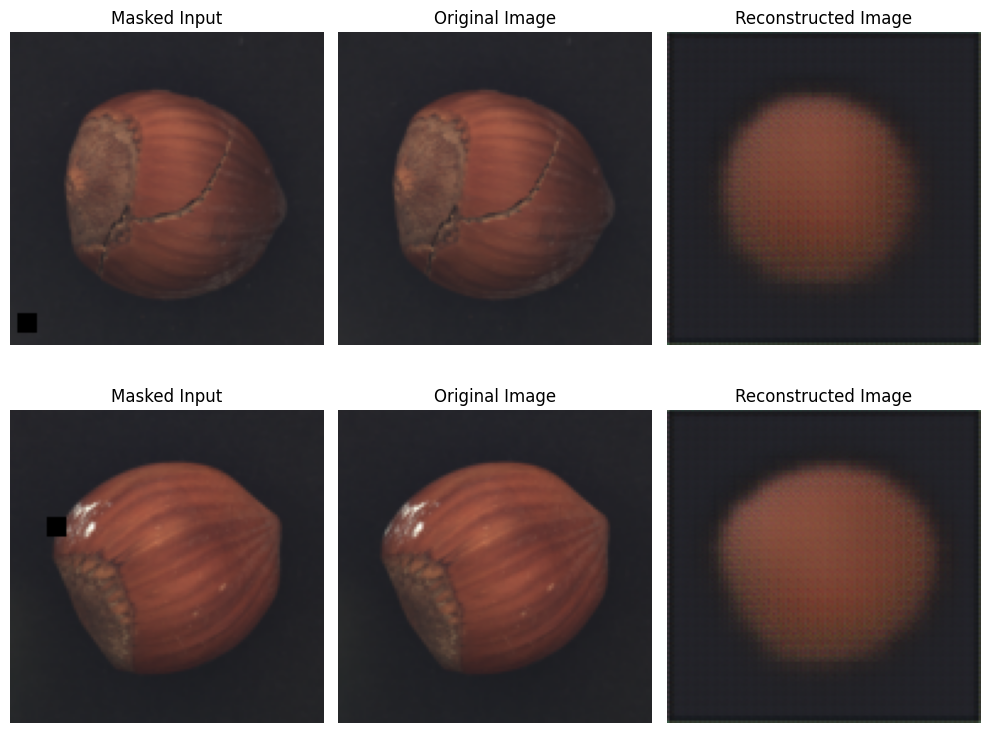

In [65]:
visualize_masked_reconstructions(inpainting_model_hazelnut, test_loader_hazelnut, device=device, num_images=2)

#### Capsule

Epoch 1/10, Train Loss: 0.0454, Validation Loss: 0.0658
Epoch 2/10, Train Loss: 0.0084, Validation Loss: 0.0430
Epoch 3/10, Train Loss: 0.0045, Validation Loss: 0.0191
Epoch 4/10, Train Loss: 0.0034, Validation Loss: 0.0087
Epoch 5/10, Train Loss: 0.0027, Validation Loss: 0.0055
Epoch 6/10, Train Loss: 0.0022, Validation Loss: 0.0033
Epoch 7/10, Train Loss: 0.0019, Validation Loss: 0.0028
Epoch 8/10, Train Loss: 0.0016, Validation Loss: 0.0022
Epoch 9/10, Train Loss: 0.0014, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0012, Validation Loss: 0.0018
Optimal Threshold: 0.0014962273417040706

Classification Report for Capsule:
              precision    recall  f1-score   support

      Normal       0.43      0.39      0.41        23
   Anomalous       0.87      0.89      0.88       109

    accuracy                           0.80       132
   macro avg       0.65      0.64      0.65       132
weighted avg       0.80      0.80      0.80       132

Precision: 0.87
Recall: 0.89
F1-Sco

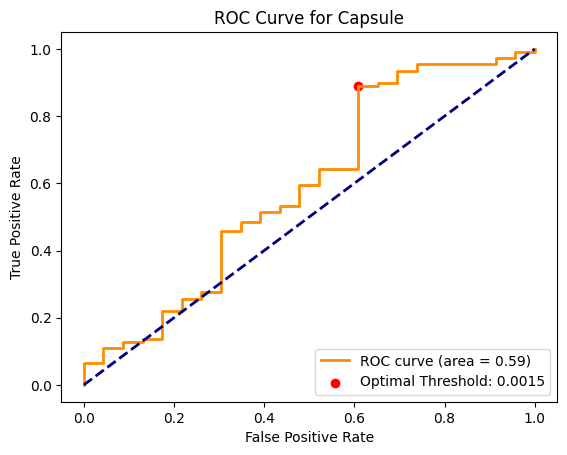

AUROC for Capsule: 0.59
Precision: 0.87, Recall: 0.89, F1-Score: 0.88
Epoch 1/10, Train Loss: 0.0523, Validation Loss: 0.0672
Epoch 2/10, Train Loss: 0.0129, Validation Loss: 0.0124
Epoch 3/10, Train Loss: 0.0063, Validation Loss: 0.0065
Epoch 4/10, Train Loss: 0.0043, Validation Loss: 0.0103
Epoch 5/10, Train Loss: 0.0036, Validation Loss: 0.0090
Epoch 6/10, Train Loss: 0.0029, Validation Loss: 0.0068
Epoch 7/10, Train Loss: 0.0024, Validation Loss: 0.0034
Epoch 8/10, Train Loss: 0.0020, Validation Loss: 0.0021
Epoch 9/10, Train Loss: 0.0017, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0015, Validation Loss: 0.0018
Optimal Threshold: 0.002099919132888317

Classification Report for Capsule:
              precision    recall  f1-score   support

      Normal       0.19      0.91      0.31        23
   Anomalous       0.89      0.16      0.27       109

    accuracy                           0.29       132
   macro avg       0.54      0.53      0.29       132
weighted avg       0.

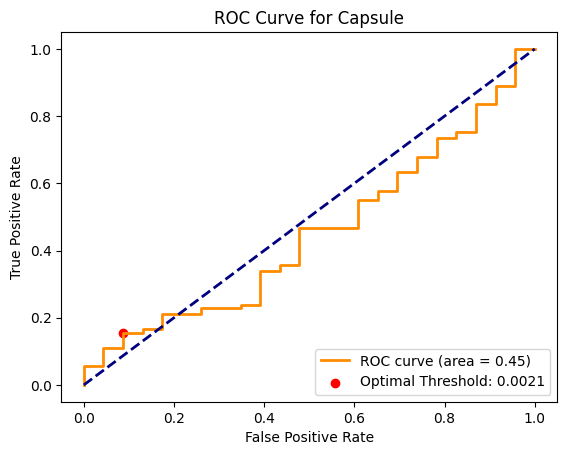

AUROC for Capsule: 0.45
Precision: 0.89, Recall: 0.16, F1-Score: 0.27
Epoch 1/10, Train Loss: 0.0494, Validation Loss: 0.0657
Epoch 2/10, Train Loss: 0.0115, Validation Loss: 0.0116
Epoch 3/10, Train Loss: 0.0060, Validation Loss: 0.0191
Epoch 4/10, Train Loss: 0.0043, Validation Loss: 0.0196
Epoch 5/10, Train Loss: 0.0034, Validation Loss: 0.0119
Epoch 6/10, Train Loss: 0.0028, Validation Loss: 0.0099
Epoch 7/10, Train Loss: 0.0025, Validation Loss: 0.0055
Epoch 8/10, Train Loss: 0.0021, Validation Loss: 0.0029
Epoch 9/10, Train Loss: 0.0018, Validation Loss: 0.0020
Epoch 10/10, Train Loss: 0.0016, Validation Loss: 0.0018
Optimal Threshold: 0.0021991014946252108

Classification Report for Capsule:
              precision    recall  f1-score   support

      Normal       0.19      0.96      0.32        23
   Anomalous       0.94      0.14      0.24       109

    accuracy                           0.28       132
   macro avg       0.56      0.55      0.28       132
weighted avg       0

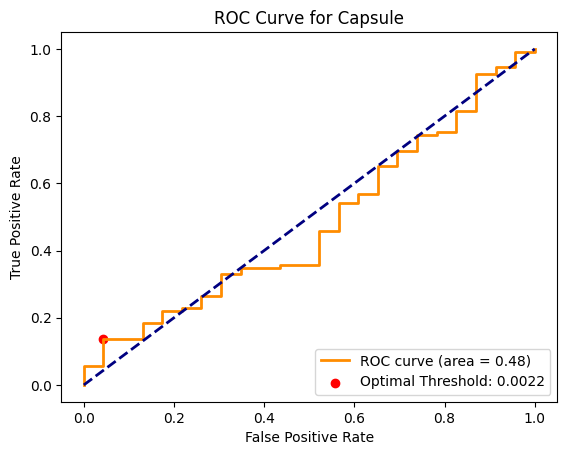

AUROC for Capsule: 0.48
Precision: 0.94, Recall: 0.14, F1-Score: 0.24


In [66]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

for mask_size in [8, 16, 24]:
    inpainting_model_capsule = InpaintingModel(mask_size=mask_size)
    inpainting_model_capsule = train_mask_model(
        inpainting_model_capsule,
        train_loader_capsule,
        test_loader_capsule,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(inpainting_model_capsule.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
    # Calculate losses and plot ROC
    losses_capsule = calculate_losses(inpainting_model_capsule, test_loader_capsule, criterion, device)
    labels_capsule = np.array(test_categories_C)
    
    # Retrieve all metrics
    auroc_inpainting_capsule, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(losses_capsule, labels_capsule, "Capsule")
    
    # Print the metrics individually
    print(f"AUROC for Capsule: {auroc_inpainting_capsule:.2f}")
    print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")


Epoch 1/10, Train Loss: 0.0563, Validation Loss: 0.0711
Epoch 2/10, Train Loss: 0.0124, Validation Loss: 0.0313
Epoch 3/10, Train Loss: 0.0058, Validation Loss: 0.0123
Epoch 4/10, Train Loss: 0.0043, Validation Loss: 0.0062
Epoch 5/10, Train Loss: 0.0035, Validation Loss: 0.0050
Epoch 6/10, Train Loss: 0.0028, Validation Loss: 0.0035
Epoch 7/10, Train Loss: 0.0023, Validation Loss: 0.0026
Epoch 8/10, Train Loss: 0.0019, Validation Loss: 0.0025
Epoch 9/10, Train Loss: 0.0016, Validation Loss: 0.0026
Epoch 10/10, Train Loss: 0.0014, Validation Loss: 0.0026
Optimal Threshold: 0.002416877308860421

Classification Report for Capsule:
              precision    recall  f1-score   support

      Normal       0.28      0.70      0.40        23
   Anomalous       0.91      0.61      0.73       109

    accuracy                           0.63       132
   macro avg       0.59      0.66      0.56       132
weighted avg       0.80      0.63      0.67       132

Precision: 0.91
Recall: 0.61
F1-Scor

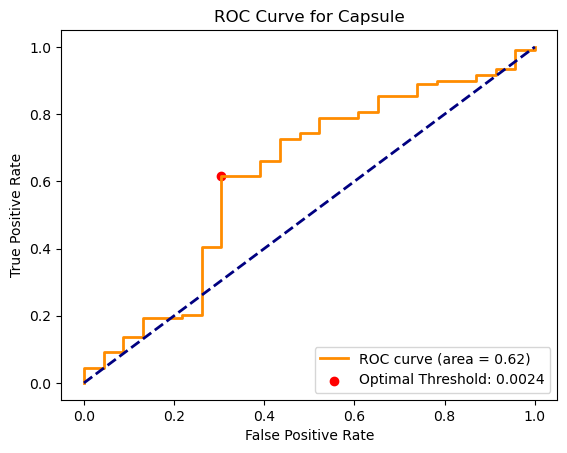

AUROC for Capsule: 0.62
Precision: 0.91, Recall: 0.61, F1-Score: 0.73


In [80]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

inpainting_model_capsule = InpaintingModel(mask_size=8) # on prend le meilleur mask pour visualiser 
inpainting_model_capsule = train_mask_model(
    inpainting_model_capsule,
    train_loader_capsule,
    test_loader_capsule,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(inpainting_model_capsule.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_capsule = calculate_losses(inpainting_model_capsule, test_loader_capsule, criterion, device)
labels_capsule = np.array(test_categories_C)

# Retrieve all metrics
auroc_inpainting_capsule, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(losses_capsule, labels_capsule, "Capsule")

# Print the metrics individually
print(f"AUROC for Capsule: {auroc_inpainting_capsule:.2f}")
print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")

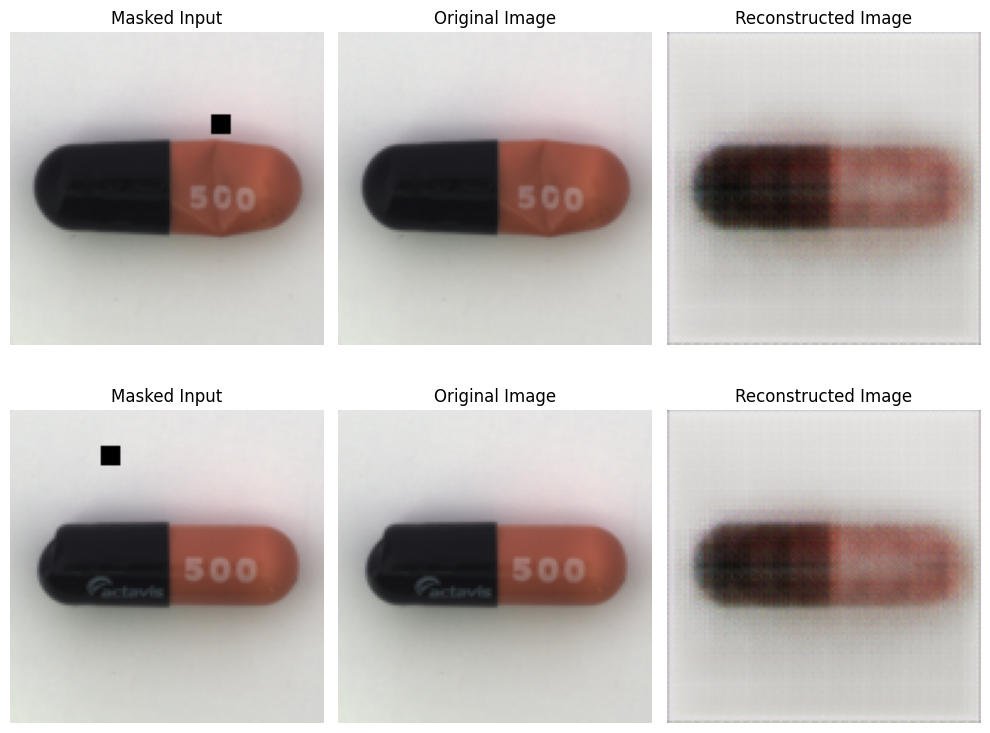

In [68]:
visualize_masked_reconstructions(inpainting_model_capsule, test_loader_capsule, device=device, num_images=2)

#### Toothbrush

Epoch 1/10, Train Loss: 0.1479, Validation Loss: 0.1269
Epoch 2/10, Train Loss: 0.0888, Validation Loss: 0.1146
Epoch 3/10, Train Loss: 0.0663, Validation Loss: 0.0980
Epoch 4/10, Train Loss: 0.0512, Validation Loss: 0.0737
Epoch 5/10, Train Loss: 0.0401, Validation Loss: 0.0508
Epoch 6/10, Train Loss: 0.0322, Validation Loss: 0.0354
Epoch 7/10, Train Loss: 0.0260, Validation Loss: 0.0260
Epoch 8/10, Train Loss: 0.0214, Validation Loss: 0.0204
Epoch 9/10, Train Loss: 0.0183, Validation Loss: 0.0172
Epoch 10/10, Train Loss: 0.0161, Validation Loss: 0.0154
Optimal Threshold: 0.018968291580677032

Classification Report for Toothbrush:
              precision    recall  f1-score   support

      Normal       0.35      1.00      0.52        12
   Anomalous       1.00      0.27      0.42        30

    accuracy                           0.48        42
   macro avg       0.68      0.63      0.47        42
weighted avg       0.82      0.48      0.45        42

Precision: 1.00
Recall: 0.27
F1-S

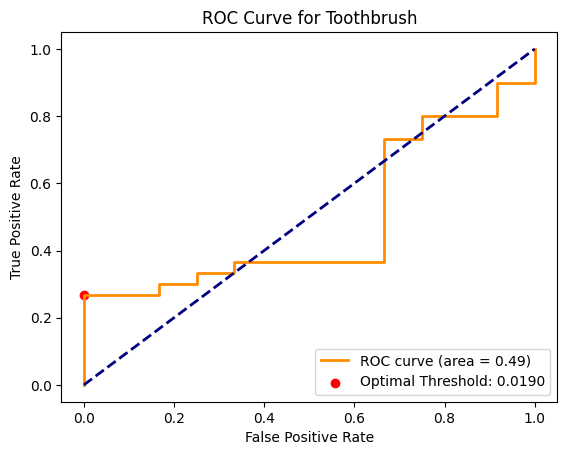

AUROC for Toothbrush: 0.49
Precision: 1.00, Recall: 0.27, F1-Score: 0.42
Epoch 1/10, Train Loss: 0.1501, Validation Loss: 0.1361
Epoch 2/10, Train Loss: 0.0896, Validation Loss: 0.1252
Epoch 3/10, Train Loss: 0.0637, Validation Loss: 0.1062
Epoch 4/10, Train Loss: 0.0469, Validation Loss: 0.0790
Epoch 5/10, Train Loss: 0.0352, Validation Loss: 0.0513
Epoch 6/10, Train Loss: 0.0266, Validation Loss: 0.0327
Epoch 7/10, Train Loss: 0.0206, Validation Loss: 0.0244
Epoch 8/10, Train Loss: 0.0166, Validation Loss: 0.0218
Epoch 9/10, Train Loss: 0.0142, Validation Loss: 0.0211
Epoch 10/10, Train Loss: 0.0127, Validation Loss: 0.0225
Optimal Threshold: 0.01960323005914688

Classification Report for Toothbrush:
              precision    recall  f1-score   support

      Normal       0.33      0.17      0.22        12
   Anomalous       0.72      0.87      0.79        30

    accuracy                           0.67        42
   macro avg       0.53      0.52      0.51        42
weighted avg    

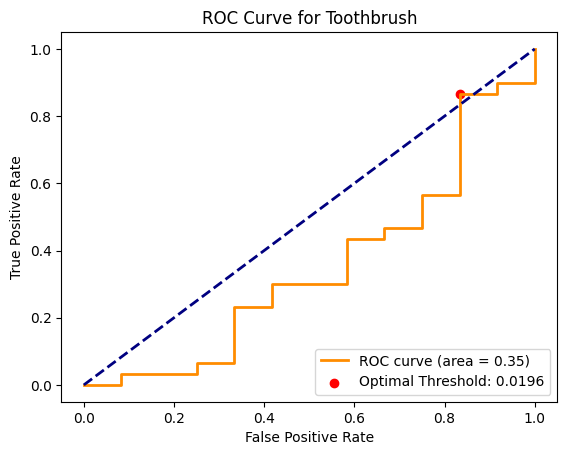

AUROC for Toothbrush: 0.35
Precision: 0.72, Recall: 0.87, F1-Score: 0.79
Epoch 1/10, Train Loss: 0.1757, Validation Loss: 0.1318
Epoch 2/10, Train Loss: 0.1140, Validation Loss: 0.1241
Epoch 3/10, Train Loss: 0.0947, Validation Loss: 0.1105
Epoch 4/10, Train Loss: 0.0790, Validation Loss: 0.0893
Epoch 5/10, Train Loss: 0.0652, Validation Loss: 0.0737
Epoch 6/10, Train Loss: 0.0542, Validation Loss: 0.0618
Epoch 7/10, Train Loss: 0.0452, Validation Loss: 0.0534
Epoch 8/10, Train Loss: 0.0377, Validation Loss: 0.0489
Epoch 9/10, Train Loss: 0.0320, Validation Loss: 0.0471
Epoch 10/10, Train Loss: 0.0273, Validation Loss: 0.0468
Optimal Threshold: 0.05279859900474548

Classification Report for Toothbrush:
              precision    recall  f1-score   support

      Normal       0.29      1.00      0.45        12
   Anomalous       1.00      0.03      0.06        30

    accuracy                           0.31        42
   macro avg       0.65      0.52      0.26        42
weighted avg    

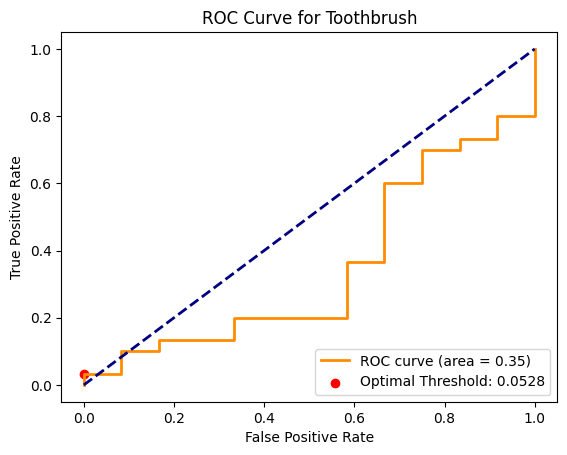

AUROC for Toothbrush: 0.35
Precision: 1.00, Recall: 0.03, F1-Score: 0.06


In [69]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

for mask_size in [8, 16, 24]:
    inpainting_model_toothbrush = InpaintingModel(mask_size=mask_size)
    inpainting_model_toothbrush = train_mask_model(
        inpainting_model_toothbrush,
        train_loader_toothbrush,
        test_loader_toothbrush,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(inpainting_model_toothbrush.parameters(), lr=0.001),
        device=device,
        epochs=10
    )

    # Calculate losses and plot ROC
    losses_toothbrush = calculate_losses(inpainting_model_toothbrush, test_loader_toothbrush, criterion, device)
    labels_toothbrush = np.array(test_categories_T)
    
    # Retrieve all metrics
    auroc_inpainting_toothbrush, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(losses_toothbrush, labels_toothbrush, "Toothbrush")
    
    # Print the metrics individually
    print(f"AUROC for Toothbrush: {auroc_inpainting_toothbrush:.2f}")
    print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")


Epoch 1/10, Train Loss: 0.1649, Validation Loss: 0.1454
Epoch 2/10, Train Loss: 0.1050, Validation Loss: 0.1361
Epoch 3/10, Train Loss: 0.0766, Validation Loss: 0.1148
Epoch 4/10, Train Loss: 0.0568, Validation Loss: 0.0872
Epoch 5/10, Train Loss: 0.0430, Validation Loss: 0.0613
Epoch 6/10, Train Loss: 0.0328, Validation Loss: 0.0408
Epoch 7/10, Train Loss: 0.0255, Validation Loss: 0.0272
Epoch 8/10, Train Loss: 0.0205, Validation Loss: 0.0196
Epoch 9/10, Train Loss: 0.0171, Validation Loss: 0.0155
Epoch 10/10, Train Loss: 0.0147, Validation Loss: 0.0137
Optimal Threshold: 0.01787882298231125

Classification Report for Toothbrush:
              precision    recall  f1-score   support

      Normal       0.34      1.00      0.51        12
   Anomalous       1.00      0.23      0.38        30

    accuracy                           0.45        42
   macro avg       0.67      0.62      0.44        42
weighted avg       0.81      0.45      0.42        42

Precision: 1.00
Recall: 0.23
F1-Sc

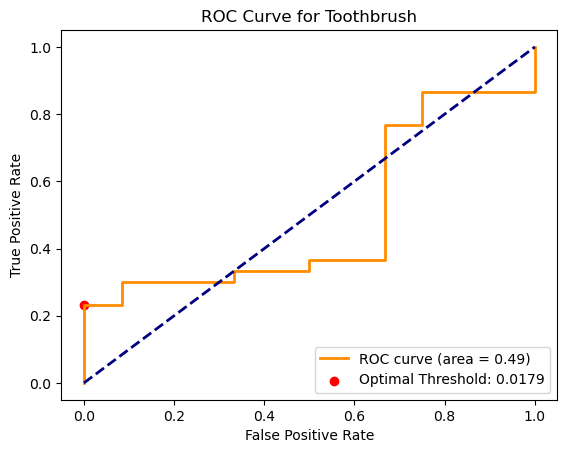

AUROC for Toothbrush: 0.49
Precision: 1.00, Recall: 0.23, F1-Score: 0.38


In [81]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Initialize and train the model
inpainting_model_toothbrush = InpaintingModel(mask_size=8) #on prend le meilleur masque pour visualiser 
inpainting_model_toothbrush = train_mask_model(
    inpainting_model_toothbrush,
    train_loader_toothbrush,
    test_loader_toothbrush,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(inpainting_model_toothbrush.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_toothbrush = calculate_losses(inpainting_model_toothbrush, test_loader_toothbrush, criterion, device)
labels_toothbrush = np.array(test_categories_T)

# Retrieve all metrics
auroc_inpainting_toothbrush, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(losses_toothbrush, labels_toothbrush, "Toothbrush")

# Print the metrics individually
print(f"AUROC for Toothbrush: {auroc_inpainting_toothbrush:.2f}")
print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")

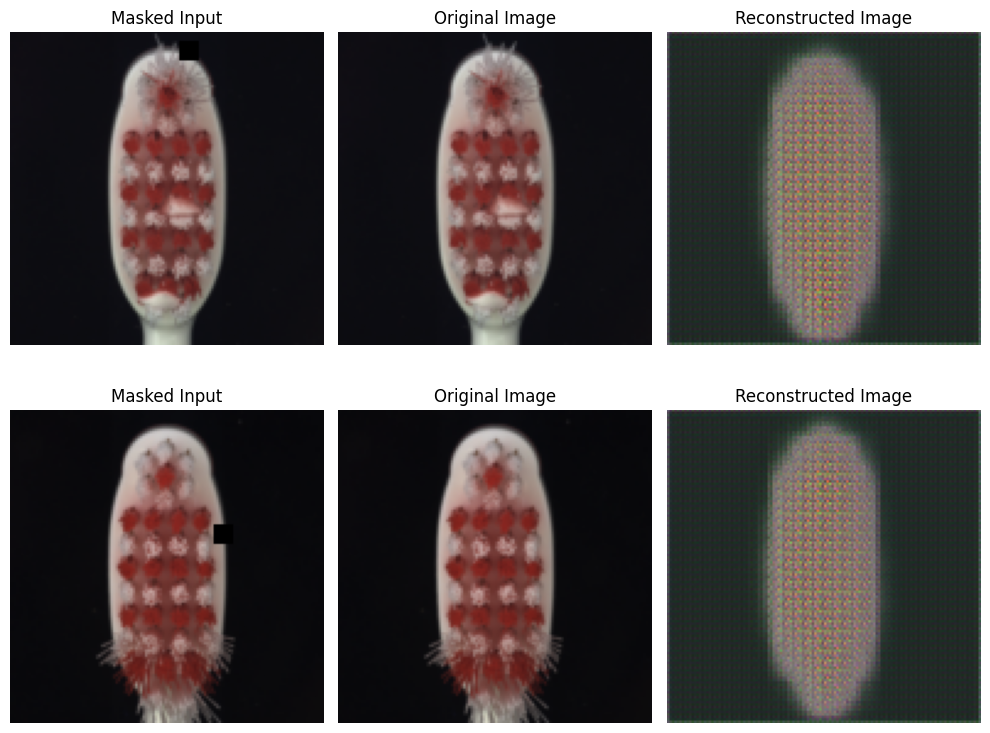

In [71]:
visualize_masked_reconstructions(inpainting_model_toothbrush, test_loader_toothbrush, device=device, num_images=2)

### Sur Auto_VI

Epoch 1/10, Train Loss: 0.0841, Validation Loss: 0.0767
Epoch 2/10, Train Loss: 0.0353, Validation Loss: 0.0454
Epoch 3/10, Train Loss: 0.0258, Validation Loss: 0.0271
Epoch 4/10, Train Loss: 0.0217, Validation Loss: 0.0243
Epoch 5/10, Train Loss: 0.0183, Validation Loss: 0.0295
Epoch 6/10, Train Loss: 0.0156, Validation Loss: 0.0293
Epoch 7/10, Train Loss: 0.0136, Validation Loss: 0.0236
Epoch 8/10, Train Loss: 0.0121, Validation Loss: 0.0221
Epoch 9/10, Train Loss: 0.0110, Validation Loss: 0.0205
Epoch 10/10, Train Loss: 0.0102, Validation Loss: 0.0140
Optimal Threshold: 0.015012403950095177

Classification Report for Engine Wiring:
              precision    recall  f1-score   support

      Normal       0.51      0.87      0.64       285
   Anomalous       0.68      0.25      0.36       322

    accuracy                           0.54       607
   macro avg       0.59      0.56      0.50       607
weighted avg       0.60      0.54      0.49       607

Precision: 0.68
Recall: 0.25
F

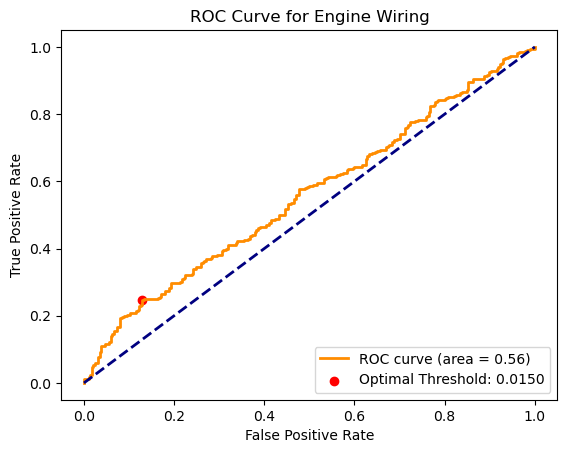

AUROC for Engine Wiring: 0.56
Precision: 0.68, Recall: 0.25, F1-Score: 0.36
Epoch 1/10, Train Loss: 0.0652, Validation Loss: 0.0611
Epoch 2/10, Train Loss: 0.0316, Validation Loss: 0.0433
Epoch 3/10, Train Loss: 0.0252, Validation Loss: 0.0357
Epoch 4/10, Train Loss: 0.0216, Validation Loss: 0.0370
Epoch 5/10, Train Loss: 0.0185, Validation Loss: 0.0419
Epoch 6/10, Train Loss: 0.0158, Validation Loss: 0.0325
Epoch 7/10, Train Loss: 0.0137, Validation Loss: 0.0237
Epoch 8/10, Train Loss: 0.0122, Validation Loss: 0.0157
Epoch 9/10, Train Loss: 0.0110, Validation Loss: 0.0117
Epoch 10/10, Train Loss: 0.0101, Validation Loss: 0.0113
Optimal Threshold: 0.011671042069792747

Classification Report for Engine Wiring:
              precision    recall  f1-score   support

      Normal       0.54      0.74      0.63       285
   Anomalous       0.66      0.45      0.54       322

    accuracy                           0.59       607
   macro avg       0.60      0.60      0.58       607
weighted 

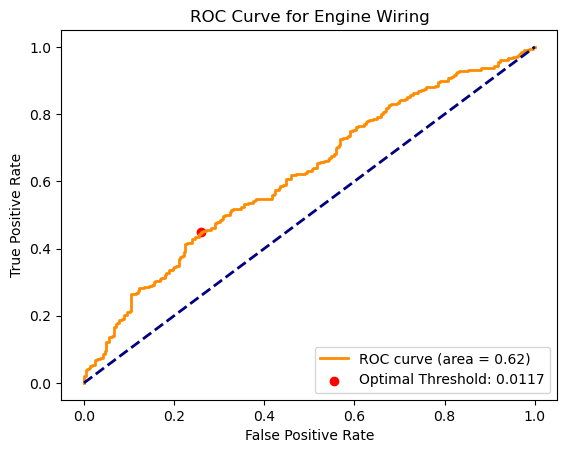

AUROC for Engine Wiring: 0.62
Precision: 0.66, Recall: 0.45, F1-Score: 0.54
Epoch 1/10, Train Loss: 0.0822, Validation Loss: 0.0693
Epoch 2/10, Train Loss: 0.0407, Validation Loss: 0.0857
Epoch 3/10, Train Loss: 0.0290, Validation Loss: 0.0907
Epoch 4/10, Train Loss: 0.0241, Validation Loss: 0.0696
Epoch 5/10, Train Loss: 0.0212, Validation Loss: 0.0414
Epoch 6/10, Train Loss: 0.0188, Validation Loss: 0.0276
Epoch 7/10, Train Loss: 0.0168, Validation Loss: 0.0233
Epoch 8/10, Train Loss: 0.0149, Validation Loss: 0.0232
Epoch 9/10, Train Loss: 0.0134, Validation Loss: 0.0159
Epoch 10/10, Train Loss: 0.0121, Validation Loss: 0.0141
Optimal Threshold: 0.013906650245189667

Classification Report for Engine Wiring:
              precision    recall  f1-score   support

      Normal       0.57      0.62      0.59       285
   Anomalous       0.63      0.58      0.61       322

    accuracy                           0.60       607
   macro avg       0.60      0.60      0.60       607
weighted 

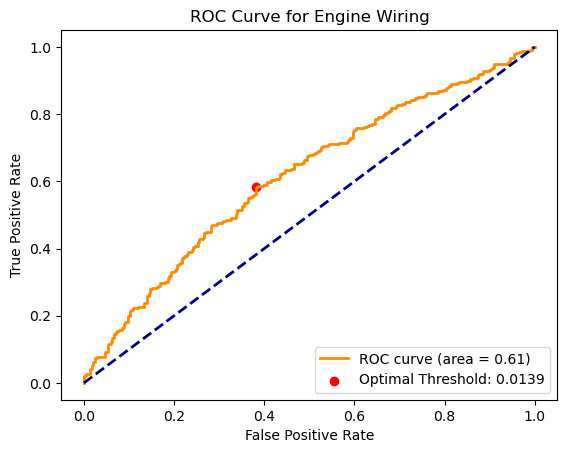

AUROC for Engine Wiring: 0.61
Precision: 0.63, Recall: 0.58, F1-Score: 0.61


In [50]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

for mask_size in [8, 16, 24]:
    inpainting_model_engine = InpaintingModel(mask_size=mask_size)
    inpainting_model_engine = train_mask_model(
        inpainting_model_engine,
        train_loader_engine,
        test_loader_engine,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(inpainting_model_engine.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
    # Calculate losses and plot ROC
    losses_engine = calculate_losses(inpainting_model_engine, test_loader_engine, criterion, device)
    labels_engine = np.array(test_categories_W)
    
    # Retrieve all metrics
    auroc_inpainting_engine, precision_engine, recall_engine, f1_engine = plot_roc_curve_with_metrics(losses_engine, labels_engine, "Engine Wiring")
    
    # Print the metrics individually
    print(f"AUROC for Engine Wiring: {auroc_inpainting_engine:.2f}")
    print(f"Precision: {precision_engine:.2f}, Recall: {recall_engine:.2f}, F1-Score: {f1_engine:.2f}")


Epoch 1/10, Train Loss: 0.0789, Validation Loss: 0.0619
Epoch 2/10, Train Loss: 0.0371, Validation Loss: 0.0386
Epoch 3/10, Train Loss: 0.0272, Validation Loss: 0.0321
Epoch 4/10, Train Loss: 0.0224, Validation Loss: 0.0293
Epoch 5/10, Train Loss: 0.0189, Validation Loss: 0.0306
Epoch 6/10, Train Loss: 0.0163, Validation Loss: 0.0225
Epoch 7/10, Train Loss: 0.0142, Validation Loss: 0.0188
Epoch 8/10, Train Loss: 0.0128, Validation Loss: 0.0163
Epoch 9/10, Train Loss: 0.0116, Validation Loss: 0.0158
Epoch 10/10, Train Loss: 0.0108, Validation Loss: 0.0132
Optimal Threshold: 0.013489564880728722

Classification Report for Engine Wiring:
              precision    recall  f1-score   support

      Normal       0.54      0.75      0.63       285
   Anomalous       0.67      0.44      0.53       322

    accuracy                           0.59       607
   macro avg       0.61      0.60      0.58       607
weighted avg       0.61      0.59      0.58       607

Precision: 0.67
Recall: 0.44
F

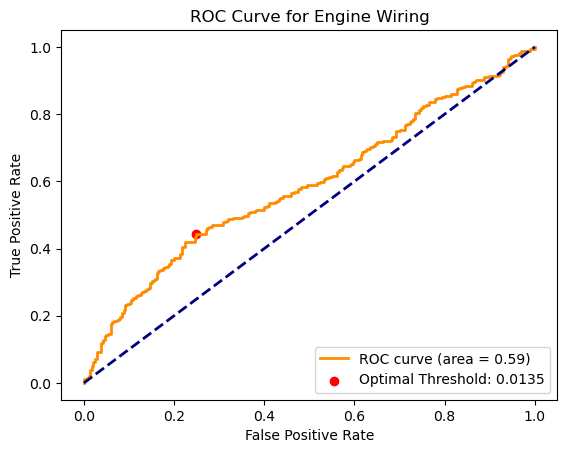

AUROC for Engine Wiring: 0.59
Precision: 0.67, Recall: 0.44, F1-Score: 0.53


In [82]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Initialize and train the model
inpainting_model_engine = InpaintingModel(mask_size=16) #on prend le meilleur masque pour visualiser 
inpainting_model_engine = train_mask_model(
    inpainting_model_engine,
    train_loader_engine,
    test_loader_engine,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(inpainting_model_engine.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_engine = calculate_losses(inpainting_model_engine, test_loader_engine, criterion, device)
labels_engine = np.array(test_categories_W)

# Retrieve all metrics
auroc_inpainting_engine, precision_engine, recall_engine, f1_engine = plot_roc_curve_with_metrics(losses_engine, labels_engine, "Engine Wiring")

# Print the metrics individually
print(f"AUROC for Engine Wiring: {auroc_inpainting_engine:.2f}")
print(f"Precision: {precision_engine:.2f}, Recall: {recall_engine:.2f}, F1-Score: {f1_engine:.2f}")

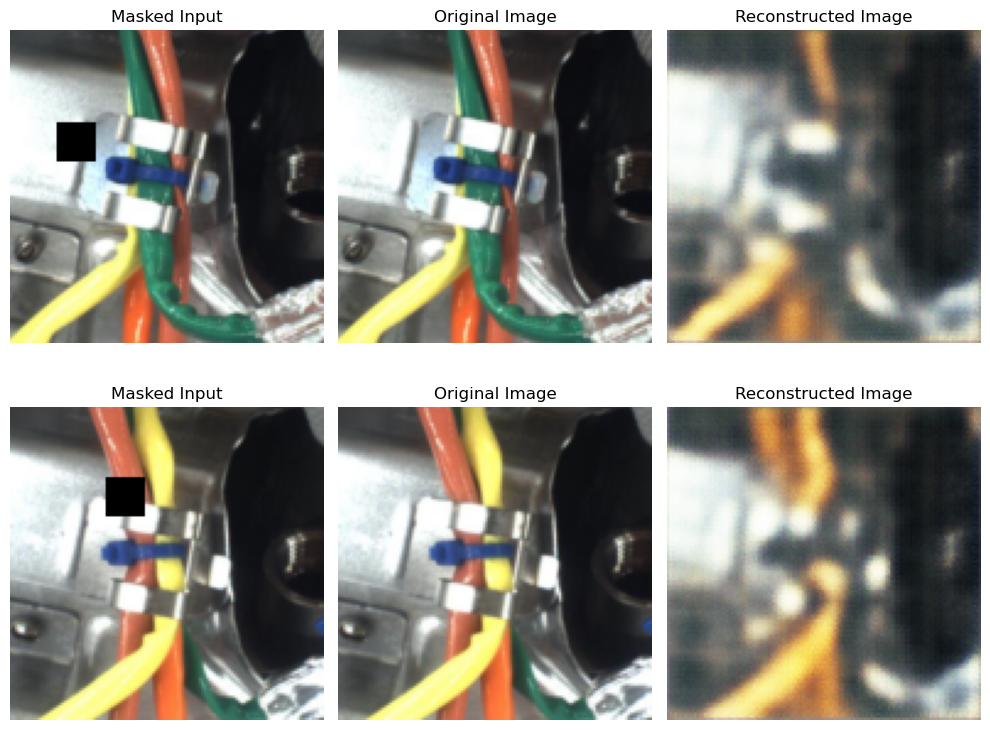

In [53]:
visualize_masked_reconstructions(inpainting_model_engine, test_loader_engine, device=device, num_images=2)

# IV - Pretext tasks 3 : masked autoencoder

Enfin, la dernière pretext task que nous avons considérée est le masking. 

Dans ce cas, l'encodeur génère une représentation latente à partir d'une image dont certains pixels sont masqués. À la différence de l'inpainting, où une seule large région de l'image était masquée, ici, on masquera des pixels séparés et distribués aléatoirement sur toute la surface de l'image. La surface totale masqué sera exprimé comme une proportion du nombre de pixels total de l'image d'entrée. En pratique, lors de la phase de masquage, une portion de l'image est remplacée par des zéros, ce qui crée des "trous" dans l'image que le modèle doit remplir.
L'encodeur traite l'image partiellement masquée pour en extraire une représentation latente, et le décodeur utilise cette information pour reconstruire l'image complète. Comme pour un autoencodeur traditionnel, le modèle apprend à remplir ces parties manquantes de l'image en s'appuyant sur les parties visibles.

Lors du déploiement de ce SSL pour la détection d'anomalie, on masquera la proportion de pixels voulu par le modèle sur les images collectées. Pour chacune, une présentation latente sera générée par l'encodeur et,à partir de celle-ci, une reconstruction est faite par le décodeur. L'erreur de reconstruction entre ce résultat et l'image de départ permettra de déterminer si l'objet présentait une anomalie ou non.

Le modèle apprend donc à extraire des représentations globales et abstraites des images. En présence d’anomalies, la reconstruction des parties manquantes devient incohérente, ce qui permet de détecter ces anomalies. Il est particulièrement efficace sur des anomalies complexes qui affectent plusieurs régions de l’image.

Pour choisir la valeur de la proportion à masquer sur chaque jeu de donnée, nous allons entraîner nos modèles avec diverses valeurs. Nous selectionnerons ensuite celle dont la surface sous la courbe ROC sera la plus grande (soit avec laquelle les caractéristiques discriminantes sont le mieux apprises).


In [54]:
class MaskedAutoencoder(nn.Module):
    def __init__(self, latent_dim=128, mask_ratio=1/16):
        """
        Modèle de Masked Autoencoder avec un ratio de masque par défaut (1/16).
        """
        super(MaskedAutoencoder, self).__init__()
        self.encoder = MaskEncoder(latent_dim=latent_dim, in_channels=3)
        self.decoder = MaskDecoder(latent_dim=latent_dim, out_channels=3)
        self.mask_ratio = mask_ratio

    def forward(self, x):
        """
        Effectue une passe avant avec un ratio de masque spécifié.
        """
        x_masked = self.apply_mask(x)
        z = self.encoder(x_masked)
        reconstructed = self.decoder(z)
        return reconstructed, x_masked

    def apply_mask(self, x):
        """
        Applique un masque aléatoire sur les images selon le ratio de masque.
        """
        x_masked = x.clone()
        mask = torch.rand_like(x[:, 0, :, :]) < self.mask_ratio
        mask = mask.unsqueeze(1).repeat(1, x.size(1), 1, 1)
        x_masked[mask] = 0
        return x_masked


#### Bottle


Training Masked Autoencoder with mask ratio: 0.03
Epoch 1/10, Train Loss: 0.1056, Validation Loss: 0.0982
Epoch 2/10, Train Loss: 0.0290, Validation Loss: 0.0423
Epoch 3/10, Train Loss: 0.0144, Validation Loss: 0.0293
Epoch 4/10, Train Loss: 0.0089, Validation Loss: 0.0195
Epoch 5/10, Train Loss: 0.0065, Validation Loss: 0.0109
Epoch 6/10, Train Loss: 0.0053, Validation Loss: 0.0076
Epoch 7/10, Train Loss: 0.0045, Validation Loss: 0.0061
Epoch 8/10, Train Loss: 0.0039, Validation Loss: 0.0051
Epoch 9/10, Train Loss: 0.0036, Validation Loss: 0.0045
Epoch 10/10, Train Loss: 0.0033, Validation Loss: 0.0042
Optimal Threshold: 0.003999264910817146

Classification Report for Bottle (mask ratio: 0.03):
              precision    recall  f1-score   support

      Normal       0.39      0.95      0.55        20
   Anomalous       0.97      0.52      0.68        63

    accuracy                           0.63        83
   macro avg       0.68      0.74      0.62        83
weighted avg       0.8

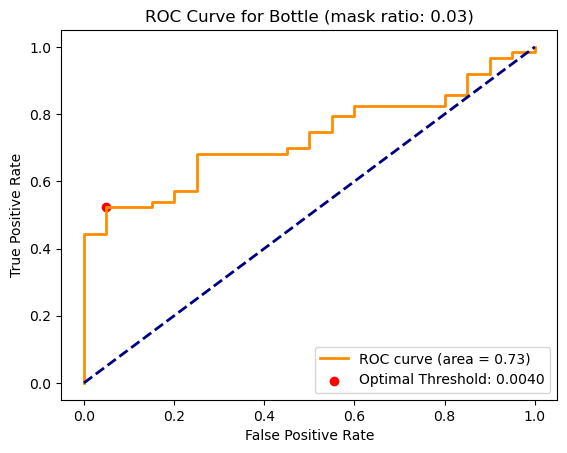

AUROC for Bottle: 0.73
Precision: 0.97, Recall: 0.52, F1-Score: 0.68

Training Masked Autoencoder with mask ratio: 0.06
Epoch 1/10, Train Loss: 0.0894, Validation Loss: 0.0983
Epoch 2/10, Train Loss: 0.0250, Validation Loss: 0.0274
Epoch 3/10, Train Loss: 0.0116, Validation Loss: 0.0099
Epoch 4/10, Train Loss: 0.0083, Validation Loss: 0.0161
Epoch 5/10, Train Loss: 0.0066, Validation Loss: 0.0115
Epoch 6/10, Train Loss: 0.0053, Validation Loss: 0.0089
Epoch 7/10, Train Loss: 0.0043, Validation Loss: 0.0055
Epoch 8/10, Train Loss: 0.0037, Validation Loss: 0.0050
Epoch 9/10, Train Loss: 0.0032, Validation Loss: 0.0043
Epoch 10/10, Train Loss: 0.0029, Validation Loss: 0.0039
Optimal Threshold: 0.004053163342177868

Classification Report for Bottle (mask ratio: 0.06):
              precision    recall  f1-score   support

      Normal       0.37      1.00      0.54        20
   Anomalous       1.00      0.46      0.63        63

    accuracy                           0.59        83
   macr

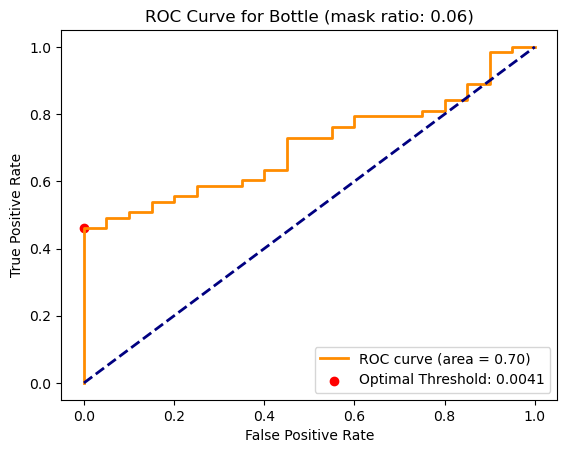

AUROC for Bottle: 0.70
Precision: 1.00, Recall: 0.46, F1-Score: 0.63

Training Masked Autoencoder with mask ratio: 0.12
Epoch 1/10, Train Loss: 0.0946, Validation Loss: 0.0915
Epoch 2/10, Train Loss: 0.0240, Validation Loss: 0.0170
Epoch 3/10, Train Loss: 0.0123, Validation Loss: 0.0151
Epoch 4/10, Train Loss: 0.0079, Validation Loss: 0.0195
Epoch 5/10, Train Loss: 0.0059, Validation Loss: 0.0091
Epoch 6/10, Train Loss: 0.0047, Validation Loss: 0.0062
Epoch 7/10, Train Loss: 0.0040, Validation Loss: 0.0052
Epoch 8/10, Train Loss: 0.0035, Validation Loss: 0.0051
Epoch 9/10, Train Loss: 0.0032, Validation Loss: 0.0042
Epoch 10/10, Train Loss: 0.0029, Validation Loss: 0.0038
Optimal Threshold: 0.003930804319679737

Classification Report for Bottle (mask ratio: 0.12):
              precision    recall  f1-score   support

      Normal       0.36      1.00      0.53        20
   Anomalous       1.00      0.44      0.62        63

    accuracy                           0.58        83
   macr

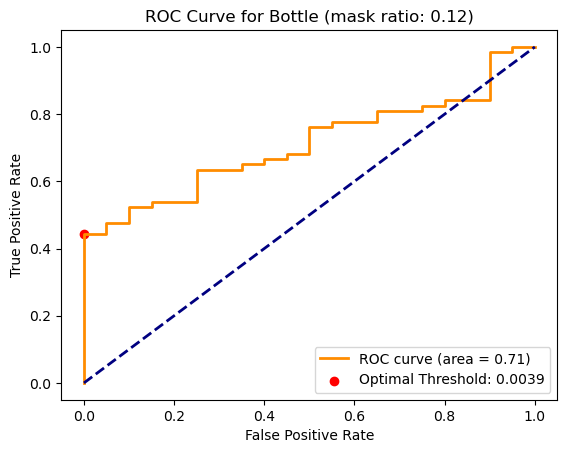

AUROC for Bottle: 0.71
Precision: 1.00, Recall: 0.44, F1-Score: 0.62

Training Masked Autoencoder with mask ratio: 0.25
Epoch 1/10, Train Loss: 0.0874, Validation Loss: 0.0954
Epoch 2/10, Train Loss: 0.0235, Validation Loss: 0.0729
Epoch 3/10, Train Loss: 0.0114, Validation Loss: 0.0462
Epoch 4/10, Train Loss: 0.0078, Validation Loss: 0.0337
Epoch 5/10, Train Loss: 0.0056, Validation Loss: 0.0120
Epoch 6/10, Train Loss: 0.0044, Validation Loss: 0.0065
Epoch 7/10, Train Loss: 0.0038, Validation Loss: 0.0046
Epoch 8/10, Train Loss: 0.0033, Validation Loss: 0.0042
Epoch 9/10, Train Loss: 0.0030, Validation Loss: 0.0038
Epoch 10/10, Train Loss: 0.0028, Validation Loss: 0.0037
Optimal Threshold: 0.003282422898337245

Classification Report for Bottle (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.45      0.85      0.59        20
   Anomalous       0.93      0.67      0.78        63

    accuracy                           0.71        83
   macr

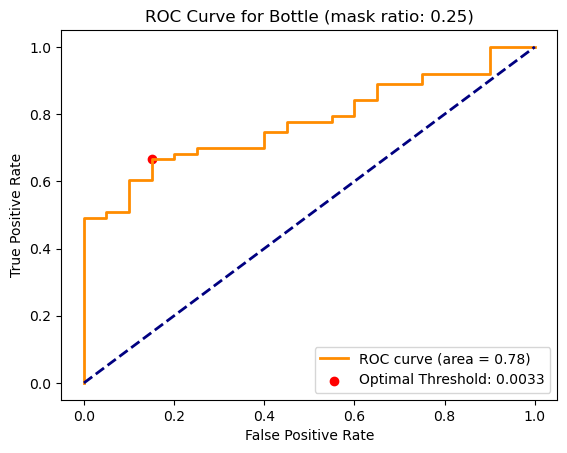

AUROC for Bottle: 0.78
Precision: 0.93, Recall: 0.67, F1-Score: 0.78


In [57]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Liste des ratios de masque à tester
mask_ratios = [1/32, 1/16, 1/8, 1/4]

for mask_ratio in mask_ratios:
    print(f"\nTraining Masked Autoencoder with mask ratio: {mask_ratio:.2f}")
    
    # Initialisation du modèle
    masked_autoencoder_bottle = MaskedAutoencoder(latent_dim=128, mask_ratio=mask_ratio)
    
    # Entraînement
    masked_autoencoder_bottle = train_mask_model(
        masked_autoencoder_bottle,
        train_loader_bottle,
        test_loader_bottle,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(masked_autoencoder_bottle.parameters(), lr=0.001),
        device=device,
        epochs=10
    )

    
    # Calcul des pertes et tracé de la courbe ROC
    losses_bottle = calculate_losses(masked_autoencoder_bottle, test_loader_bottle, criterion, device)
    labels_bottle = np.array(test_categories_B)
    auroc_masked_bottle, precision_bottle, recall_bottle, f1_bottle = plot_roc_curve_with_metrics(
        losses_bottle, labels_bottle, f"Bottle (mask ratio: {mask_ratio:.2f})"
    )
    print(f"AUROC for Bottle: {auroc_masked_bottle:.2f}")
    print(f"Precision: {precision_bottle:.2f}, Recall: {recall_bottle:.2f}, F1-Score: {f1_bottle:.2f}")


Epoch 1/10, Train Loss: 0.0904, Validation Loss: 0.1035
Epoch 2/10, Train Loss: 0.0255, Validation Loss: 0.0282
Epoch 3/10, Train Loss: 0.0120, Validation Loss: 0.0166
Epoch 4/10, Train Loss: 0.0087, Validation Loss: 0.0219
Epoch 5/10, Train Loss: 0.0063, Validation Loss: 0.0109
Epoch 6/10, Train Loss: 0.0050, Validation Loss: 0.0103
Epoch 7/10, Train Loss: 0.0041, Validation Loss: 0.0055
Epoch 8/10, Train Loss: 0.0036, Validation Loss: 0.0047
Epoch 9/10, Train Loss: 0.0033, Validation Loss: 0.0044
Epoch 10/10, Train Loss: 0.0030, Validation Loss: 0.0040
Optimal Threshold: 0.0042746905237436295

Classification Report for Bottle (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.36      1.00      0.53        20
   Anomalous       1.00      0.43      0.60        63

    accuracy                           0.57        83
   macro avg       0.68      0.71      0.56        83
weighted avg       0.85      0.57      0.58        83

Precision: 1.00
R

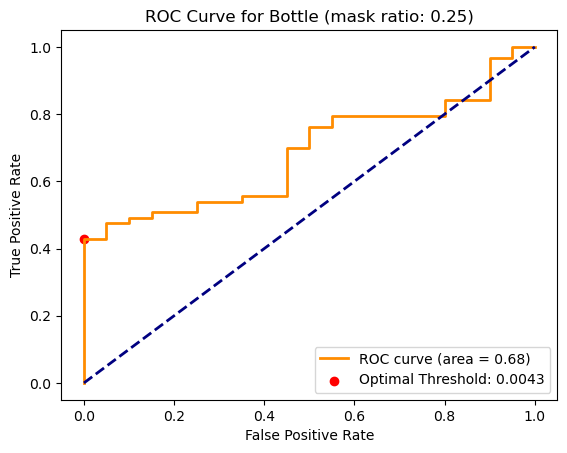

AUROC for Bottle: 0.68
Precision: 1.00, Recall: 0.43, F1-Score: 0.60


In [62]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

masked_autoencoder_bottle = MaskedAutoencoder(mask_ratio= 1/4)# on prend le meilleur masque
    
# Entraînement
masked_autoencoder_bottle = train_mask_model(
    masked_autoencoder_bottle,
    train_loader_bottle,
    test_loader_bottle,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(masked_autoencoder_bottle.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_bottle = calculate_losses(masked_autoencoder_bottle, test_loader_bottle, criterion, device)
labels_bottle = np.array(test_categories_B)
auroc_masked_bottle, precision_bottle, recall_bottle, f1_bottle = plot_roc_curve_with_metrics(
    losses_bottle, labels_bottle, f"Bottle (mask ratio: {mask_ratio:.2f})"
)
print(f"AUROC for Bottle: {auroc_masked_bottle:.2f}")
print(f"Precision: {precision_bottle:.2f}, Recall: {recall_bottle:.2f}, F1-Score: {f1_bottle:.2f}")

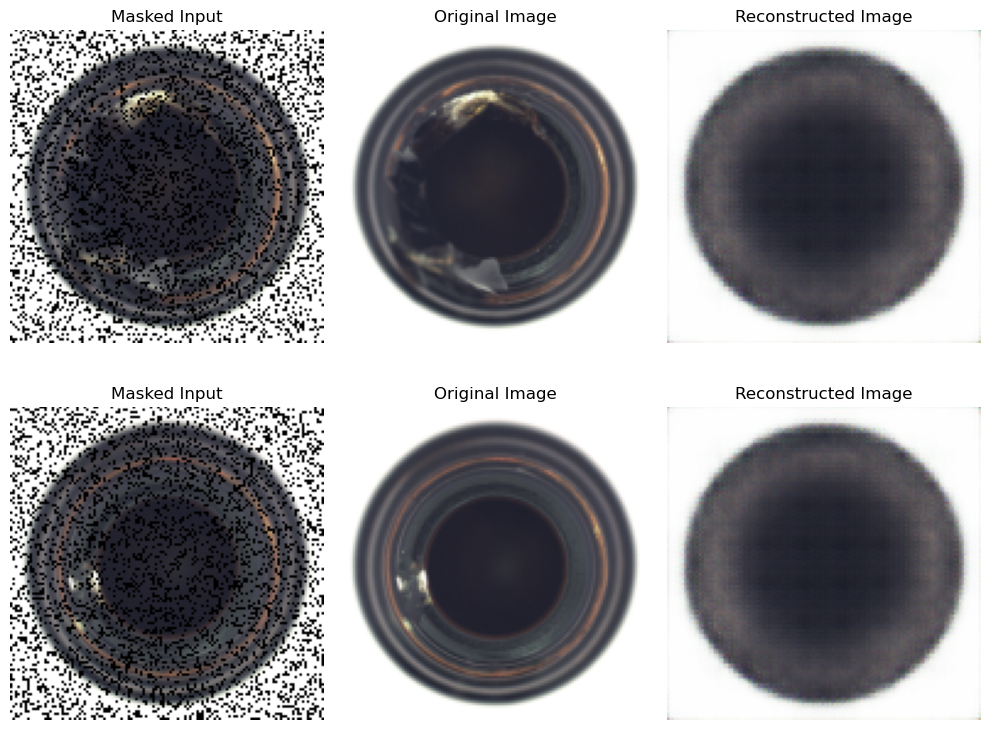

In [63]:
visualize_masked_reconstructions(masked_autoencoder_bottle, test_loader_bottle, device=device, num_images=2)

#### Hazelnut


Training Masked Autoencoder with mask ratio: 0.03
Epoch 1/10, Train Loss: 0.0296, Validation Loss: 0.0124
Epoch 2/10, Train Loss: 0.0042, Validation Loss: 0.0151
Epoch 3/10, Train Loss: 0.0028, Validation Loss: 0.0039
Epoch 4/10, Train Loss: 0.0018, Validation Loss: 0.0025
Epoch 5/10, Train Loss: 0.0013, Validation Loss: 0.0022
Epoch 6/10, Train Loss: 0.0011, Validation Loss: 0.0022
Epoch 7/10, Train Loss: 0.0010, Validation Loss: 0.0016
Epoch 8/10, Train Loss: 0.0009, Validation Loss: 0.0015
Epoch 9/10, Train Loss: 0.0009, Validation Loss: 0.0021
Epoch 10/10, Train Loss: 0.0008, Validation Loss: 0.0018
Optimal Threshold: 0.0016262632561847568

Classification Report for Hazelnut (mask ratio: 0.03):
              precision    recall  f1-score   support

      Normal       0.52      0.97      0.68        40
   Anomalous       0.97      0.49      0.65        70

    accuracy                           0.66       110
   macro avg       0.75      0.73      0.66       110
weighted avg       

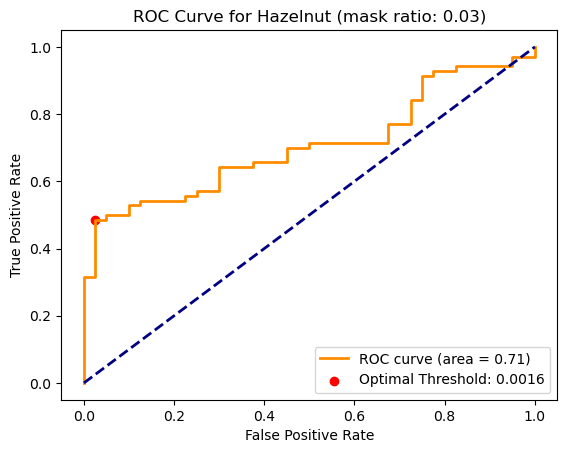

AUROC for Hazelnut: 0.71
Precision: 0.97, Recall: 0.49, F1-Score: 0.65

Training Masked Autoencoder with mask ratio: 0.06
Epoch 1/10, Train Loss: 0.0389, Validation Loss: 0.0162
Epoch 2/10, Train Loss: 0.0041, Validation Loss: 0.0040
Epoch 3/10, Train Loss: 0.0028, Validation Loss: 0.0041
Epoch 4/10, Train Loss: 0.0017, Validation Loss: 0.0024
Epoch 5/10, Train Loss: 0.0013, Validation Loss: 0.0020
Epoch 6/10, Train Loss: 0.0011, Validation Loss: 0.0020
Epoch 7/10, Train Loss: 0.0010, Validation Loss: 0.0018
Epoch 8/10, Train Loss: 0.0009, Validation Loss: 0.0016
Epoch 9/10, Train Loss: 0.0008, Validation Loss: 0.0015
Epoch 10/10, Train Loss: 0.0008, Validation Loss: 0.0015
Optimal Threshold: 0.0011407773708924651

Classification Report for Hazelnut (mask ratio: 0.06):
              precision    recall  f1-score   support

      Normal       0.57      0.95      0.71        40
   Anomalous       0.95      0.59      0.73        70

    accuracy                           0.72       110
  

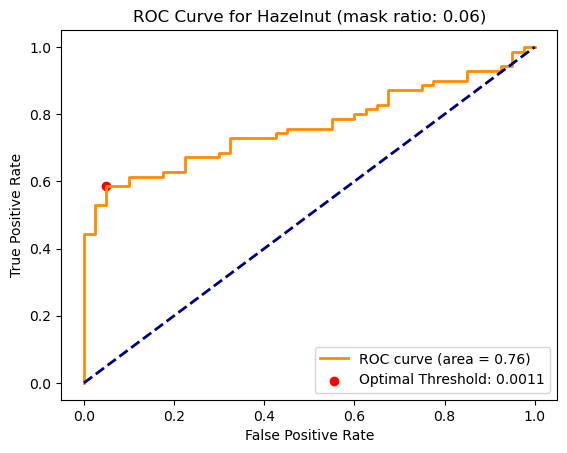

AUROC for Hazelnut: 0.76
Precision: 0.95, Recall: 0.59, F1-Score: 0.73

Training Masked Autoencoder with mask ratio: 0.12
Epoch 1/10, Train Loss: 0.0662, Validation Loss: 0.0256
Epoch 2/10, Train Loss: 0.0146, Validation Loss: 0.0068
Epoch 3/10, Train Loss: 0.0053, Validation Loss: 0.0051
Epoch 4/10, Train Loss: 0.0033, Validation Loss: 0.0034
Epoch 5/10, Train Loss: 0.0022, Validation Loss: 0.0029
Epoch 6/10, Train Loss: 0.0018, Validation Loss: 0.0022
Epoch 7/10, Train Loss: 0.0015, Validation Loss: 0.0020
Epoch 8/10, Train Loss: 0.0013, Validation Loss: 0.0021
Epoch 9/10, Train Loss: 0.0012, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0011, Validation Loss: 0.0019
Optimal Threshold: 0.0014512123307213187

Classification Report for Hazelnut (mask ratio: 0.12):
              precision    recall  f1-score   support

      Normal       0.60      0.88      0.71        40
   Anomalous       0.90      0.67      0.77        70

    accuracy                           0.75       110
  

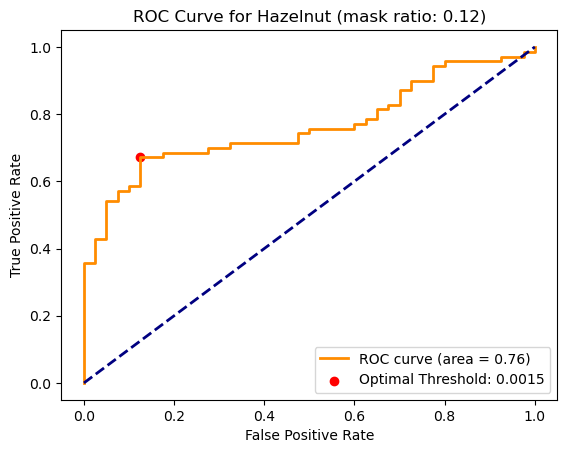

AUROC for Hazelnut: 0.76
Precision: 0.90, Recall: 0.67, F1-Score: 0.77

Training Masked Autoencoder with mask ratio: 0.25
Epoch 1/10, Train Loss: 0.0613, Validation Loss: 0.0224
Epoch 2/10, Train Loss: 0.0111, Validation Loss: 0.0170
Epoch 3/10, Train Loss: 0.0044, Validation Loss: 0.0166
Epoch 4/10, Train Loss: 0.0029, Validation Loss: 0.0050
Epoch 5/10, Train Loss: 0.0021, Validation Loss: 0.0026
Epoch 6/10, Train Loss: 0.0017, Validation Loss: 0.0025
Epoch 7/10, Train Loss: 0.0015, Validation Loss: 0.0021
Epoch 8/10, Train Loss: 0.0013, Validation Loss: 0.0019
Epoch 9/10, Train Loss: 0.0011, Validation Loss: 0.0018
Epoch 10/10, Train Loss: 0.0010, Validation Loss: 0.0016
Optimal Threshold: 0.00126146269030869

Classification Report for Hazelnut (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.56      0.93      0.70        40
   Anomalous       0.93      0.59      0.72        70

    accuracy                           0.71       110
   m

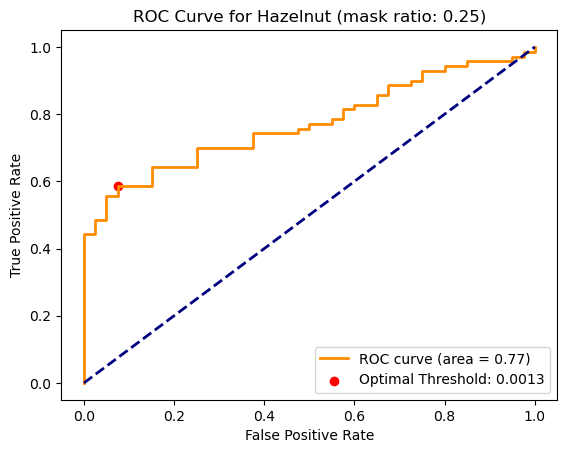

AUROC for Hazelnut: 0.77
Precision: 0.93, Recall: 0.59, F1-Score: 0.72


In [58]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Liste des ratios de masque à tester
mask_ratios = [1/32, 1/16, 1/8, 1/4]

for mask_ratio in mask_ratios:
    print(f"\nTraining Masked Autoencoder with mask ratio: {mask_ratio:.2f}")
    
    # Initialisation du modèle
    masked_autoencoder_hazelnut = MaskedAutoencoder(latent_dim=128, mask_ratio=mask_ratio)
    
    # Entraînement
    masked_autoencoder_hazelnut = train_mask_model(
        masked_autoencoder_hazelnut,
        train_loader_hazelnut,
        test_loader_hazelnut,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(masked_autoencoder_hazelnut.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
        
    # Calcul des pertes et tracé de la courbe ROC
    losses_hazelnut = calculate_losses(masked_autoencoder_hazelnut, test_loader_hazelnut, criterion, device)
    labels_hazelnut = np.array(test_categories_H)
    auroc_masked_hazelnut, precision_h, recall_h, f1_h = plot_roc_curve_with_metrics(
        losses_hazelnut, labels_hazelnut, f"Hazelnut (mask ratio: {mask_ratio:.2f})"
    )
    print(f"AUROC for Hazelnut: {auroc_masked_hazelnut:.2f}")
    print(f"Precision: {precision_h:.2f}, Recall: {recall_h:.2f}, F1-Score: {f1_h:.2f}")

Epoch 1/10, Train Loss: 0.0481, Validation Loss: 0.0194
Epoch 2/10, Train Loss: 0.0066, Validation Loss: 0.0133
Epoch 3/10, Train Loss: 0.0035, Validation Loss: 0.0058
Epoch 4/10, Train Loss: 0.0023, Validation Loss: 0.0036
Epoch 5/10, Train Loss: 0.0016, Validation Loss: 0.0022
Epoch 6/10, Train Loss: 0.0013, Validation Loss: 0.0021
Epoch 7/10, Train Loss: 0.0011, Validation Loss: 0.0019
Epoch 8/10, Train Loss: 0.0010, Validation Loss: 0.0016
Epoch 9/10, Train Loss: 0.0009, Validation Loss: 0.0015
Epoch 10/10, Train Loss: 0.0009, Validation Loss: 0.0016
Optimal Threshold: 0.0013145891716703773

Classification Report for Hazelnut (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.55      0.88      0.67        40
   Anomalous       0.89      0.59      0.71        70

    accuracy                           0.69       110
   macro avg       0.72      0.73      0.69       110
weighted avg       0.77      0.69      0.69       110

Precision: 0.89

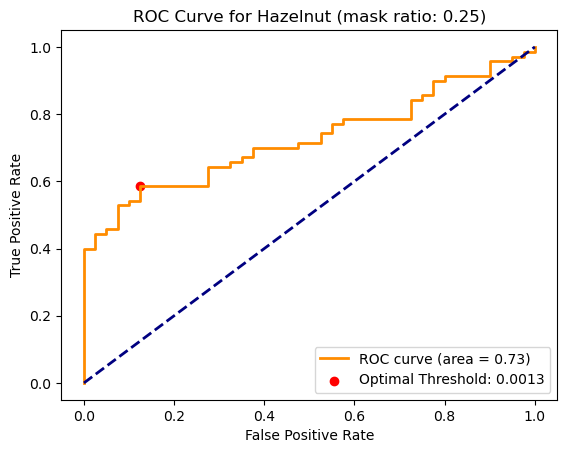

AUROC for Hazelnut: 0.73
Precision: 0.89, Recall: 0.59, F1-Score: 0.71


In [64]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

masked_autoencoder_hazelnut = MaskedAutoencoder(mask_ratio= 1/4)# on prend le meilleur masque
    
# Entraînement
masked_autoencoder_hazelnut = train_mask_model(
    masked_autoencoder_hazelnut,
    train_loader_hazelnut,
    test_loader_hazelnut,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(masked_autoencoder_hazelnut.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_hazelnut = calculate_losses(masked_autoencoder_hazelnut, test_loader_hazelnut, criterion, device)
labels_hazelnut = np.array(test_categories_H)
auroc_masked_hazelnut, precision_h, recall_h, f1_h = plot_roc_curve_with_metrics(
    losses_hazelnut, labels_hazelnut, f"Hazelnut (mask ratio: {mask_ratio:.2f})"
)
print(f"AUROC for Hazelnut: {auroc_masked_hazelnut:.2f}")
print(f"Precision: {precision_h:.2f}, Recall: {recall_h:.2f}, F1-Score: {f1_h:.2f}")

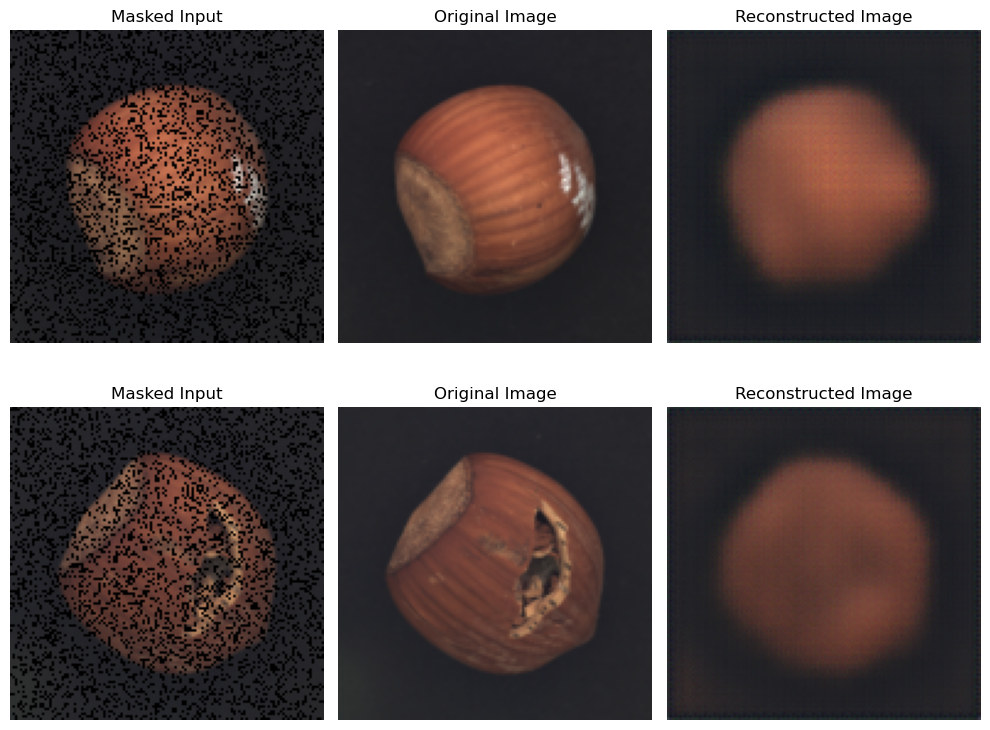

In [65]:
visualize_masked_reconstructions(masked_autoencoder_hazelnut, test_loader_hazelnut, device=device, num_images=2)

#### Capsule


Training Masked Autoencoder with mask ratio: 0.03
Epoch 1/10, Train Loss: 0.0569, Validation Loss: 0.0690
Epoch 2/10, Train Loss: 0.0124, Validation Loss: 0.0154
Epoch 3/10, Train Loss: 0.0060, Validation Loss: 0.0058
Epoch 4/10, Train Loss: 0.0044, Validation Loss: 0.0043
Epoch 5/10, Train Loss: 0.0036, Validation Loss: 0.0034
Epoch 6/10, Train Loss: 0.0029, Validation Loss: 0.0034
Epoch 7/10, Train Loss: 0.0025, Validation Loss: 0.0028
Epoch 8/10, Train Loss: 0.0021, Validation Loss: 0.0023
Epoch 9/10, Train Loss: 0.0018, Validation Loss: 0.0022
Epoch 10/10, Train Loss: 0.0016, Validation Loss: 0.0022
Optimal Threshold: 0.001905659562908113

Classification Report for Capsule (mask ratio: 0.03):
              precision    recall  f1-score   support

      Normal       0.30      0.43      0.36        23
   Anomalous       0.87      0.79      0.83       109

    accuracy                           0.73       132
   macro avg       0.59      0.61      0.59       132
weighted avg       0.

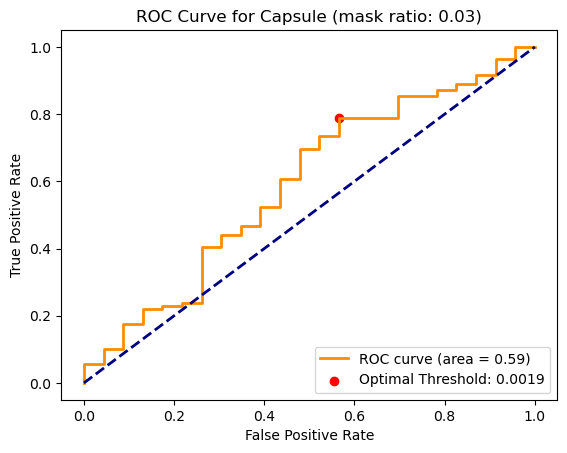

AUROC for Capsule: 0.59
Precision: 0.87, Recall: 0.79, F1-Score: 0.83

Training Masked Autoencoder with mask ratio: 0.06
Epoch 1/10, Train Loss: 0.0706, Validation Loss: 0.0458
Epoch 2/10, Train Loss: 0.0161, Validation Loss: 0.0138
Epoch 3/10, Train Loss: 0.0071, Validation Loss: 0.0064
Epoch 4/10, Train Loss: 0.0045, Validation Loss: 0.0059
Epoch 5/10, Train Loss: 0.0035, Validation Loss: 0.0033
Epoch 6/10, Train Loss: 0.0028, Validation Loss: 0.0027
Epoch 7/10, Train Loss: 0.0024, Validation Loss: 0.0023
Epoch 8/10, Train Loss: 0.0020, Validation Loss: 0.0021
Epoch 9/10, Train Loss: 0.0018, Validation Loss: 0.0019
Epoch 10/10, Train Loss: 0.0016, Validation Loss: 0.0019
Optimal Threshold: 0.0017446866258978844

Classification Report for Capsule (mask ratio: 0.06):
              precision    recall  f1-score   support

      Normal       0.29      0.57      0.38        23
   Anomalous       0.89      0.71      0.79       109

    accuracy                           0.68       132
   m

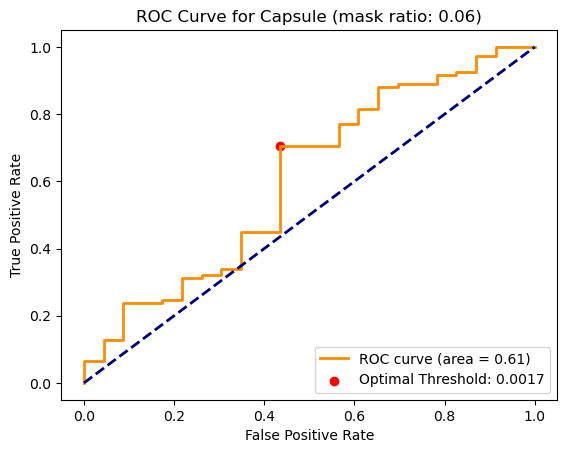

AUROC for Capsule: 0.61
Precision: 0.89, Recall: 0.71, F1-Score: 0.79

Training Masked Autoencoder with mask ratio: 0.12
Epoch 1/10, Train Loss: 0.0609, Validation Loss: 0.0539
Epoch 2/10, Train Loss: 0.0121, Validation Loss: 0.0152
Epoch 3/10, Train Loss: 0.0066, Validation Loss: 0.0103
Epoch 4/10, Train Loss: 0.0049, Validation Loss: 0.0068
Epoch 5/10, Train Loss: 0.0038, Validation Loss: 0.0048
Epoch 6/10, Train Loss: 0.0031, Validation Loss: 0.0032
Epoch 7/10, Train Loss: 0.0027, Validation Loss: 0.0027
Epoch 8/10, Train Loss: 0.0023, Validation Loss: 0.0026
Epoch 9/10, Train Loss: 0.0020, Validation Loss: 0.0025
Epoch 10/10, Train Loss: 0.0017, Validation Loss: 0.0025
Optimal Threshold: 0.002214645966887474

Classification Report for Capsule (mask ratio: 0.12):
              precision    recall  f1-score   support

      Normal       0.36      0.22      0.27        23
   Anomalous       0.85      0.92      0.88       109

    accuracy                           0.80       132
   ma

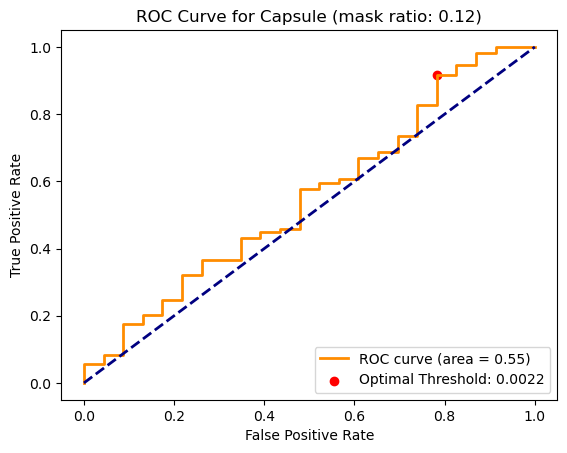

AUROC for Capsule: 0.55
Precision: 0.85, Recall: 0.92, F1-Score: 0.88

Training Masked Autoencoder with mask ratio: 0.25
Epoch 1/10, Train Loss: 0.0745, Validation Loss: 0.0852
Epoch 2/10, Train Loss: 0.0271, Validation Loss: 0.0300
Epoch 3/10, Train Loss: 0.0125, Validation Loss: 0.0266
Epoch 4/10, Train Loss: 0.0071, Validation Loss: 0.0323
Epoch 5/10, Train Loss: 0.0042, Validation Loss: 0.0172
Epoch 6/10, Train Loss: 0.0029, Validation Loss: 0.0132
Epoch 7/10, Train Loss: 0.0022, Validation Loss: 0.0074
Epoch 8/10, Train Loss: 0.0018, Validation Loss: 0.0037
Epoch 9/10, Train Loss: 0.0016, Validation Loss: 0.0021
Epoch 10/10, Train Loss: 0.0014, Validation Loss: 0.0015
Optimal Threshold: 0.001654087915085256

Classification Report for Capsule (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.19      0.91      0.31        23
   Anomalous       0.90      0.17      0.29       109

    accuracy                           0.30       132
   ma

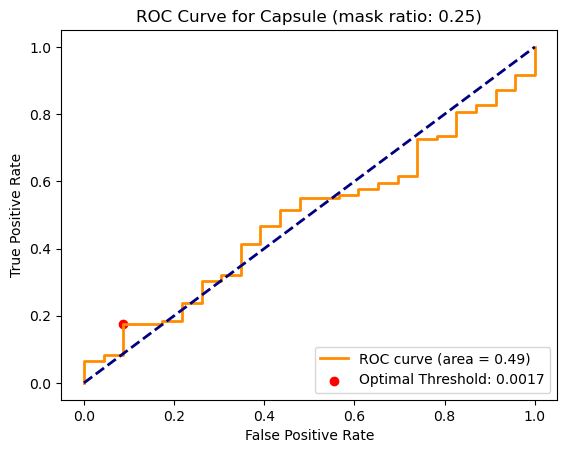

AUROC for Capsule: 0.49
Precision: 0.90, Recall: 0.17, F1-Score: 0.29


In [59]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Liste des ratios de masque à tester
mask_ratios = [1/32, 1/16, 1/8, 1/4]

for mask_ratio in mask_ratios:
    print(f"\nTraining Masked Autoencoder with mask ratio: {mask_ratio:.2f}")
    
    # Initialisation du modèle
    masked_autoencoder_capsule = MaskedAutoencoder(latent_dim=128, mask_ratio=mask_ratio)
    
    # Entraînement
    masked_autoencoder_capsule = train_mask_model(
        masked_autoencoder_capsule,
        train_loader_capsule,
        test_loader_capsule,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(masked_autoencoder_capsule.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
        
    # Calcul des pertes et tracé de la courbe ROC
    losses_capsule = calculate_losses(masked_autoencoder_capsule, test_loader_capsule, criterion, device)
    labels_capsule = np.array(test_categories_C)
    auroc_masked_capsule, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(
        losses_capsule, labels_capsule, f"Capsule (mask ratio: {mask_ratio:.2f})"
    )
    print(f"AUROC for Capsule: {auroc_masked_capsule:.2f}")
    print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")

Epoch 1/10, Train Loss: 0.0596, Validation Loss: 0.0541
Epoch 2/10, Train Loss: 0.0095, Validation Loss: 0.0099
Epoch 3/10, Train Loss: 0.0051, Validation Loss: 0.0090
Epoch 4/10, Train Loss: 0.0038, Validation Loss: 0.0081
Epoch 5/10, Train Loss: 0.0030, Validation Loss: 0.0034
Epoch 6/10, Train Loss: 0.0025, Validation Loss: 0.0025
Epoch 7/10, Train Loss: 0.0021, Validation Loss: 0.0023
Epoch 8/10, Train Loss: 0.0018, Validation Loss: 0.0025
Epoch 9/10, Train Loss: 0.0016, Validation Loss: 0.0030
Epoch 10/10, Train Loss: 0.0014, Validation Loss: 0.0028
Optimal Threshold: 0.0035524494014680386

Classification Report for Capsule (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.18      1.00      0.31        23
   Anomalous       1.00      0.06      0.12       109

    accuracy                           0.23       132
   macro avg       0.59      0.53      0.22       132
weighted avg       0.86      0.23      0.15       132

Precision: 1.00


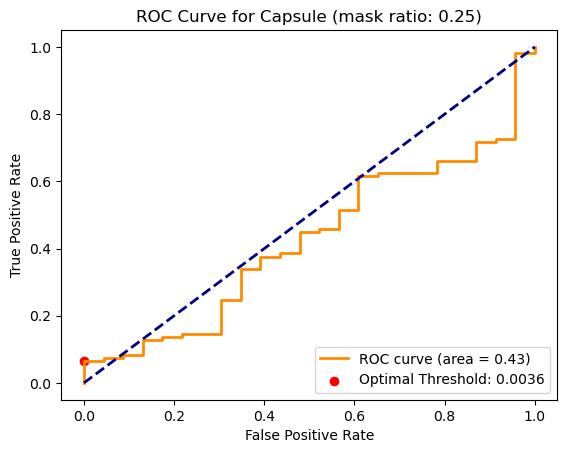

AUROC for Capsule: 0.43
Precision: 1.00, Recall: 0.06, F1-Score: 0.12


In [66]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

masked_autoencoder_capsule = MaskedAutoencoder(mask_ratio=1/16 )# on prend le meilleur masque
    
# Entraînement
masked_autoencoder_capsule = train_mask_model(
    masked_autoencoder_capsule,
    train_loader_capsule,
    test_loader_capsule,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(masked_autoencoder_capsule.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_capsule = calculate_losses(masked_autoencoder_capsule, test_loader_capsule, criterion, device)
labels_capsule = np.array(test_categories_C)
auroc_masked_capsule, precision_c, recall_c, f1_c = plot_roc_curve_with_metrics(
    losses_capsule, labels_capsule, f"Capsule (mask ratio: {mask_ratio:.2f})"
)
print(f"AUROC for Capsule: {auroc_masked_capsule:.2f}")
print(f"Precision: {precision_c:.2f}, Recall: {recall_c:.2f}, F1-Score: {f1_c:.2f}")

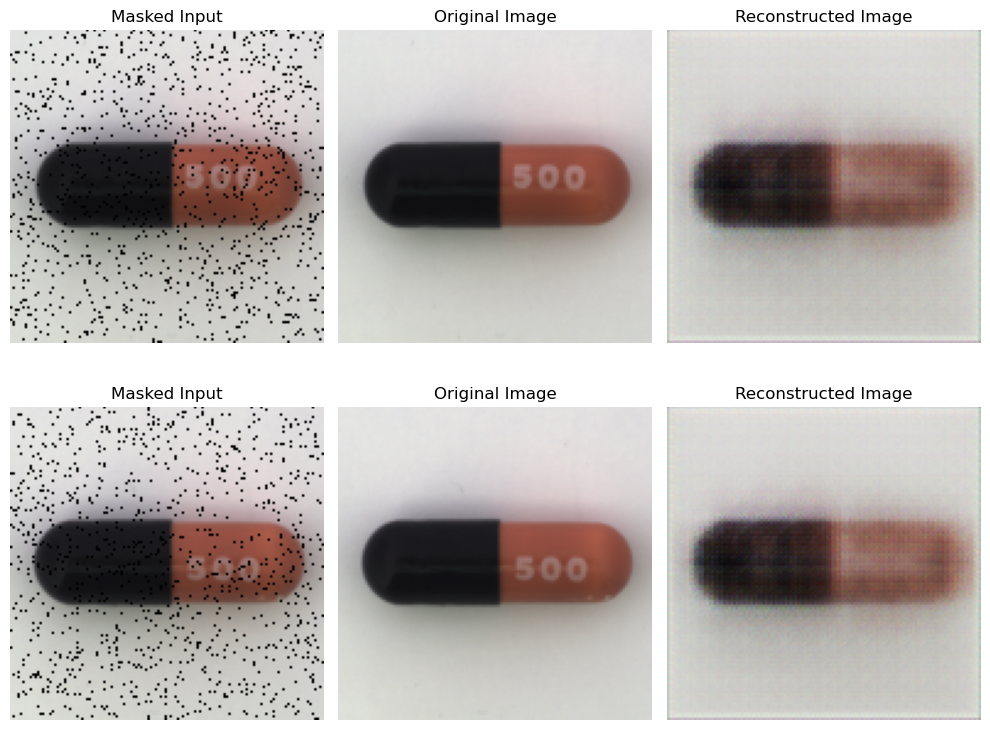

In [67]:
visualize_masked_reconstructions(masked_autoencoder_capsule, test_loader_capsule, device=device, num_images=2)

#### Toothbrush


Training Masked Autoencoder with mask ratio: 0.03
Epoch 1/10, Train Loss: 0.1384, Validation Loss: 0.1254
Epoch 2/10, Train Loss: 0.0816, Validation Loss: 0.1184
Epoch 3/10, Train Loss: 0.0581, Validation Loss: 0.1043
Epoch 4/10, Train Loss: 0.0441, Validation Loss: 0.0773
Epoch 5/10, Train Loss: 0.0340, Validation Loss: 0.0534
Epoch 6/10, Train Loss: 0.0267, Validation Loss: 0.0370
Epoch 7/10, Train Loss: 0.0217, Validation Loss: 0.0263
Epoch 8/10, Train Loss: 0.0182, Validation Loss: 0.0201
Epoch 9/10, Train Loss: 0.0160, Validation Loss: 0.0166
Epoch 10/10, Train Loss: 0.0144, Validation Loss: 0.0141
Optimal Threshold: 0.01650639995932579

Classification Report for Toothbrush (mask ratio: 0.03):
              precision    recall  f1-score   support

      Normal       0.35      1.00      0.52        12
   Anomalous       1.00      0.27      0.42        30

    accuracy                           0.48        42
   macro avg       0.68      0.63      0.47        42
weighted avg       

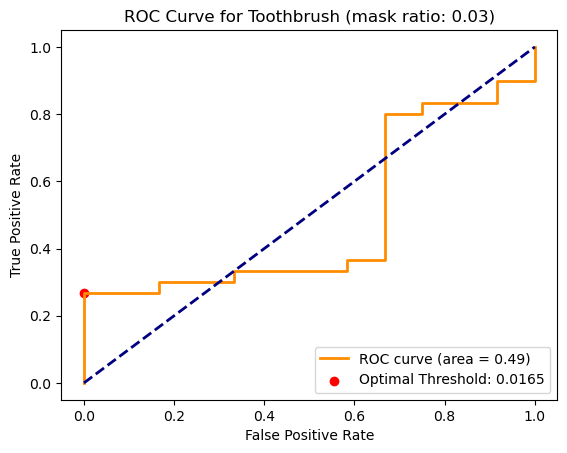

AUROC for Toothbrush: 0.49
Precision: 1.00, Recall: 0.27, F1-Score: 0.42

Training Masked Autoencoder with mask ratio: 0.06
Epoch 1/10, Train Loss: 0.1463, Validation Loss: 0.1323
Epoch 2/10, Train Loss: 0.0823, Validation Loss: 0.1223
Epoch 3/10, Train Loss: 0.0608, Validation Loss: 0.1011
Epoch 4/10, Train Loss: 0.0469, Validation Loss: 0.0758
Epoch 5/10, Train Loss: 0.0366, Validation Loss: 0.0532
Epoch 6/10, Train Loss: 0.0292, Validation Loss: 0.0367
Epoch 7/10, Train Loss: 0.0237, Validation Loss: 0.0265
Epoch 8/10, Train Loss: 0.0197, Validation Loss: 0.0201
Epoch 9/10, Train Loss: 0.0168, Validation Loss: 0.0164
Epoch 10/10, Train Loss: 0.0148, Validation Loss: 0.0154
Optimal Threshold: 0.018756795674562454

Classification Report for Toothbrush (mask ratio: 0.06):
              precision    recall  f1-score   support

      Normal       0.35      1.00      0.52        12
   Anomalous       1.00      0.27      0.42        30

    accuracy                           0.48        42

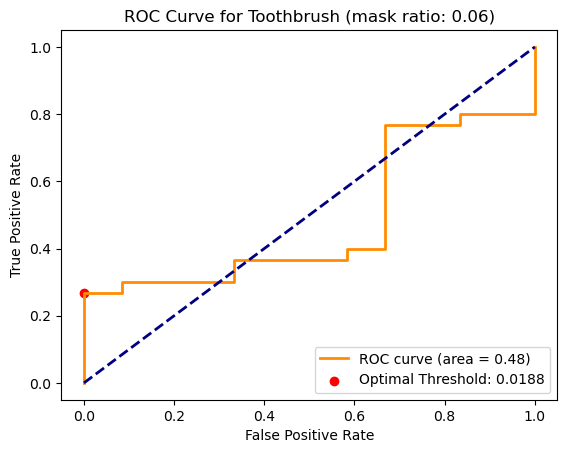

AUROC for Toothbrush: 0.48
Precision: 1.00, Recall: 0.27, F1-Score: 0.42

Training Masked Autoencoder with mask ratio: 0.12
Epoch 1/10, Train Loss: 0.1463, Validation Loss: 0.1309
Epoch 2/10, Train Loss: 0.0863, Validation Loss: 0.1247
Epoch 3/10, Train Loss: 0.0648, Validation Loss: 0.1016
Epoch 4/10, Train Loss: 0.0485, Validation Loss: 0.0743
Epoch 5/10, Train Loss: 0.0371, Validation Loss: 0.0521
Epoch 6/10, Train Loss: 0.0292, Validation Loss: 0.0362
Epoch 7/10, Train Loss: 0.0242, Validation Loss: 0.0268
Epoch 8/10, Train Loss: 0.0206, Validation Loss: 0.0211
Epoch 9/10, Train Loss: 0.0179, Validation Loss: 0.0177
Epoch 10/10, Train Loss: 0.0161, Validation Loss: 0.0160
Optimal Threshold: 0.01911761797964573

Classification Report for Toothbrush (mask ratio: 0.12):
              precision    recall  f1-score   support

      Normal       0.36      1.00      0.53        12
   Anomalous       1.00      0.30      0.46        30

    accuracy                           0.50        42


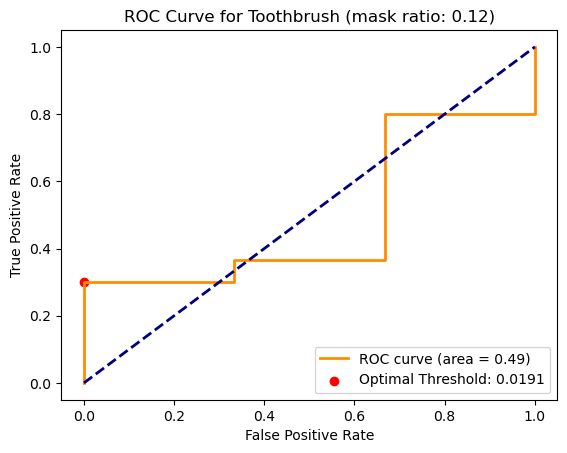

AUROC for Toothbrush: 0.49
Precision: 1.00, Recall: 0.30, F1-Score: 0.46

Training Masked Autoencoder with mask ratio: 0.17
Epoch 1/10, Train Loss: 0.1769, Validation Loss: 0.1399
Epoch 2/10, Train Loss: 0.1110, Validation Loss: 0.1388
Epoch 3/10, Train Loss: 0.0865, Validation Loss: 0.1186
Epoch 4/10, Train Loss: 0.0674, Validation Loss: 0.0911
Epoch 5/10, Train Loss: 0.0533, Validation Loss: 0.0659
Epoch 6/10, Train Loss: 0.0424, Validation Loss: 0.0470
Epoch 7/10, Train Loss: 0.0341, Validation Loss: 0.0353
Epoch 8/10, Train Loss: 0.0279, Validation Loss: 0.0286
Epoch 9/10, Train Loss: 0.0235, Validation Loss: 0.0244
Epoch 10/10, Train Loss: 0.0203, Validation Loss: 0.0214
Optimal Threshold: 0.024943595752120018

Classification Report for Toothbrush (mask ratio: 0.17):
              precision    recall  f1-score   support

      Normal       0.33      0.92      0.49        12
   Anomalous       0.89      0.27      0.41        30

    accuracy                           0.45        42

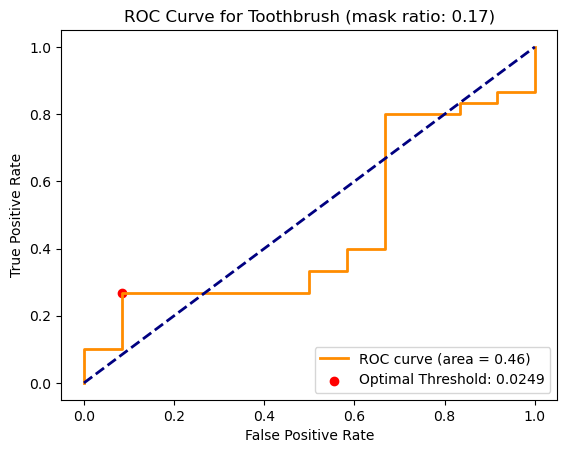

AUROC for Toothbrush: 0.46
Precision: 0.89, Recall: 0.27, F1-Score: 0.41


In [60]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Liste des ratios de masque à tester
mask_ratios = [1/32, 1/16, 1/8, 1/6]

for mask_ratio in mask_ratios:
    print(f"\nTraining Masked Autoencoder with mask ratio: {mask_ratio:.2f}")
    
    # Initialisation du modèle
    masked_autoencoder_toothbrush = MaskedAutoencoder(latent_dim=128, mask_ratio=mask_ratio)
    
    # Entraînement
    masked_autoencoder_toothbrush = train_mask_model(
        masked_autoencoder_toothbrush,
        train_loader_toothbrush,
        test_loader_toothbrush,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(masked_autoencoder_toothbrush.parameters(), lr=0.001),
        device=device,
        epochs=10
    )
        
    # Calcul des pertes et tracé de la courbe ROC
    losses_toothbrush = calculate_losses(masked_autoencoder_toothbrush, test_loader_toothbrush, criterion, device)
    labels_toothbrush = np.array(test_categories_T)
    auroc_masked_toothbrush, precision_t, recall_t, f1_t = plot_roc_curve_with_metrics(
        losses_toothbrush, labels_toothbrush, f"Toothbrush (mask ratio: {mask_ratio:.2f})"
    )
    print(f"AUROC for Toothbrush: {auroc_masked_toothbrush:.2f}")
    print(f"Precision: {precision_t:.2f}, Recall: {recall_t:.2f}, F1-Score: {f1_t:.2f}")

Epoch 1/10, Train Loss: 0.1613, Validation Loss: 0.1364
Epoch 2/10, Train Loss: 0.0976, Validation Loss: 0.1267
Epoch 3/10, Train Loss: 0.0760, Validation Loss: 0.1000
Epoch 4/10, Train Loss: 0.0599, Validation Loss: 0.0789
Epoch 5/10, Train Loss: 0.0480, Validation Loss: 0.0626
Epoch 6/10, Train Loss: 0.0392, Validation Loss: 0.0517
Epoch 7/10, Train Loss: 0.0324, Validation Loss: 0.0430
Epoch 8/10, Train Loss: 0.0269, Validation Loss: 0.0339
Epoch 9/10, Train Loss: 0.0225, Validation Loss: 0.0275
Epoch 10/10, Train Loss: 0.0192, Validation Loss: 0.0238
Optimal Threshold: 0.028358936309814453

Classification Report for Toothbrush (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.34      1.00      0.51        12
   Anomalous       1.00      0.23      0.38        30

    accuracy                           0.45        42
   macro avg       0.67      0.62      0.44        42
weighted avg       0.81      0.45      0.42        42

Precision: 1.0

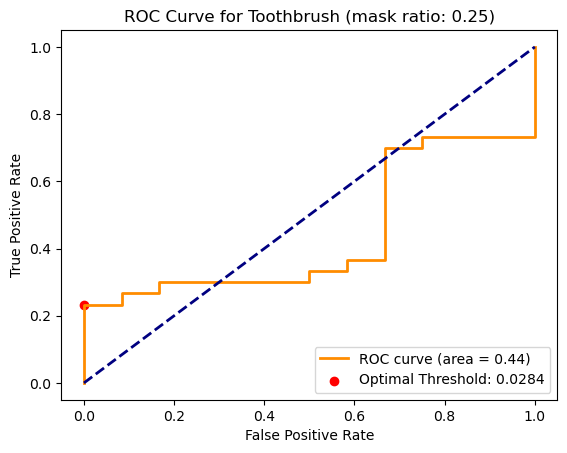

AUROC for Toothbrush: 0.44
Precision: 1.00, Recall: 0.23, F1-Score: 0.38


In [68]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

masked_autoencoder_toothbrush = MaskedAutoencoder(mask_ratio= 1/6)# on prend le meilleur masque
    
# Entraînement
masked_autoencoder_toothbrush = train_mask_model(
    masked_autoencoder_toothbrush,
    train_loader_toothbrush,
    test_loader_toothbrush,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(masked_autoencoder_toothbrush.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_toothbrush = calculate_losses(masked_autoencoder_toothbrush, test_loader_toothbrush, criterion, device)
labels_toothbrush = np.array(test_categories_T)
auroc_masked_toothbrush, precision_t, recall_t, f1_t = plot_roc_curve_with_metrics(
    losses_toothbrush, labels_toothbrush, f"Toothbrush (mask ratio: {mask_ratio:.2f})"
)
print(f"AUROC for Toothbrush: {auroc_masked_toothbrush:.2f}")
print(f"Precision: {precision_t:.2f}, Recall: {recall_t:.2f}, F1-Score: {f1_t:.2f}")

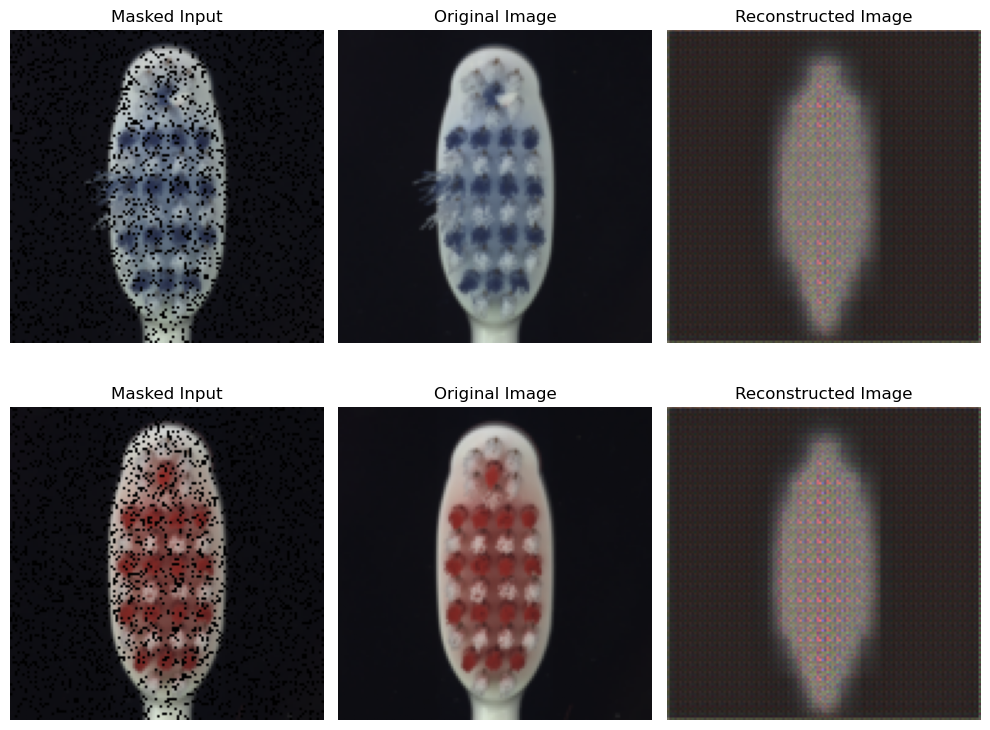

In [69]:
visualize_masked_reconstructions(masked_autoencoder_toothbrush, test_loader_toothbrush, device=device, num_images=2)

### Sur Auto_VI


Training Masked Autoencoder with mask ratio: 0.03
Epoch 1/10, Train Loss: 0.0723, Validation Loss: 0.0616
Epoch 2/10, Train Loss: 0.0348, Validation Loss: 0.0367
Epoch 3/10, Train Loss: 0.0263, Validation Loss: 0.0258
Epoch 4/10, Train Loss: 0.0226, Validation Loss: 0.0213
Epoch 5/10, Train Loss: 0.0201, Validation Loss: 0.0209
Epoch 6/10, Train Loss: 0.0179, Validation Loss: 0.0206
Epoch 7/10, Train Loss: 0.0159, Validation Loss: 0.0202
Epoch 8/10, Train Loss: 0.0140, Validation Loss: 0.0198
Epoch 9/10, Train Loss: 0.0124, Validation Loss: 0.0143
Epoch 10/10, Train Loss: 0.0110, Validation Loss: 0.0117
Optimal Threshold: 0.011444787494838238

Classification Report for Engine (mask ratio: 0.03):
              precision    recall  f1-score   support

      Normal       0.60      0.61      0.61       285
   Anomalous       0.65      0.63      0.64       322

    accuracy                           0.62       607
   macro avg       0.62      0.62      0.62       607
weighted avg       0.6

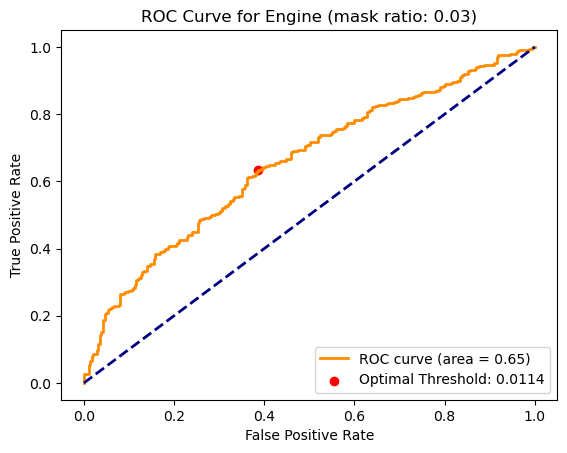

AUROC for Engine Wiring: 0.65
Precision: 0.65, Recall: 0.63, F1-Score: 0.64

Training Masked Autoencoder with mask ratio: 0.06
Epoch 1/10, Train Loss: 0.0845, Validation Loss: 0.0887
Epoch 2/10, Train Loss: 0.0419, Validation Loss: 0.0442
Epoch 3/10, Train Loss: 0.0291, Validation Loss: 0.0377
Epoch 4/10, Train Loss: 0.0244, Validation Loss: 0.0251
Epoch 5/10, Train Loss: 0.0214, Validation Loss: 0.0205
Epoch 6/10, Train Loss: 0.0192, Validation Loss: 0.0210
Epoch 7/10, Train Loss: 0.0169, Validation Loss: 0.0203
Epoch 8/10, Train Loss: 0.0147, Validation Loss: 0.0217
Epoch 9/10, Train Loss: 0.0130, Validation Loss: 0.0156
Epoch 10/10, Train Loss: 0.0118, Validation Loss: 0.0122
Optimal Threshold: 0.012115920893847942

Classification Report for Engine (mask ratio: 0.06):
              precision    recall  f1-score   support

      Normal       0.56      0.64      0.59       285
   Anomalous       0.63      0.55      0.59       322

    accuracy                           0.59       607


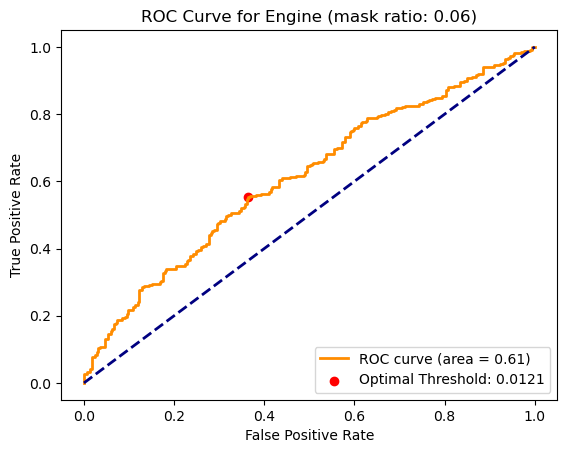

AUROC for Engine Wiring: 0.61
Precision: 0.63, Recall: 0.55, F1-Score: 0.59

Training Masked Autoencoder with mask ratio: 0.12
Epoch 1/10, Train Loss: 0.0707, Validation Loss: 0.0533
Epoch 2/10, Train Loss: 0.0327, Validation Loss: 0.0299
Epoch 3/10, Train Loss: 0.0253, Validation Loss: 0.0249
Epoch 4/10, Train Loss: 0.0216, Validation Loss: 0.0240
Epoch 5/10, Train Loss: 0.0190, Validation Loss: 0.0229
Epoch 6/10, Train Loss: 0.0170, Validation Loss: 0.0206
Epoch 7/10, Train Loss: 0.0151, Validation Loss: 0.0175
Epoch 8/10, Train Loss: 0.0134, Validation Loss: 0.0160
Epoch 9/10, Train Loss: 0.0118, Validation Loss: 0.0137
Epoch 10/10, Train Loss: 0.0108, Validation Loss: 0.0123
Optimal Threshold: 0.012298318557441235

Classification Report for Engine (mask ratio: 0.12):
              precision    recall  f1-score   support

      Normal       0.56      0.67      0.61       285
   Anomalous       0.64      0.52      0.58       322

    accuracy                           0.59       607


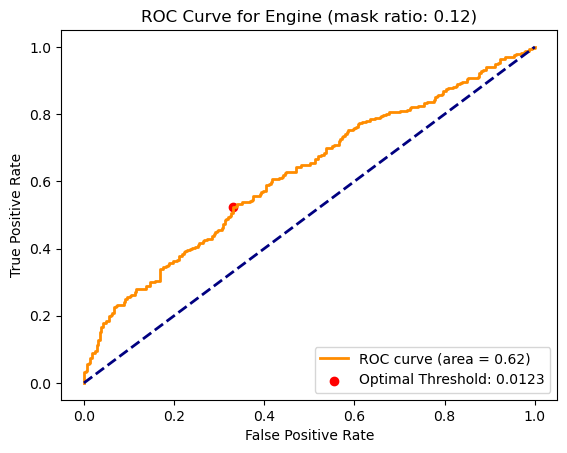

AUROC for Engine Wiring: 0.62
Precision: 0.64, Recall: 0.52, F1-Score: 0.58

Training Masked Autoencoder with mask ratio: 0.25
Epoch 1/10, Train Loss: 0.0924, Validation Loss: 0.0626
Epoch 2/10, Train Loss: 0.0394, Validation Loss: 0.0520
Epoch 3/10, Train Loss: 0.0286, Validation Loss: 0.0430
Epoch 4/10, Train Loss: 0.0237, Validation Loss: 0.0229
Epoch 5/10, Train Loss: 0.0207, Validation Loss: 0.0230
Epoch 6/10, Train Loss: 0.0185, Validation Loss: 0.0204
Epoch 7/10, Train Loss: 0.0166, Validation Loss: 0.0181
Epoch 8/10, Train Loss: 0.0148, Validation Loss: 0.0155
Epoch 9/10, Train Loss: 0.0130, Validation Loss: 0.0160
Epoch 10/10, Train Loss: 0.0116, Validation Loss: 0.0151
Optimal Threshold: 0.015389412641525269

Classification Report for Engine (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.52      0.68      0.59       285
   Anomalous       0.61      0.45      0.52       322

    accuracy                           0.56       607


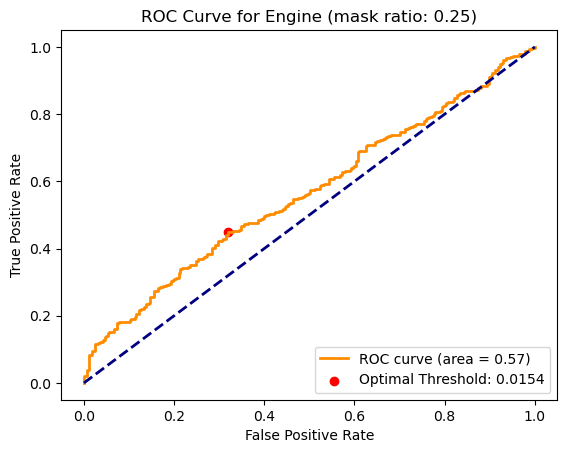

AUROC for Engine Wiring: 0.57
Precision: 0.61, Recall: 0.45, F1-Score: 0.52


In [61]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

# Liste des ratios de masque à tester
mask_ratios = [1/32, 1/16, 1/8, 1/4]

for mask_ratio in mask_ratios:
    print(f"\nTraining Masked Autoencoder with mask ratio: {mask_ratio:.2f}")
    
    # Initialisation du modèle
    masked_autoencoder_engine = MaskedAutoencoder(latent_dim=128, mask_ratio=mask_ratio)
    
    # Entraînement!
    masked_autoencoder_engine = train_mask_model(
        masked_autoencoder_engine,
        train_loader_engine,
        test_loader_engine,
        criterion=nn.MSELoss(),
        optimizer=optim.Adam(masked_autoencoder_engine.parameters(), lr=0.001),
        device=device,
        epochs=10
    )

    
    # Calcul des pertes et tracé de la courbe ROC
    losses_engine = calculate_losses(masked_autoencoder_engine, test_loader_engine, criterion, device)
    labels_engine = np.array(test_categories_W)
    auroc_masked_engine, precision_engine, recall_engine, f1_engine = plot_roc_curve_with_metrics(
        losses_engine, labels_engine, f"Engine (mask ratio: {mask_ratio:.2f})"
    )
    print(f"AUROC for Engine Wiring: {auroc_masked_engine:.2f}")
    print(f"Precision: {precision_engine:.2f}, Recall: {recall_engine:.2f}, F1-Score: {f1_engine:.2f}")


Epoch 1/10, Train Loss: 0.0742, Validation Loss: 0.0528
Epoch 2/10, Train Loss: 0.0323, Validation Loss: 0.0307
Epoch 3/10, Train Loss: 0.0251, Validation Loss: 0.0233
Epoch 4/10, Train Loss: 0.0216, Validation Loss: 0.0214
Epoch 5/10, Train Loss: 0.0189, Validation Loss: 0.0212
Epoch 6/10, Train Loss: 0.0166, Validation Loss: 0.0214
Epoch 7/10, Train Loss: 0.0144, Validation Loss: 0.0215
Epoch 8/10, Train Loss: 0.0125, Validation Loss: 0.0154
Epoch 9/10, Train Loss: 0.0113, Validation Loss: 0.0118
Epoch 10/10, Train Loss: 0.0104, Validation Loss: 0.0105
Optimal Threshold: 0.010432298295199871

Classification Report for Engine (mask ratio: 0.25):
              precision    recall  f1-score   support

      Normal       0.58      0.65      0.61       285
   Anomalous       0.65      0.57      0.61       322

    accuracy                           0.61       607
   macro avg       0.61      0.61      0.61       607
weighted avg       0.62      0.61      0.61       607

Precision: 0.65
Re

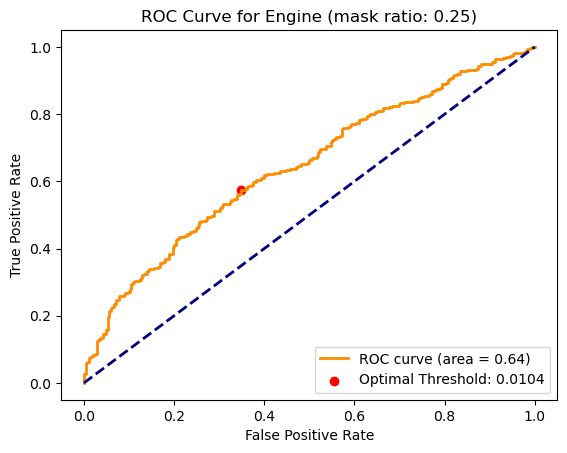

AUROC for Engine Wiring: 0.64
Precision: 0.65, Recall: 0.57, F1-Score: 0.61


In [70]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.MSELoss(reduction='none')

masked_autoencoder_engine = MaskedAutoencoder(mask_ratio= 1/32)# on prend le meilleur masque
    
# Entraînement
masked_autoencoder_engine = train_mask_model(
    masked_autoencoder_engine,
    train_loader_engine,
    test_loader_engine,
    criterion=nn.MSELoss(),
    optimizer=optim.Adam(masked_autoencoder_engine.parameters(), lr=0.001),
    device=device,
    epochs=10
)
losses_engine = calculate_losses(masked_autoencoder_engine, test_loader_engine, criterion, device)
labels_engine = np.array(test_categories_W)
auroc_masked_engine, precision_engine, recall_engine, f1_engine = plot_roc_curve_with_metrics(
    losses_engine, labels_engine, f"Engine (mask ratio: {mask_ratio:.2f})"
)
print(f"AUROC for Engine Wiring: {auroc_masked_engine:.2f}")
print(f"Precision: {precision_engine:.2f}, Recall: {recall_engine:.2f}, F1-Score: {f1_engine:.2f}")


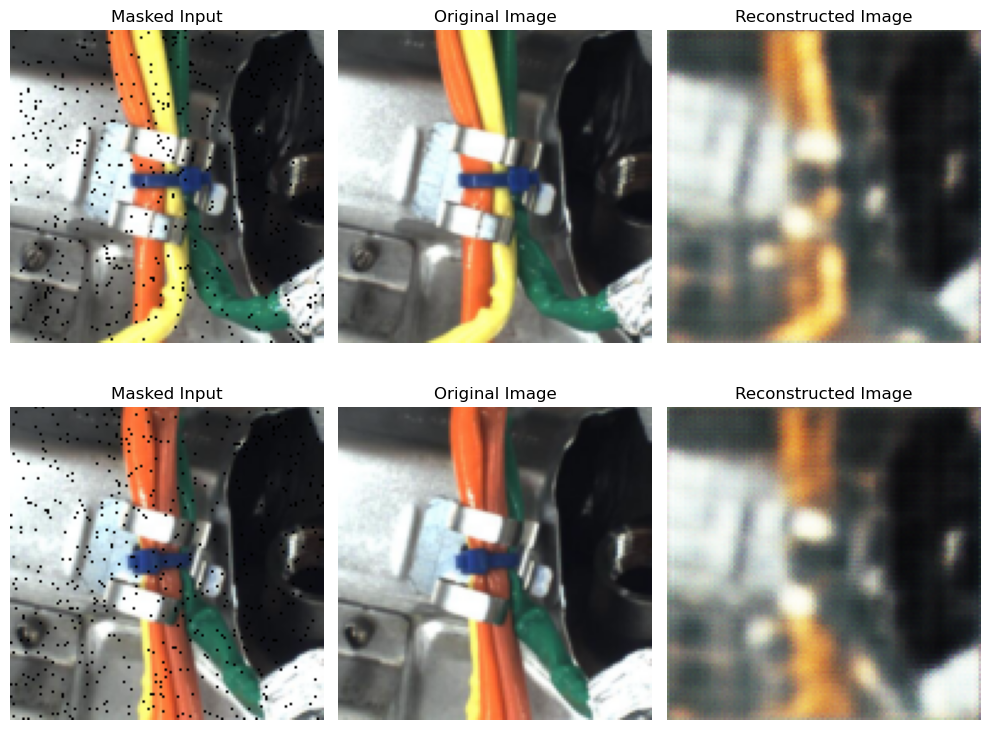

In [71]:
visualize_masked_reconstructions(masked_autoencoder_engine, test_loader_engine, device=device, num_images=2)

# Conclusion

## Comparaison des AUROC

In [84]:
import pandas as pd
import numpy as np
from IPython.display import display

# Stocker les AUROC calculés dans des listes (remplacez par vos vraies valeurs)
auroc_colorizing = [auroc_bottle, auroc_hazelnut, auroc_capsule, auroc_toothbrush, auroc_engine]
auroc_inpainting = [auroc_inpainting_bottle, auroc_inpainting_hazelnut, auroc_inpainting_capsule, auroc_inpainting_toothbrush, auroc_inpainting_engine]
auroc_masked_autoencoder = [auroc_masked_bottle, auroc_masked_hazelnut, auroc_masked_capsule, auroc_masked_toothbrush, auroc_masked_engine]  # Idem


# Catégories utilisées
categories = ["Bottle", "Hazelnut", "Capsule", "Toothbrush", "Engine"]

# Créer un DataFrame pour comparer les AUROC
auroc_data = {
    "Category": categories * 3,
    "Task": ["Colorizing"] * 5 + ["Inpainting"] * 5 + ["Masked Autoencoder"] * 5,
    "AUROC": auroc_colorizing + auroc_inpainting + auroc_masked_autoencoder
}

auroc_df = pd.DataFrame(auroc_data)

# Pivoter le tableau pour mettre les catégories en colonnes et les tâches en lignes
pivot_df = auroc_df.pivot_table(index="Task", columns="Category", values="AUROC")

# Mettre en forme pour surligner le max par colonne
def highlight_max_per_column(df):
    return df.style.apply(lambda x: ["background-color: lightgreen" if v == x.max() else "" for v in x], axis=0)

# Appliquer la mise en forme
styled_pivot_df = highlight_max_per_column(pivot_df)

# Afficher le tableau pivoté
display(styled_pivot_df)


Category,Bottle,Capsule,Engine,Hazelnut,Toothbrush
Task,,,,,
Colorizing,0.684127,0.425209,0.644731,0.727143,0.441667
Inpainting,0.784921,0.619465,0.588624,0.716429,0.491667
Masked Autoencoder,0.684127,0.425209,0.644731,0.727143,0.441667


Chaque modèle a été évalué sur les catégories bottle, hazelnut, capsule, toothbrush (MVTec_AD) et engine_wiring (Auto_VI), avec l’AUROC comme métrique principale. Les résultats montrent que certains modèles, comme l'inpainting affichent des performances robustes sur des catégories où les anomalies sont bien définies et structurées (par exemple, bottle). Cependant, des catégories plus complexes ou texturées, comme engine_wiring, révèlent des limites pour certains modèles (AUROC plus faibles). Les valeurs contenues dans ce tableau ne représentent pas les valeurs max qu'on parfois pu obtenir, notamment pour inpainting et masked autoencoder où lors de nos essais sur différents masks, on obtenait parfois des AUROC > 80 pour bottle notamment.

## Justification des choix

Dans ce projet, nous avons choisi différentes tailles de **dimensions latentes** pour chaque tâche SSL afin d’optimiser l’équilibre entre la complexité du modèle et la capacité de reconstruction. Ces choix sont motivés par les besoins spécifiques de chaque tâche :
- Colorizing Model (32 dimensions latentes) : la colorisation repose sur la conversion d'images en niveaux de gris vers des images en couleur. Cela nécessite de capturer des caractéristiques visuelles basiques. Une dimension latente modérée (32) est suffisante pour encoder efficacement ces informations sans introduire de surapprentissage.

- Inpainting Model (64 dimensions latentes) : l’inpainting demande une compréhension plus complexe des relations spatiales pour reconstruire les zones masquées. Une dimension latente plus élevée (64) permet au modèle d’apprendre des informations contextuelles riches nécessaires pour cette tâche.

- Masked Autoencoder (128 dimensions latentes) : le "masquage" exige que le modèle capture des détails à la fois locaux et globaux pour reconstruire efficacement l'image entière. Une dimension latente élevée (128) offre la capacité de modéliser cette complexité, tout en minimisant la perte d’information.

Ces choix ont été réalisés sur la base des besoins spécifiques de chaque tâche. Une analyse comparative des dimensions latentes pourrait être envisagée dans le futur pour affiner encore davantage ces paramètres.



Le choix de la **taille de batch_size** influence également l'entraînement et la performance du modèle. Pour un petit batch_size (ex. : 8 ou 16) : nous aurions des mises à jour des poids plus fréquentes, ce qui peut aider à échapper à des minima locaux, et les petits batch sont utiles si nous travaillions avec des modèles complexes ou une mémoire GPU limitée. En revanche les gradients calculés à chaque itération seraient plus bruités, ce qui peut rendre la convergence instable ou plus lente et le temps d'entraînement global serait plus long en raison d'un nombre accru d'itérations.

Pour un plus grand batch_size (ex. : 64 ou 128) : nos gradients calculés seraient plus stables grâce à une estimation plus précise de la perte globale et l'entraînement serait plus rapide. Cependant la mémoire nécessaire augmenterait et on a des risques de sur-apprentissage de motifs spécifiques aux batchs ce qui réduit la généralisation sur les données non vues..

Dans notre cas, un batch_size=32 représentait un compromis courant entre stabilité et efficacité mémoire. Cependant, explorer des tailles différentes aurait pu être intéressant pour :

- Comparer les courbes d’apprentissage en fonction de la taille des batchs.
- Vérifier l’impact sur le calcul des AUROC et la convergence des modèles.
- Adapter la taille des batchs pour des catégories spécifiques comme bottle ou hazelnut, en fonction de la variabilité des données.

Dans le futur, tester différentes tailles de batchs pourrait permettre d’optimiser les performances de chaque modèle, notamment en ajustant les hyperparamètres comme le taux d’apprentissage (learning_rate) en conséquence.